# Implementing a Neural Network
In this exercise we will develop a neural network with fully-connected layers to perform classification, and test it out on the CIFAR-10 dataset.

In [15]:
# A bit of setup

import numpy as np
import matplotlib.pyplot as plt

from cs231n.classifiers.neural_net import TwoLayerNet

%matplotlib inline
plt.rcParams['figure.figsize'] = (10.0, 8.0) # set default size of plots
plt.rcParams['image.interpolation'] = 'nearest'
plt.rcParams['image.cmap'] = 'gray'

# for auto-reloading external modules
# see http://stackoverflow.com/questions/1907993/autoreload-of-modules-in-ipython
%load_ext autoreload
%autoreload 2

def rel_error(x, y):
    """ returns relative error """
    return np.max(np.abs(x - y) / (np.maximum(1e-8, np.abs(x) + np.abs(y))))

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


We will use the class `TwoLayerNet` in the file `cs231n/classifiers/neural_net.py` to represent instances of our network. The network parameters are stored in the instance variable `self.params` where keys are string parameter names and values are numpy arrays. Below, we initialize toy data and a toy model that we will use to develop your implementation.

In [16]:
# Create a small net and some toy data to check your implementations.
# Note that we set the random seed for repeatable experiments.

input_size = 4
hidden_size = 10
num_classes = 3
num_inputs = 5

def init_toy_model():
    np.random.seed(0)
    return TwoLayerNet(input_size, hidden_size, num_classes, std=1e-1)

def init_toy_data():
    np.random.seed(1)
    X = 10 * np.random.randn(num_inputs, input_size)
    y = np.array([0, 1, 2, 2, 1])
    return X, y

net = init_toy_model()
X, y = init_toy_data()

# Forward pass: compute scores
Open the file `cs231n/classifiers/neural_net.py` and look at the method `TwoLayerNet.loss`. This function is very similar to the loss functions you have written for the SVM and Softmax exercises: It takes the data and weights and computes the class scores, the loss, and the gradients on the parameters. 

Implement the first part of the forward pass which uses the weights and biases to compute the scores for all inputs.

In [17]:
scores = net.loss(X)
print('Your scores:')
print(scores)
print()
print('correct scores:')
correct_scores = np.asarray([
  [-0.81233741, -1.27654624, -0.70335995],
  [-0.17129677, -1.18803311, -0.47310444],
  [-0.51590475, -1.01354314, -0.8504215 ],
  [-0.15419291, -0.48629638, -0.52901952],
  [-0.00618733, -0.12435261, -0.15226949]])
print(correct_scores)
print()

# The difference should be very small. We get < 1e-7
print('Difference between your scores and correct scores:')
print(np.sum(np.abs(scores - correct_scores)))

Your scores:
[[-0.81233741 -1.27654624 -0.70335995]
 [-0.17129677 -1.18803311 -0.47310444]
 [-0.51590475 -1.01354314 -0.8504215 ]
 [-0.15419291 -0.48629638 -0.52901952]
 [-0.00618733 -0.12435261 -0.15226949]]

correct scores:
[[-0.81233741 -1.27654624 -0.70335995]
 [-0.17129677 -1.18803311 -0.47310444]
 [-0.51590475 -1.01354314 -0.8504215 ]
 [-0.15419291 -0.48629638 -0.52901952]
 [-0.00618733 -0.12435261 -0.15226949]]

Difference between your scores and correct scores:
3.6802720496109664e-08


# Forward pass: compute loss
In the same function, implement the second part that computes the data and regularization loss.

In [18]:
loss, _ = net.loss(X, y, reg=0.05)
correct_loss = 1.30378789133

# should be very small, we get < 1e-12
print('Difference between your loss and correct loss:')
print(np.sum(np.abs(loss - correct_loss)))

Difference between your loss and correct loss:
1.7985612998927536e-13


# Backward pass
Implement the rest of the function. This will compute the gradient of the loss with respect to the variables `W1`, `b1`, `W2`, and `b2`. Now that you (hopefully!) have a correctly implemented forward pass, you can debug your backward pass using a numeric gradient check:

In [19]:
from cs231n.gradient_check import eval_numerical_gradient

# Use numeric gradient checking to check your implementation of the backward pass.
# If your implementation is correct, the difference between the numeric and
# analytic gradients should be less than 1e-8 for each of W1, W2, b1, and b2.

loss, grads = net.loss(X, y, reg=0.05)
print('X shape:', X.shape)
print('y shape:', y.shape)
print('grad b2 shape:', grads['b2'].shape)
print('net.params b2 shape:', net.params['b2'].shape)
print('grad W2 shape:', grads['W2'].shape)
print('net.params W2 shape:', net.params['W2'].shape)
print('grad b1 shape:', grads['b1'].shape)
print('grad W1 shape:', grads['W1'].shape)

# these should all be less than 1e-8 or so
for param_name in grads:
    f = lambda W: net.loss(X, y, reg=0.05)[0]
    param_grad_num = eval_numerical_gradient(f, net.params[param_name], verbose=False)
    print('%s max relative error: %e' % (param_name, rel_error(param_grad_num, grads[param_name])))

X shape: (5, 4)
y shape: (5,)
grad b2 shape: (3,)
net.params b2 shape: (3,)
grad W2 shape: (10, 3)
net.params W2 shape: (10, 3)
grad b1 shape: (10,)
grad W1 shape: (4, 10)
b2 max relative error: 4.447625e-11
W2 max relative error: 3.440708e-09
b1 max relative error: 2.738421e-09
W1 max relative error: 3.561318e-09


# Train the network
To train the network we will use stochastic gradient descent (SGD), similar to the SVM and Softmax classifiers. Look at the function `TwoLayerNet.train` and fill in the missing sections to implement the training procedure. This should be very similar to the training procedure you used for the SVM and Softmax classifiers. You will also have to implement `TwoLayerNet.predict`, as the training process periodically performs prediction to keep track of accuracy over time while the network trains.

Once you have implemented the method, run the code below to train a two-layer network on toy data. You should achieve a training loss less than 0.02.

Final training loss:  0.01714960793873215


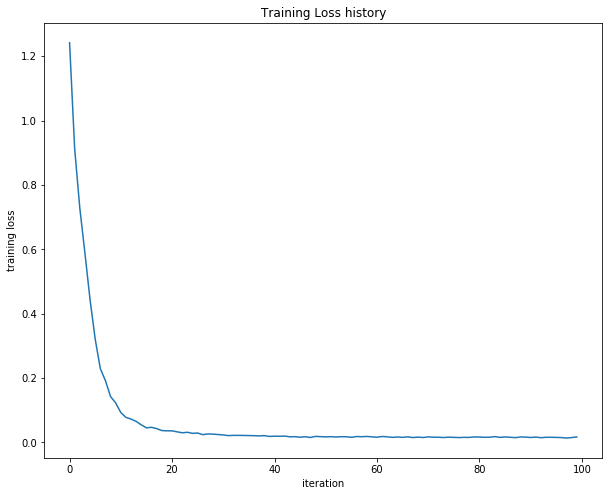

In [22]:
net = init_toy_model()
stats = net.train(X, y, X, y,
            learning_rate=1e-1, reg=5e-6,
            num_iters=100, verbose=False)

print('Final training loss: ', stats['loss_history'][-1])

# plot the loss history
plt.plot(stats['loss_history'])
plt.xlabel('iteration')
plt.ylabel('training loss')
plt.title('Training Loss history')
plt.show()

# Load the data
Now that you have implemented a two-layer network that passes gradient checks and works on toy data, it's time to load up our favorite CIFAR-10 data so we can use it to train a classifier on a real dataset.

In [23]:
from cs231n.data_utils import load_CIFAR10

def get_CIFAR10_data(num_training=49000, num_validation=1000, num_test=1000):
    """
    Load the CIFAR-10 dataset from disk and perform preprocessing to prepare
    it for the two-layer neural net classifier. These are the same steps as
    we used for the SVM, but condensed to a single function.  
    """
    # Load the raw CIFAR-10 data
    cifar10_dir = 'cs231n/datasets/cifar-10-batches-py'
    
    # Cleaning up variables to prevent loading data multiple times (which may cause memory issue)
    try:
       del X_train, y_train
       del X_test, y_test
       print('Clear previously loaded data.')
    except:
       pass

    X_train, y_train, X_test, y_test = load_CIFAR10(cifar10_dir)
        
    # Subsample the data
    mask = list(range(num_training, num_training + num_validation))
    X_val = X_train[mask]
    y_val = y_train[mask]
    mask = list(range(num_training))
    X_train = X_train[mask]
    y_train = y_train[mask]
    mask = list(range(num_test))
    X_test = X_test[mask]
    y_test = y_test[mask]

    # Normalize the data: subtract the mean image
    mean_image = np.mean(X_train, axis=0)
    X_train -= mean_image
    X_val -= mean_image
    X_test -= mean_image

    # Reshape data to rows
    X_train = X_train.reshape(num_training, -1)
    X_val = X_val.reshape(num_validation, -1)
    X_test = X_test.reshape(num_test, -1)

    return X_train, y_train, X_val, y_val, X_test, y_test


# Invoke the above function to get our data.
X_train, y_train, X_val, y_val, X_test, y_test = get_CIFAR10_data()
print('Train data shape: ', X_train.shape)
print('Train labels shape: ', y_train.shape)
print('Validation data shape: ', X_val.shape)
print('Validation labels shape: ', y_val.shape)
print('Test data shape: ', X_test.shape)
print('Test labels shape: ', y_test.shape)

Train data shape:  (49000, 3072)
Train labels shape:  (49000,)
Validation data shape:  (1000, 3072)
Validation labels shape:  (1000,)
Test data shape:  (1000, 3072)
Test labels shape:  (1000,)


# Train a network
To train our network we will use SGD. In addition, we will adjust the learning rate with an exponential learning rate schedule as optimization proceeds; after each epoch, we will reduce the learning rate by multiplying it by a decay rate.

In [24]:
input_size = 32 * 32 * 3
hidden_size = 50
num_classes = 10
net = TwoLayerNet(input_size, hidden_size, num_classes)

# Train the network
stats = net.train(X_train, y_train, X_val, y_val,
            num_iters=1000, batch_size=200,
            learning_rate=1e-4, learning_rate_decay=0.95,
            reg=0.25, verbose=True)

# Predict on the validation set
val_acc = (net.predict(X_val) == y_val).mean()
print('Validation accuracy: ', val_acc)


iteration 0 / 1000: loss 2.302954
iteration 100 / 1000: loss 2.302550
iteration 200 / 1000: loss 2.297648
iteration 300 / 1000: loss 2.259602
iteration 400 / 1000: loss 2.204170
iteration 500 / 1000: loss 2.118565
iteration 600 / 1000: loss 2.051535
iteration 700 / 1000: loss 1.988466
iteration 800 / 1000: loss 2.006591
iteration 900 / 1000: loss 1.951473
Validation accuracy:  0.287


# Debug the training
With the default parameters we provided above, you should get a validation accuracy of about 0.29 on the validation set. This isn't very good.

One strategy for getting insight into what's wrong is to plot the loss function and the accuracies on the training and validation sets during optimization.

Another strategy is to visualize the weights that were learned in the first layer of the network. In most neural networks trained on visual data, the first layer weights typically show some visible structure when visualized.

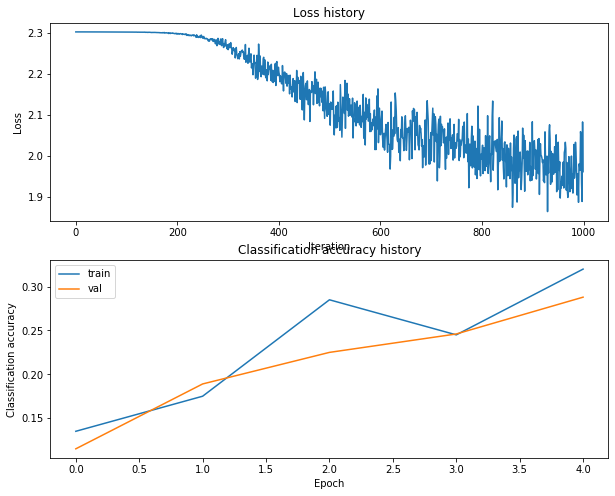

In [25]:
# Plot the loss function and train / validation accuracies
plt.subplot(2, 1, 1)
plt.plot(stats['loss_history'])
plt.title('Loss history')
plt.xlabel('Iteration')
plt.ylabel('Loss')

plt.subplot(2, 1, 2)
plt.plot(stats['train_acc_history'], label='train')
plt.plot(stats['val_acc_history'], label='val')
plt.title('Classification accuracy history')
plt.xlabel('Epoch')
plt.ylabel('Classification accuracy')
plt.legend()
plt.show()

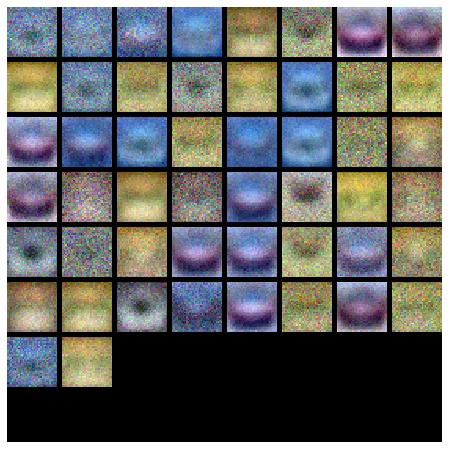

In [26]:
from cs231n.vis_utils import visualize_grid

# Visualize the weights of the network

def show_net_weights(net):
    W1 = net.params['W1']
    W1 = W1.reshape(32, 32, 3, -1).transpose(3, 0, 1, 2)
    plt.imshow(visualize_grid(W1, padding=3).astype('uint8'))
    plt.gca().axis('off')
    plt.show()

show_net_weights(net)

# Tune your hyperparameters

**What's wrong?**. Looking at the visualizations above, we see that the loss is decreasing more or less linearly, which seems to suggest that the learning rate may be too low. Moreover, there is no gap between the training and validation accuracy, suggesting that the model we used has low capacity, and that we should increase its size. On the other hand, with a very large model we would expect to see more overfitting, which would manifest itself as a very large gap between the training and validation accuracy.

**Tuning**. Tuning the hyperparameters and developing intuition for how they affect the final performance is a large part of using Neural Networks, so we want you to get a lot of practice. Below, you should experiment with different values of the various hyperparameters, including hidden layer size, learning rate, numer of training epochs, and regularization strength. You might also consider tuning the learning rate decay, but you should be able to get good performance using the default value.

**Approximate results**. You should be aim to achieve a classification accuracy of greater than 48% on the validation set. Our best network gets over 52% on the validation set.

**Experiment**: You goal in this exercise is to get as good of a result on CIFAR-10 as you can (52% could serve as a reference), with a fully-connected Neural Network. Feel free implement your own techniques (e.g. PCA to reduce dimensionality, or adding dropout, or adding features to the solver, etc.).

**Explain your hyperparameter tuning process below.**

$\color{blue}{\textit Your\ Answer:\ I\ am\ defining\ a\ number\ of\ trials\ for\ each\ parameter,\ lower\ end\ and\ high\ end,\ I\ am\ sampling\ the\ values\ from\ those\ ranges\ randomly\ at\ a\ logaritmic\ scale,\ I\ am\ defining\ a\ fitness\ function\ that\ determines\ the\ fitness\ value\ of\ the\ trial,\ which\ is\ the\ validation\ accuracy,\ I\ am\ doing\ random\ sampling\ because\ it\ is\ better\ than\ gridsearch,\ and\ I\ am\ a\ choosing\ the\ best\ fitness\ value}$










0it [00:00, ?it/s]

Processing new experiment:
---------------------------
hidden_size: 6, l_r: 0.000591880856090685, train_itrs: 1076, reg: 0.0013895394214980016, l_r_decay: 0.8807189706323384
---------------------------------------------------------------------------------------
iteration 0 / 1076: loss 2.302580
iteration 100 / 1076: loss 2.192079
iteration 200 / 1076: loss 2.100899
iteration 300 / 1076: loss 2.094313
iteration 400 / 1076: loss 2.017717
iteration 500 / 1076: loss 1.984905
iteration 600 / 1076: loss 1.877635
iteration 700 / 1076: loss 1.877497
iteration 800 / 1076: loss 1.924623
iteration 900 / 1076: loss 1.812630
iteration 1000 / 1076: loss 1.777319


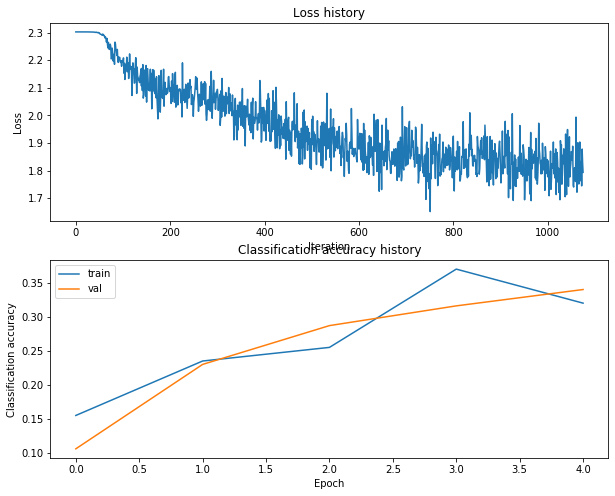

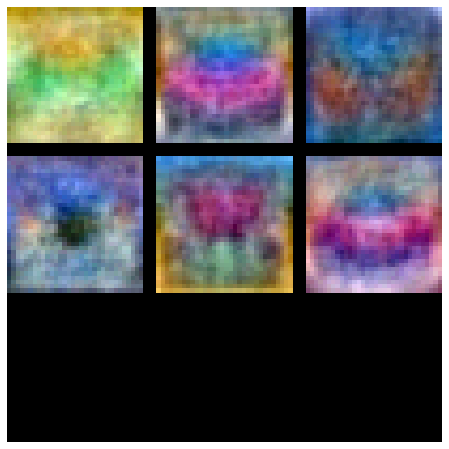










1it [00:04,  4.47s/it]

val accuracy: 0.342
Found better model with val acuracy: 0.342, with combination: (6, 0.000591880856090685, 1076, 0.0013895394214980016, 0.8807189706323384)
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 37, l_r: 4.9518447379047636e-05, train_itrs: 13983, reg: 0.0013428653060760865, l_r_decay: 0.9360039333723328
---------------------------------------------------------------------------------------
iteration 0 / 13983: loss 2.302554
iteration 100 / 13983: loss 2.302428
iteration 200 / 13983: loss 2.301999
iteration 300 / 13983: loss 2.300841
iteration 400 / 13983: loss 2.296286
iteration 500 / 13983: loss 2.288504
iteration 600 / 13983: loss 2.254078
iteration 700 / 13983: loss 2.255524
iteration 800 / 13983: loss 2.185511
iteration 900 / 13983: loss 2.168421
iteration 1000 / 13983: loss 2.116795
iteration 1100 / 13983: loss 2.117539
iteration 1200 / 13983: loss

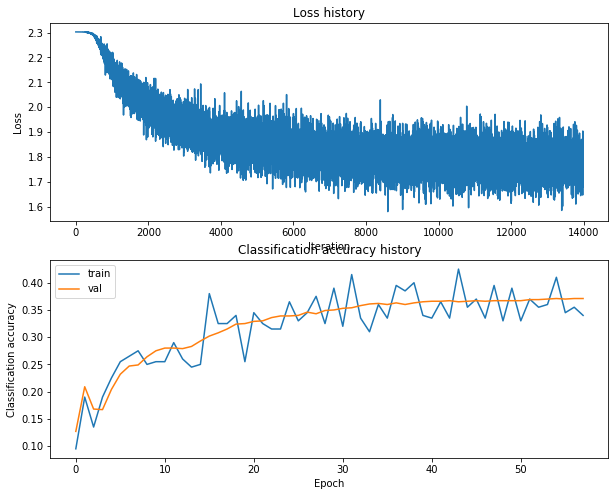

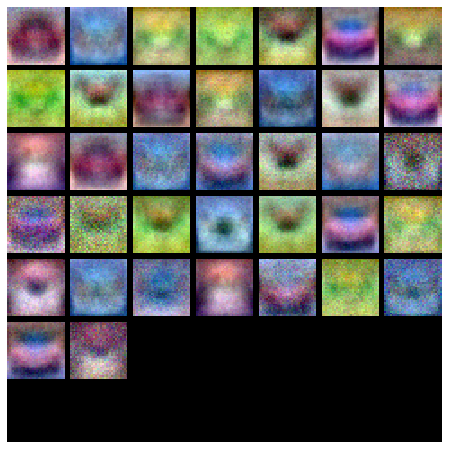










2it [01:20, 25.84s/it]

val accuracy: 0.371
Found better model with val acuracy: 0.371, with combination: (37, 4.9518447379047636e-05, 13983, 0.0013428653060760865, 0.9360039333723328)
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 45, l_r: 0.0005517072047003326, train_itrs: 1687, reg: 0.05261297283311073, l_r_decay: 0.9453790471549378
---------------------------------------------------------------------------------------
iteration 0 / 1687: loss 2.302635
iteration 100 / 1687: loss 2.109652
iteration 200 / 1687: loss 1.845385
iteration 300 / 1687: loss 1.789298
iteration 400 / 1687: loss 1.852098
iteration 500 / 1687: loss 1.703300
iteration 600 / 1687: loss 1.673861
iteration 700 / 1687: loss 1.547403
iteration 800 / 1687: loss 1.629511
iteration 900 / 1687: loss 1.647686
iteration 1000 / 1687: loss 1.499163
iteration 1100 / 1687: loss 1.423052
iteration 1200 / 1687: loss 1.557582
ite

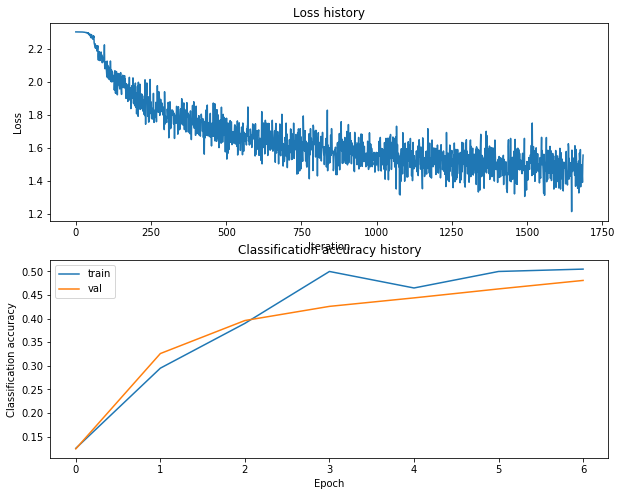

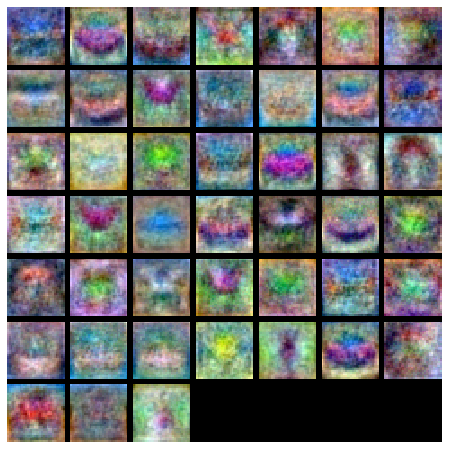










3it [01:31, 21.46s/it]

val accuracy: 0.478
Found better model with val acuracy: 0.478, with combination: (45, 0.0005517072047003326, 1687, 0.05261297283311073, 0.9453790471549378)
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 23, l_r: 0.00034517324413391545, train_itrs: 617, reg: 0.028416699814259004, l_r_decay: 0.9815038222491058
---------------------------------------------------------------------------------------
iteration 0 / 617: loss 2.302606
iteration 100 / 617: loss 2.256136
iteration 200 / 617: loss 2.040731
iteration 300 / 617: loss 1.925663
iteration 400 / 617: loss 1.832699
iteration 500 / 617: loss 1.716379
iteration 600 / 617: loss 1.944186


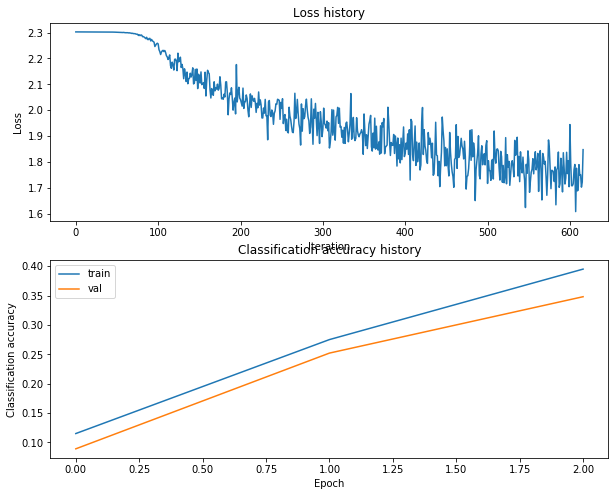

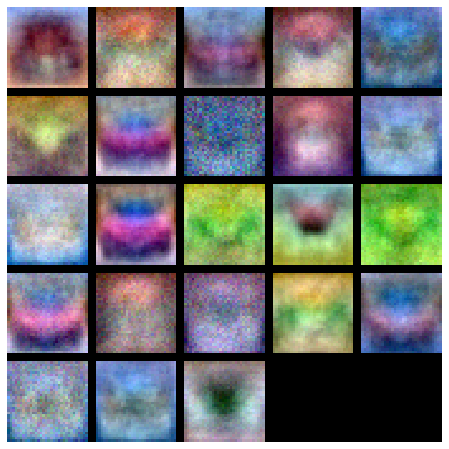










4it [01:34, 16.00s/it]

val accuracy: 0.377
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 5, l_r: 8.780258774327038e-05, train_itrs: 12887, reg: 0.008961588162648025, l_r_decay: 0.8218355917733414
---------------------------------------------------------------------------------------
iteration 0 / 12887: loss 2.302584
iteration 100 / 12887: loss 2.302540
iteration 200 / 12887: loss 2.302382
iteration 300 / 12887: loss 2.301084
iteration 400 / 12887: loss 2.297019
iteration 500 / 12887: loss 2.274045
iteration 600 / 12887: loss 2.253031
iteration 700 / 12887: loss 2.197201
iteration 800 / 12887: loss 2.155920
iteration 900 / 12887: loss 2.184054
iteration 1000 / 12887: loss 2.125034
iteration 1100 / 12887: loss 2.096896
iteration 1200 / 12887: loss 2.085535
iteration 1300 / 12887: loss 2.129628
iteration 1400 / 12887: loss 2.115376
iteration 1500 / 12887: loss 2.062094
iteration 1600 /

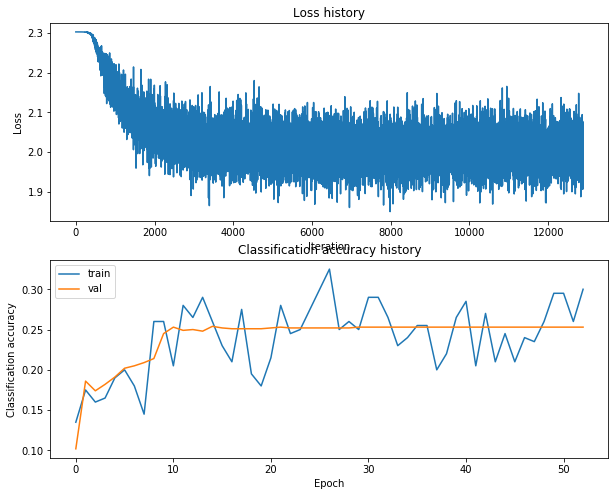

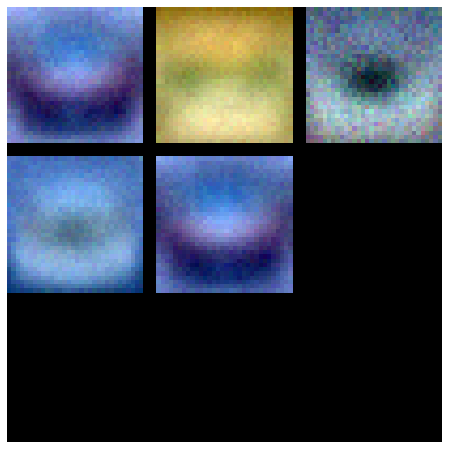










5it [02:22, 25.44s/it]

val accuracy: 0.253
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 60, l_r: 0.00023204174274203457, train_itrs: 34201, reg: 0.01933109540278982, l_r_decay: 0.8904199945543685
---------------------------------------------------------------------------------------
iteration 0 / 34201: loss 2.302620
iteration 100 / 34201: loss 2.296430
iteration 200 / 34201: loss 2.140163
iteration 300 / 34201: loss 2.031292
iteration 400 / 34201: loss 1.951183
iteration 500 / 34201: loss 1.958148
iteration 600 / 34201: loss 1.786037
iteration 700 / 34201: loss 1.787344
iteration 800 / 34201: loss 1.768612
iteration 900 / 34201: loss 1.782748
iteration 1000 / 34201: loss 1.684911
iteration 1100 / 34201: loss 1.800081
iteration 1200 / 34201: loss 1.747498
iteration 1300 / 34201: loss 1.787291
iteration 1400 / 34201: loss 1.693678
iteration 1500 / 34201: loss 1.603706
iteration 1600 

iteration 20300 / 34201: loss 1.646022
iteration 20400 / 34201: loss 1.457857
iteration 20500 / 34201: loss 1.452903
iteration 20600 / 34201: loss 1.541325
iteration 20700 / 34201: loss 1.610939
iteration 20800 / 34201: loss 1.428040
iteration 20900 / 34201: loss 1.539182
iteration 21000 / 34201: loss 1.535616
iteration 21100 / 34201: loss 1.520226
iteration 21200 / 34201: loss 1.537089
iteration 21300 / 34201: loss 1.549962
iteration 21400 / 34201: loss 1.469814
iteration 21500 / 34201: loss 1.468858
iteration 21600 / 34201: loss 1.361483
iteration 21700 / 34201: loss 1.449176
iteration 21800 / 34201: loss 1.487829
iteration 21900 / 34201: loss 1.453445
iteration 22000 / 34201: loss 1.499333
iteration 22100 / 34201: loss 1.446496
iteration 22200 / 34201: loss 1.546782
iteration 22300 / 34201: loss 1.586043
iteration 22400 / 34201: loss 1.571488
iteration 22500 / 34201: loss 1.572787
iteration 22600 / 34201: loss 1.550917
iteration 22700 / 34201: loss 1.506931
iteration 22800 / 34201: 

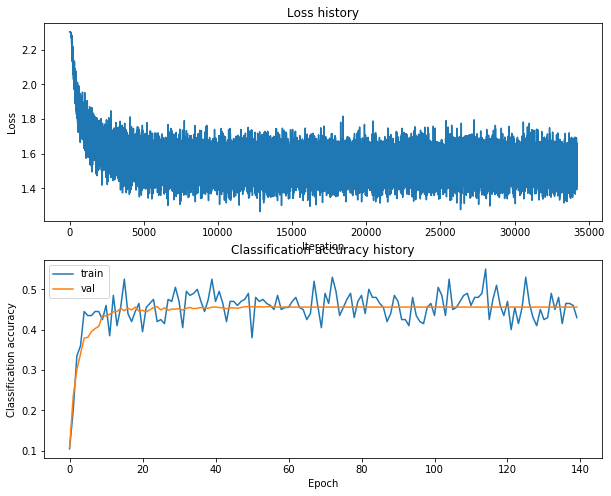

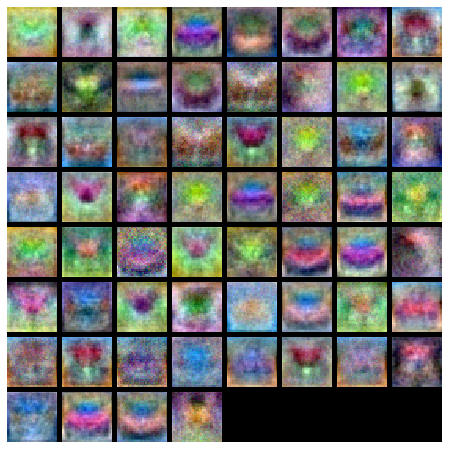










6it [06:22, 89.84s/it]

val accuracy: 0.456
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 6, l_r: 2.2996198688763052e-05, train_itrs: 1124, reg: 0.0016760166160690393, l_r_decay: 0.9501259063358218
---------------------------------------------------------------------------------------
iteration 0 / 1124: loss 2.302579
iteration 100 / 1124: loss 2.302573
iteration 200 / 1124: loss 2.302569
iteration 300 / 1124: loss 2.302559
iteration 400 / 1124: loss 2.302541
iteration 500 / 1124: loss 2.302521
iteration 600 / 1124: loss 2.302495
iteration 700 / 1124: loss 2.302418
iteration 800 / 1124: loss 2.302299
iteration 900 / 1124: loss 2.301922
iteration 1000 / 1124: loss 2.301709
iteration 1100 / 1124: loss 2.301360


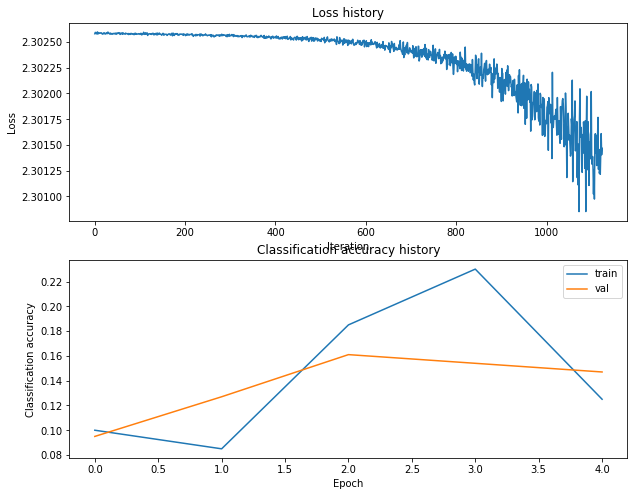

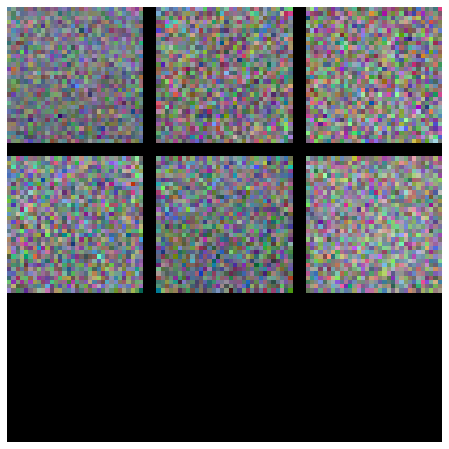










7it [06:26, 64.16s/it]

val accuracy: 0.148
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 39, l_r: 0.00011762399440230928, train_itrs: 21888, reg: 0.02357716513629689, l_r_decay: 0.9345338237138895
---------------------------------------------------------------------------------------
iteration 0 / 21888: loss 2.302603
iteration 100 / 21888: loss 2.302120
iteration 200 / 21888: loss 2.294673
iteration 300 / 21888: loss 2.240943
iteration 400 / 21888: loss 2.160801
iteration 500 / 21888: loss 2.092333
iteration 600 / 21888: loss 2.138974
iteration 700 / 21888: loss 2.018538
iteration 800 / 21888: loss 1.996057
iteration 900 / 21888: loss 1.947094
iteration 1000 / 21888: loss 1.948484
iteration 1100 / 21888: loss 1.976719
iteration 1200 / 21888: loss 1.913962
iteration 1300 / 21888: loss 1.960299
iteration 1400 / 21888: loss 1.853310
iteration 1500 / 21888: loss 1.762404
iteration 1600 

iteration 20300 / 21888: loss 1.684694
iteration 20400 / 21888: loss 1.584160
iteration 20500 / 21888: loss 1.625261
iteration 20600 / 21888: loss 1.636202
iteration 20700 / 21888: loss 1.487994
iteration 20800 / 21888: loss 1.602687
iteration 20900 / 21888: loss 1.526411
iteration 21000 / 21888: loss 1.559475
iteration 21100 / 21888: loss 1.646235
iteration 21200 / 21888: loss 1.552030
iteration 21300 / 21888: loss 1.627010
iteration 21400 / 21888: loss 1.603308
iteration 21500 / 21888: loss 1.650450
iteration 21600 / 21888: loss 1.567083
iteration 21700 / 21888: loss 1.538651
iteration 21800 / 21888: loss 1.627248


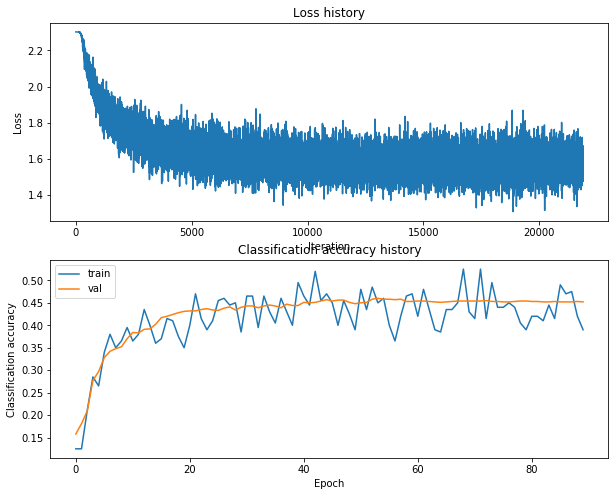

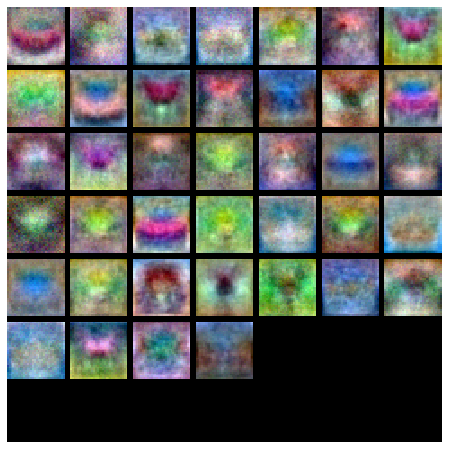










8it [08:33, 83.11s/it]

val accuracy: 0.452
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 58, l_r: 1.6097577194548693e-05, train_itrs: 4538, reg: 0.0013166766014488858, l_r_decay: 0.8620811181233322
---------------------------------------------------------------------------------------
iteration 0 / 4538: loss 2.302582
iteration 100 / 4538: loss 2.302578
iteration 200 / 4538: loss 2.302522
iteration 300 / 4538: loss 2.302459
iteration 400 / 4538: loss 2.302329
iteration 500 / 4538: loss 2.302287
iteration 600 / 4538: loss 2.302209
iteration 700 / 4538: loss 2.302109
iteration 800 / 4538: loss 2.301979
iteration 900 / 4538: loss 2.301891
iteration 1000 / 4538: loss 2.301592
iteration 1100 / 4538: loss 2.301391
iteration 1200 / 4538: loss 2.301107
iteration 1300 / 4538: loss 2.301060
iteration 1400 / 4538: loss 2.300842
iteration 1500 / 4538: loss 2.300545
iteration 1600 / 4538: loss 2.

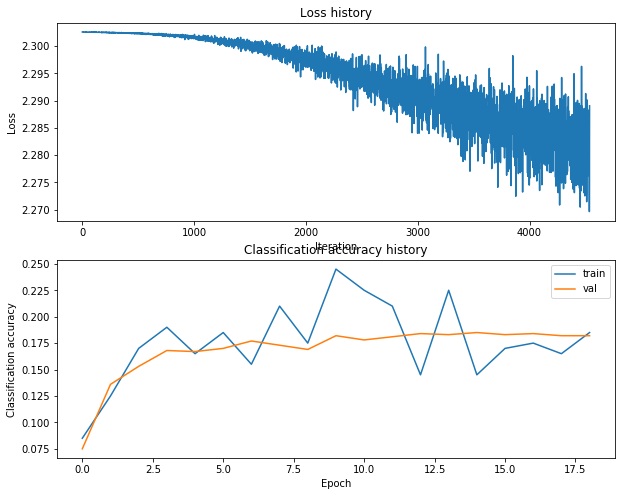

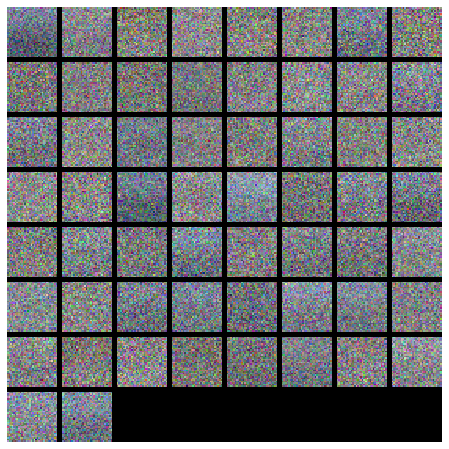










9it [09:05, 67.67s/it]

val accuracy: 0.183
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 16, l_r: 3.491576886591292e-05, train_itrs: 11565, reg: 0.03485078589977347, l_r_decay: 0.9573091356240493
---------------------------------------------------------------------------------------
iteration 0 / 11565: loss 2.302591
iteration 100 / 11565: loss 2.302543
iteration 200 / 11565: loss 2.302473
iteration 300 / 11565: loss 2.302359
iteration 400 / 11565: loss 2.301670
iteration 500 / 11565: loss 2.301338
iteration 600 / 11565: loss 2.298058
iteration 700 / 11565: loss 2.295006
iteration 800 / 11565: loss 2.288134
iteration 900 / 11565: loss 2.271491
iteration 1000 / 11565: loss 2.245465
iteration 1100 / 11565: loss 2.247613
iteration 1200 / 11565: loss 2.217644
iteration 1300 / 11565: loss 2.233492
iteration 1400 / 11565: loss 2.165277
iteration 1500 / 11565: loss 2.172127
iteration 1600 /

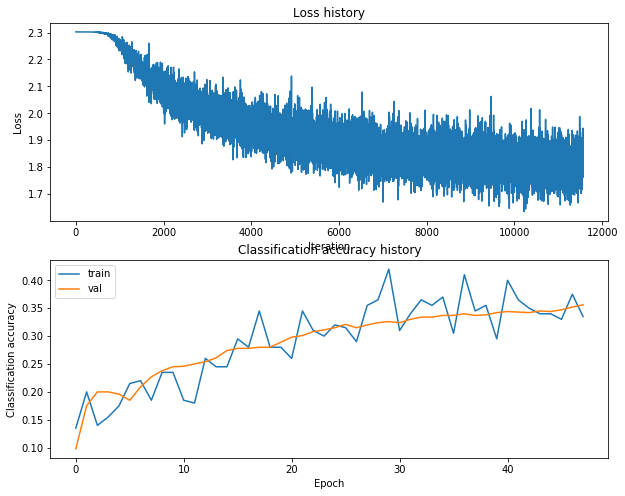

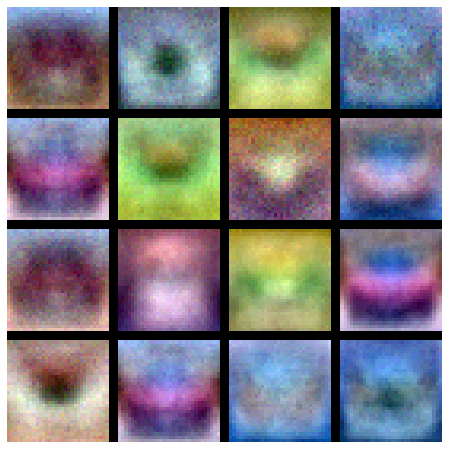










10it [09:49, 60.73s/it]

val accuracy: 0.355
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 32, l_r: 3.842009092532802e-05, train_itrs: 1221, reg: 0.034881722488894935, l_r_decay: 0.8620066784974793
---------------------------------------------------------------------------------------
iteration 0 / 1221: loss 2.302618
iteration 100 / 1221: loss 2.302573
iteration 200 / 1221: loss 2.302495
iteration 300 / 1221: loss 2.302287
iteration 400 / 1221: loss 2.301918
iteration 500 / 1221: loss 2.301651
iteration 600 / 1221: loss 2.300847
iteration 700 / 1221: loss 2.296945
iteration 800 / 1221: loss 2.296953
iteration 900 / 1221: loss 2.288173
iteration 1000 / 1221: loss 2.278450
iteration 1100 / 1221: loss 2.277557
iteration 1200 / 1221: loss 2.271880


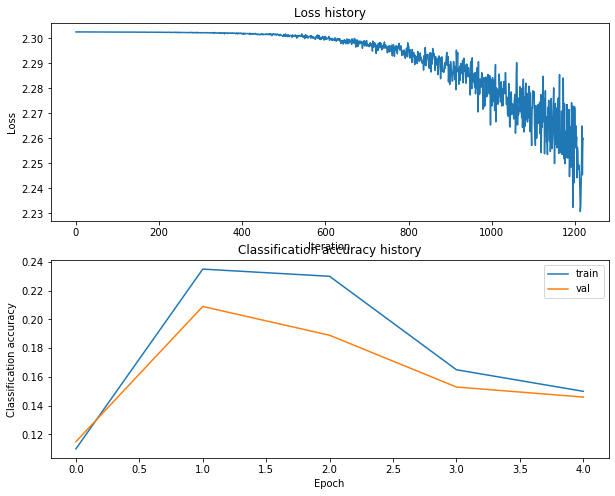

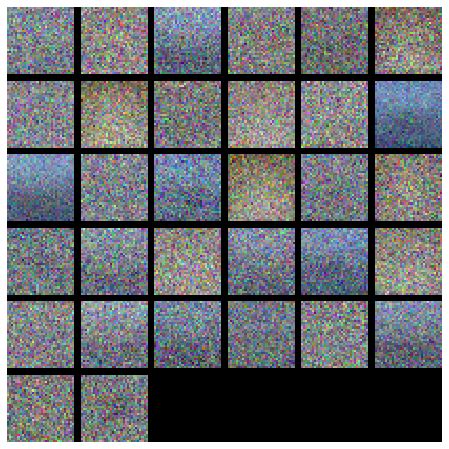










11it [09:56, 44.44s/it]

val accuracy: 0.163
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 67, l_r: 0.00013565460225029328, train_itrs: 1839, reg: 0.09403119332136034, l_r_decay: 0.9029173476365566
---------------------------------------------------------------------------------------
iteration 0 / 1839: loss 2.302769
iteration 100 / 1839: loss 2.301547
iteration 200 / 1839: loss 2.280135
iteration 300 / 1839: loss 2.173457
iteration 400 / 1839: loss 2.104135
iteration 500 / 1839: loss 2.090811
iteration 600 / 1839: loss 2.025129
iteration 700 / 1839: loss 1.982259
iteration 800 / 1839: loss 1.985608
iteration 900 / 1839: loss 1.810307
iteration 1000 / 1839: loss 2.022950
iteration 1100 / 1839: loss 1.860838
iteration 1200 / 1839: loss 1.863453
iteration 1300 / 1839: loss 1.859496
iteration 1400 / 1839: loss 1.819112
iteration 1500 / 1839: loss 1.715963
iteration 1600 / 1839: loss 1.78

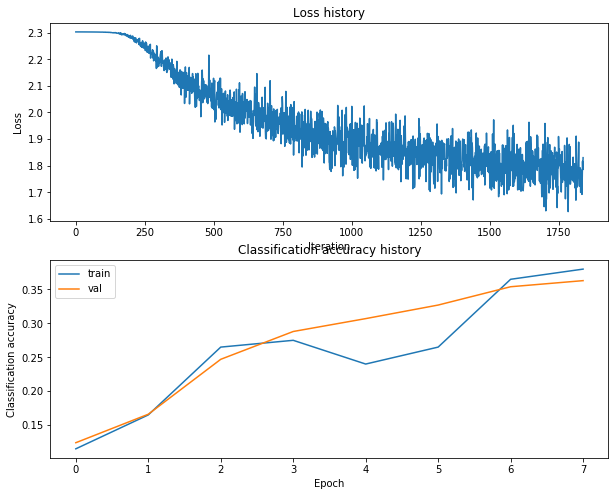

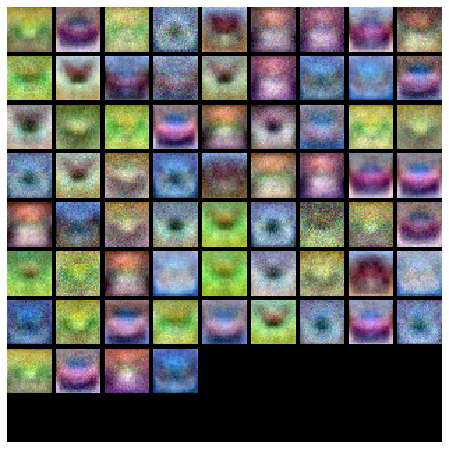










12it [10:10, 35.42s/it]

val accuracy: 0.362
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 10, l_r: 3.3411074727999324e-05, train_itrs: 1648, reg: 0.004742044094143894, l_r_decay: 0.8647098092942085
---------------------------------------------------------------------------------------
iteration 0 / 1648: loss 2.302584
iteration 100 / 1648: loss 2.302574
iteration 200 / 1648: loss 2.302556
iteration 300 / 1648: loss 2.302531
iteration 400 / 1648: loss 2.302502
iteration 500 / 1648: loss 2.302458
iteration 600 / 1648: loss 2.302376
iteration 700 / 1648: loss 2.302321
iteration 800 / 1648: loss 2.302146
iteration 900 / 1648: loss 2.301588
iteration 1000 / 1648: loss 2.301071
iteration 1100 / 1648: loss 2.299967
iteration 1200 / 1648: loss 2.299029
iteration 1300 / 1648: loss 2.296275
iteration 1400 / 1648: loss 2.296190
iteration 1500 / 1648: loss 2.291759
iteration 1600 / 1648: loss 2.2

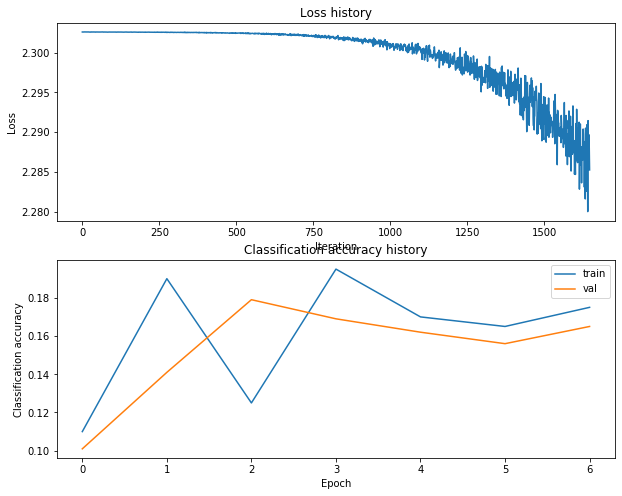

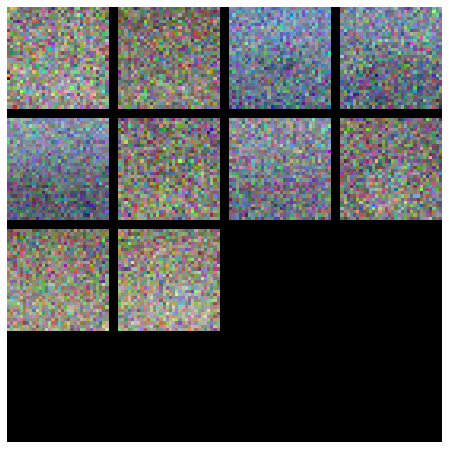










13it [10:16, 26.65s/it]

val accuracy: 0.16
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 7, l_r: 4.689566568824772e-05, train_itrs: 510, reg: 0.012413863806348643, l_r_decay: 0.819256511864575
---------------------------------------------------------------------------------------
iteration 0 / 510: loss 2.302586
iteration 100 / 510: loss 2.302576
iteration 200 / 510: loss 2.302558
iteration 300 / 510: loss 2.302534
iteration 400 / 510: loss 2.302496
iteration 500 / 510: loss 2.302395


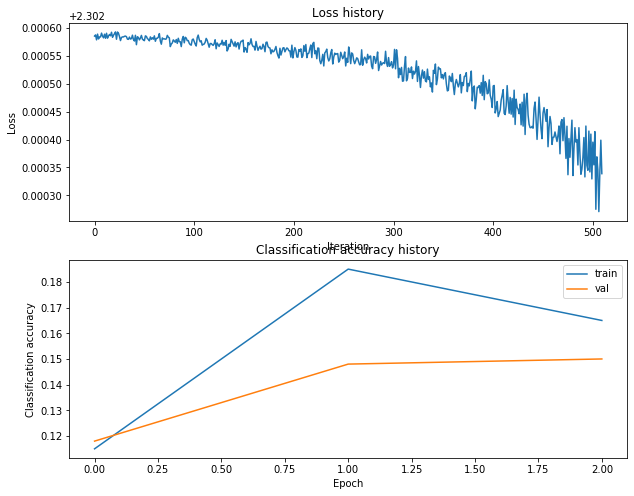

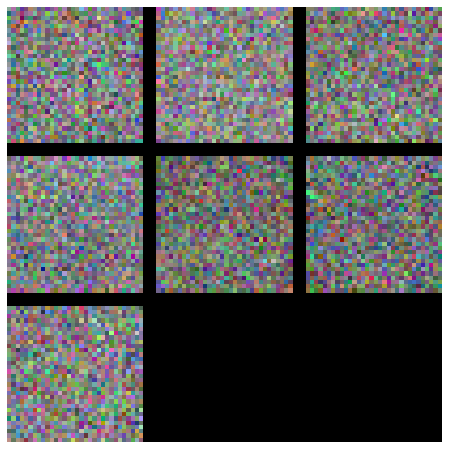










14it [10:19, 19.31s/it]

val accuracy: 0.15
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 7, l_r: 7.010884702397325e-05, train_itrs: 3627, reg: 0.0017726797724798983, l_r_decay: 0.9323680207711155
---------------------------------------------------------------------------------------
iteration 0 / 3627: loss 2.302588
iteration 100 / 3627: loss 2.302542
iteration 200 / 3627: loss 2.302364
iteration 300 / 3627: loss 2.300732
iteration 400 / 3627: loss 2.294250
iteration 500 / 3627: loss 2.280802
iteration 600 / 3627: loss 2.219085
iteration 700 / 3627: loss 2.207996
iteration 800 / 3627: loss 2.233481
iteration 900 / 3627: loss 2.143261
iteration 1000 / 3627: loss 2.206742
iteration 1100 / 3627: loss 2.074783
iteration 1200 / 3627: loss 2.153115
iteration 1300 / 3627: loss 1.944019
iteration 1400 / 3627: loss 2.055432
iteration 1500 / 3627: loss 2.086052
iteration 1600 / 3627: loss 2.024

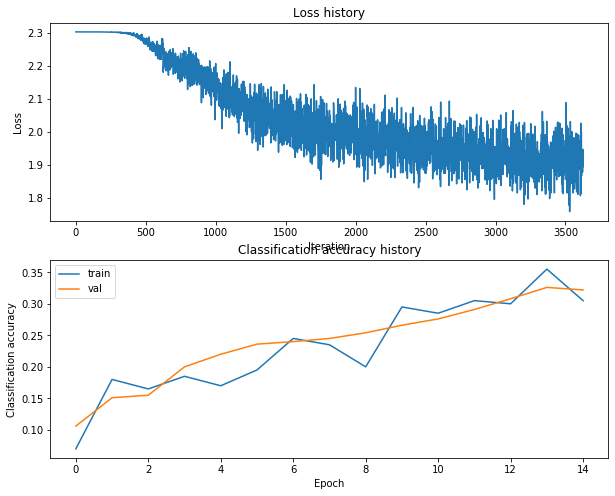

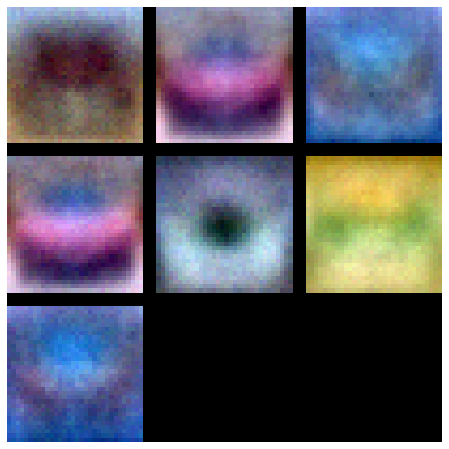










15it [10:32, 17.43s/it]

val accuracy: 0.327
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 55, l_r: 3.318338967321904e-05, train_itrs: 3402, reg: 0.0033946101610929, l_r_decay: 0.8360601574357734
---------------------------------------------------------------------------------------
iteration 0 / 3402: loss 2.302615
iteration 100 / 3402: loss 2.302538
iteration 200 / 3402: loss 2.302437
iteration 300 / 3402: loss 2.302295
iteration 400 / 3402: loss 2.302115
iteration 500 / 3402: loss 2.301734
iteration 600 / 3402: loss 2.301343
iteration 700 / 3402: loss 2.300197
iteration 800 / 3402: loss 2.299695
iteration 900 / 3402: loss 2.298411
iteration 1000 / 3402: loss 2.295876
iteration 1100 / 3402: loss 2.293045
iteration 1200 / 3402: loss 2.288574
iteration 1300 / 3402: loss 2.285050
iteration 1400 / 3402: loss 2.277089
iteration 1500 / 3402: loss 2.273428
iteration 1600 / 3402: loss 2.2617

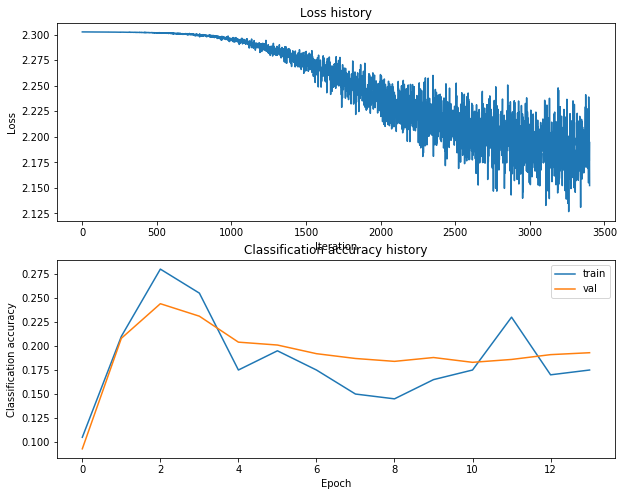

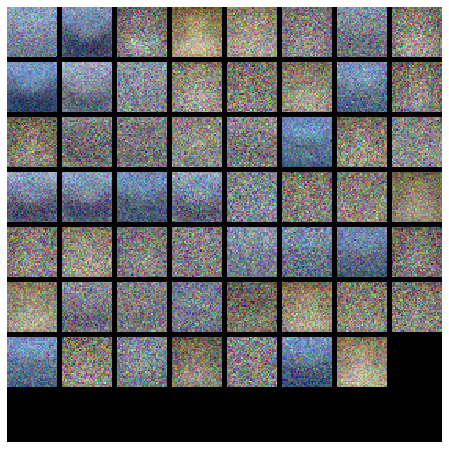










16it [10:55, 19.22s/it]

val accuracy: 0.195
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 24, l_r: 2.3283333457751114e-05, train_itrs: 1635, reg: 0.008111990949794638, l_r_decay: 0.8707807231461255
---------------------------------------------------------------------------------------
iteration 0 / 1635: loss 2.302583
iteration 100 / 1635: loss 2.302572
iteration 200 / 1635: loss 2.302519
iteration 300 / 1635: loss 2.302463
iteration 400 / 1635: loss 2.302440
iteration 500 / 1635: loss 2.302247
iteration 600 / 1635: loss 2.302181
iteration 700 / 1635: loss 2.301810
iteration 800 / 1635: loss 2.301751
iteration 900 / 1635: loss 2.301001
iteration 1000 / 1635: loss 2.300774
iteration 1100 / 1635: loss 2.300163
iteration 1200 / 1635: loss 2.299819
iteration 1300 / 1635: loss 2.299193
iteration 1400 / 1635: loss 2.296498
iteration 1500 / 1635: loss 2.292881
iteration 1600 / 1635: loss 2.2

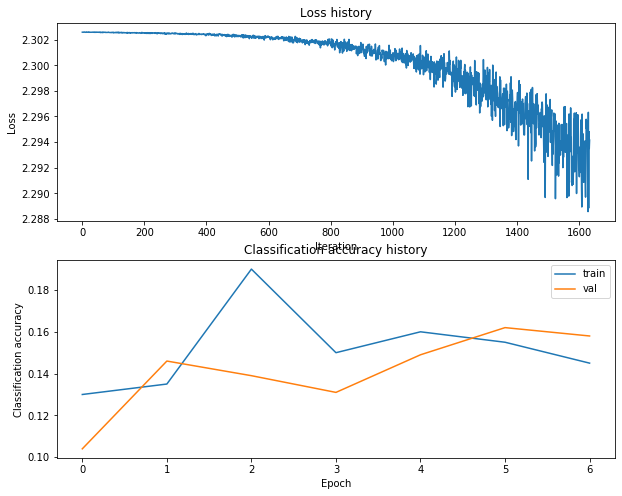

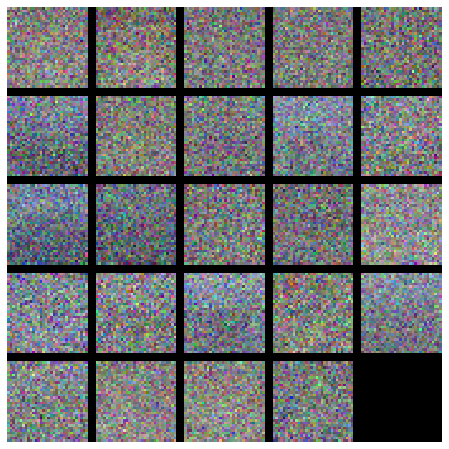










17it [11:03, 15.73s/it]

val accuracy: 0.154
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 27, l_r: 0.0005421229212432114, train_itrs: 19528, reg: 0.09793495271136145, l_r_decay: 0.8608537558766927
---------------------------------------------------------------------------------------
iteration 0 / 19528: loss 2.302664
iteration 100 / 19528: loss 2.175456
iteration 200 / 19528: loss 2.022334
iteration 300 / 19528: loss 1.933012
iteration 400 / 19528: loss 1.763037
iteration 500 / 19528: loss 1.805006
iteration 600 / 19528: loss 1.741881
iteration 700 / 19528: loss 1.625118
iteration 800 / 19528: loss 1.660522
iteration 900 / 19528: loss 1.632176
iteration 1000 / 19528: loss 1.620521
iteration 1100 / 19528: loss 1.637092
iteration 1200 / 19528: loss 1.546512
iteration 1300 / 19528: loss 1.469092
iteration 1400 / 19528: loss 1.531361
iteration 1500 / 19528: loss 1.564848
iteration 1600 /

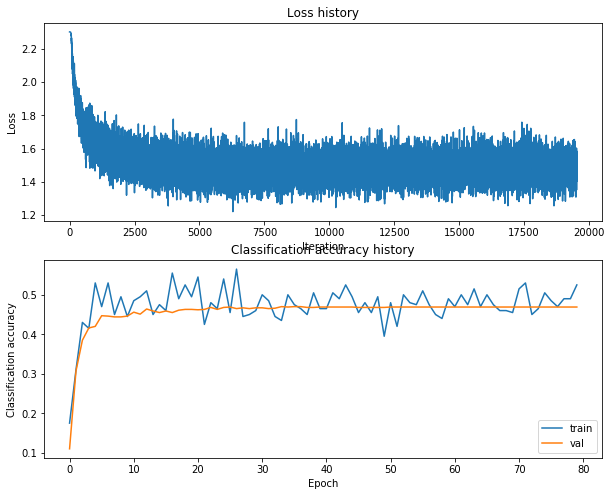

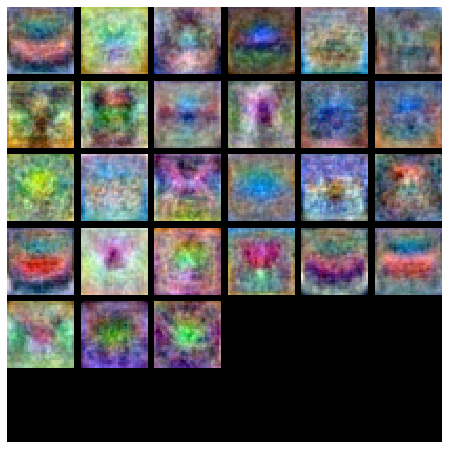










18it [12:43, 40.97s/it]

val accuracy: 0.469
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 5, l_r: 2.4392161330603983e-05, train_itrs: 3021, reg: 0.003244096972955226, l_r_decay: 0.887158903367537
---------------------------------------------------------------------------------------
iteration 0 / 3021: loss 2.302585
iteration 100 / 3021: loss 2.302575
iteration 200 / 3021: loss 2.302563
iteration 300 / 3021: loss 2.302557
iteration 400 / 3021: loss 2.302511
iteration 500 / 3021: loss 2.302464
iteration 600 / 3021: loss 2.302437
iteration 700 / 3021: loss 2.302307
iteration 800 / 3021: loss 2.302265
iteration 900 / 3021: loss 2.302089
iteration 1000 / 3021: loss 2.301984
iteration 1100 / 3021: loss 2.301828
iteration 1200 / 3021: loss 2.300967
iteration 1300 / 3021: loss 2.300078
iteration 1400 / 3021: loss 2.299073
iteration 1500 / 3021: loss 2.297956
iteration 1600 / 3021: loss 2.297

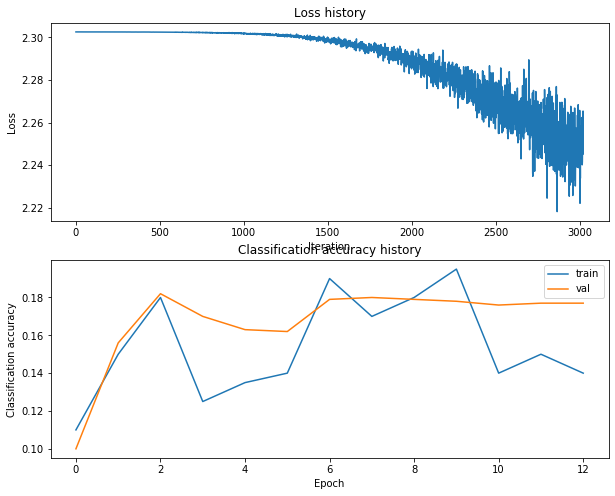

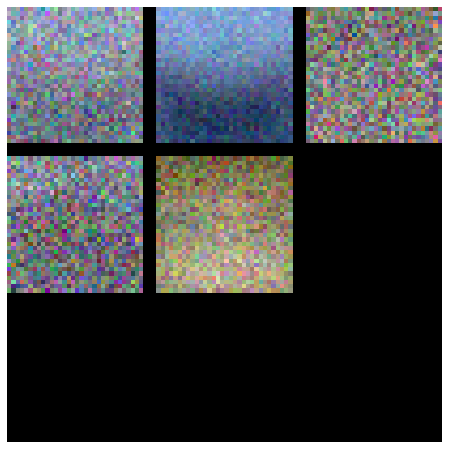










19it [12:53, 31.81s/it]

val accuracy: 0.177
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 21, l_r: 4.1210245668934116e-05, train_itrs: 5989, reg: 0.021162901344535738, l_r_decay: 0.8831476885424338
---------------------------------------------------------------------------------------
iteration 0 / 5989: loss 2.302593
iteration 100 / 5989: loss 2.302562
iteration 200 / 5989: loss 2.302490
iteration 300 / 5989: loss 2.302354
iteration 400 / 5989: loss 2.302144
iteration 500 / 5989: loss 2.301584
iteration 600 / 5989: loss 2.300188
iteration 700 / 5989: loss 2.298007
iteration 800 / 5989: loss 2.296279
iteration 900 / 5989: loss 2.287351
iteration 1000 / 5989: loss 2.273476
iteration 1100 / 5989: loss 2.252876
iteration 1200 / 5989: loss 2.258059
iteration 1300 / 5989: loss 2.216282
iteration 1400 / 5989: loss 2.253846
iteration 1500 / 5989: loss 2.191359
iteration 1600 / 5989: loss 2.1

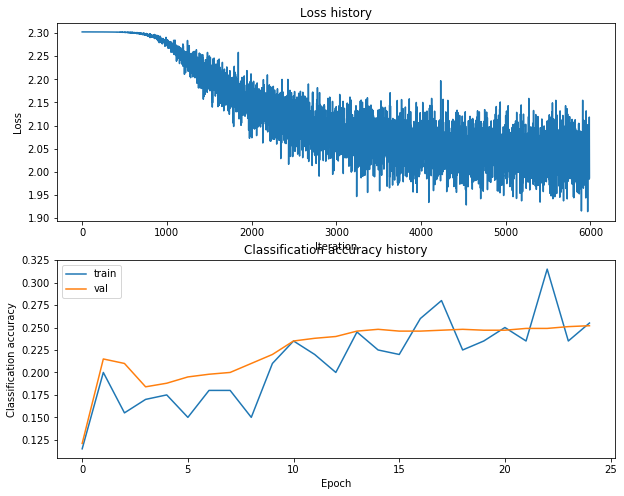

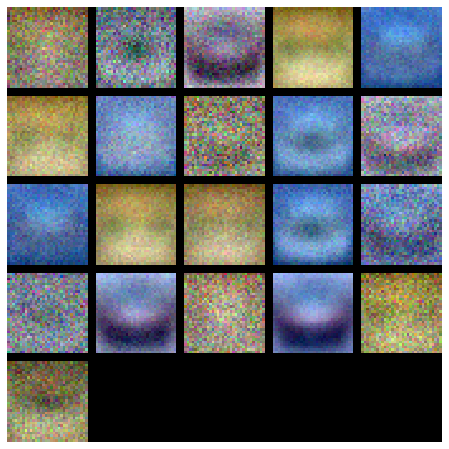










20it [13:20, 30.24s/it]

val accuracy: 0.252
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 13, l_r: 5.925900054764522e-05, train_itrs: 1467, reg: 0.058195293687013434, l_r_decay: 0.866807467064433
---------------------------------------------------------------------------------------
iteration 0 / 1467: loss 2.302608
iteration 100 / 1467: loss 2.302569
iteration 200 / 1467: loss 2.302460
iteration 300 / 1467: loss 2.302264
iteration 400 / 1467: loss 2.301329
iteration 500 / 1467: loss 2.298225
iteration 600 / 1467: loss 2.291836
iteration 700 / 1467: loss 2.280710
iteration 800 / 1467: loss 2.254843
iteration 900 / 1467: loss 2.246611
iteration 1000 / 1467: loss 2.200247
iteration 1100 / 1467: loss 2.212017
iteration 1200 / 1467: loss 2.190210
iteration 1300 / 1467: loss 2.108636
iteration 1400 / 1467: loss 2.130934


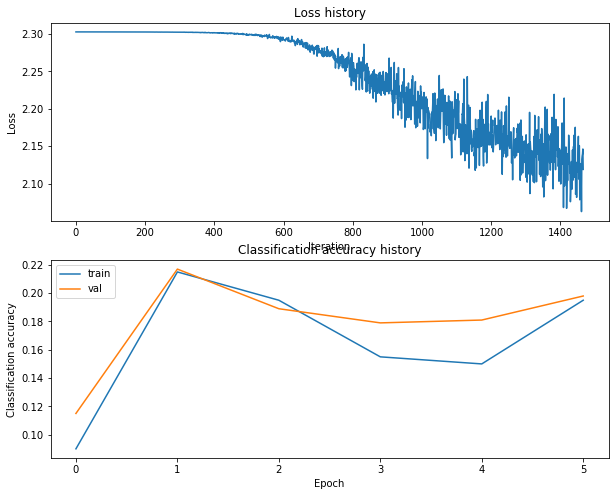

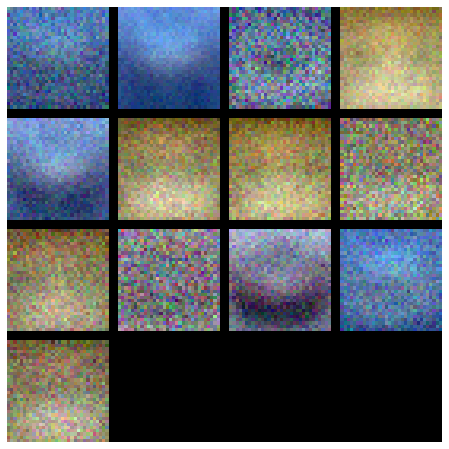










21it [13:25, 22.88s/it]

val accuracy: 0.208
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 10, l_r: 5.810197574091799e-05, train_itrs: 2517, reg: 0.008934906068455237, l_r_decay: 0.8963128194945736
---------------------------------------------------------------------------------------
iteration 0 / 2517: loss 2.302589
iteration 100 / 2517: loss 2.302564
iteration 200 / 2517: loss 2.302533
iteration 300 / 2517: loss 2.302408
iteration 400 / 2517: loss 2.301994
iteration 500 / 2517: loss 2.300864
iteration 600 / 2517: loss 2.296810
iteration 700 / 2517: loss 2.288455
iteration 800 / 2517: loss 2.262528
iteration 900 / 2517: loss 2.245360
iteration 1000 / 2517: loss 2.200173
iteration 1100 / 2517: loss 2.140767
iteration 1200 / 2517: loss 2.132011
iteration 1300 / 2517: loss 2.184007
iteration 1400 / 2517: loss 2.107818
iteration 1500 / 2517: loss 2.179470
iteration 1600 / 2517: loss 2.08

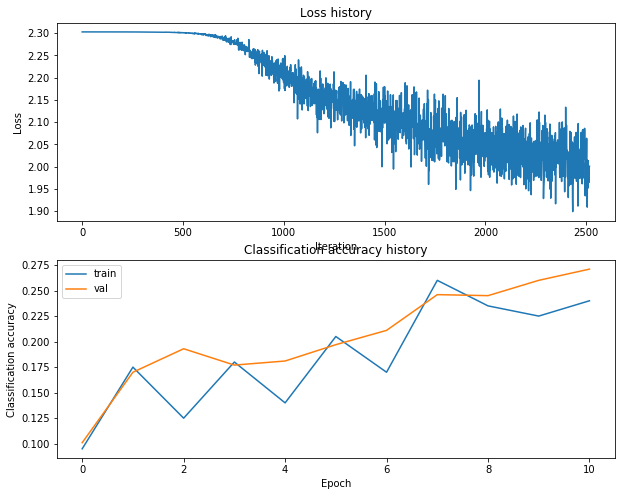

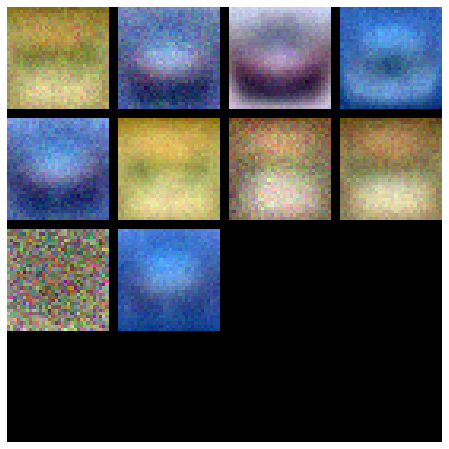










22it [13:35, 18.79s/it]

val accuracy: 0.267
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 45, l_r: 8.460436153257444e-05, train_itrs: 1931, reg: 0.007263689116206669, l_r_decay: 0.8590521460655134
---------------------------------------------------------------------------------------
iteration 0 / 1931: loss 2.302578
iteration 100 / 1931: loss 2.302209
iteration 200 / 1931: loss 2.300288
iteration 300 / 1931: loss 2.286014
iteration 400 / 1931: loss 2.263733
iteration 500 / 1931: loss 2.224022
iteration 600 / 1931: loss 2.164493
iteration 700 / 1931: loss 2.146583
iteration 800 / 1931: loss 2.077851
iteration 900 / 1931: loss 2.090198
iteration 1000 / 1931: loss 2.015571
iteration 1100 / 1931: loss 2.148919
iteration 1200 / 1931: loss 2.045788
iteration 1300 / 1931: loss 1.923945
iteration 1400 / 1931: loss 2.083747
iteration 1500 / 1931: loss 1.988315
iteration 1600 / 1931: loss 1.98

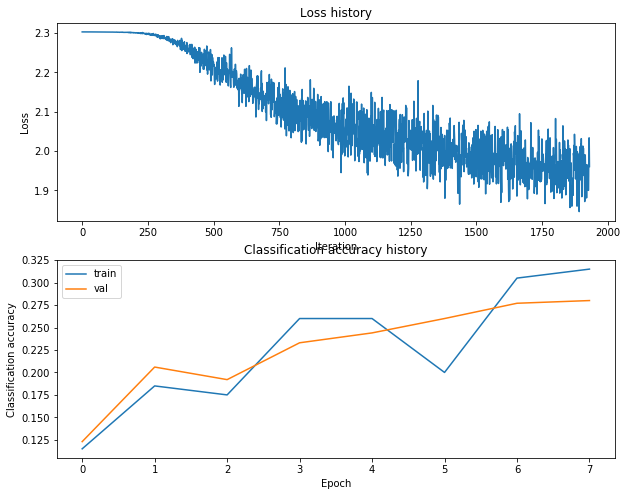

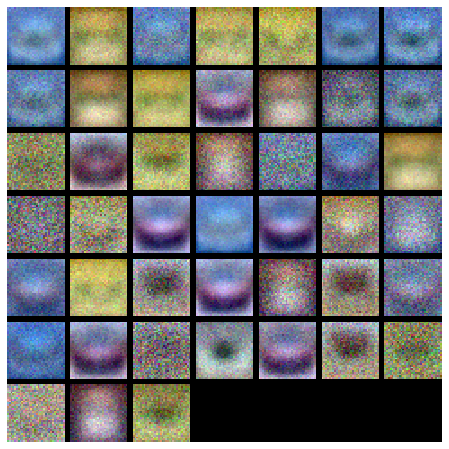










23it [13:46, 16.68s/it]

val accuracy: 0.285
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 15, l_r: 4.529056511150903e-05, train_itrs: 31206, reg: 0.0022701261964193616, l_r_decay: 0.9853371725854029
---------------------------------------------------------------------------------------
iteration 0 / 31206: loss 2.302586
iteration 100 / 31206: loss 2.302566
iteration 200 / 31206: loss 2.302496
iteration 300 / 31206: loss 2.302305
iteration 400 / 31206: loss 2.301657
iteration 500 / 31206: loss 2.300163
iteration 600 / 31206: loss 2.295080
iteration 700 / 31206: loss 2.287264
iteration 800 / 31206: loss 2.250338
iteration 900 / 31206: loss 2.214734
iteration 1000 / 31206: loss 2.222960
iteration 1100 / 31206: loss 2.153643
iteration 1200 / 31206: loss 2.120827
iteration 1300 / 31206: loss 2.100623
iteration 1400 / 31206: loss 2.105641
iteration 1500 / 31206: loss 2.056197
iteration 1600

iteration 20300 / 31206: loss 1.575632
iteration 20400 / 31206: loss 1.627705
iteration 20500 / 31206: loss 1.550489
iteration 20600 / 31206: loss 1.561373
iteration 20700 / 31206: loss 1.529452
iteration 20800 / 31206: loss 1.687130
iteration 20900 / 31206: loss 1.510030
iteration 21000 / 31206: loss 1.607264
iteration 21100 / 31206: loss 1.589500
iteration 21200 / 31206: loss 1.561831
iteration 21300 / 31206: loss 1.559961
iteration 21400 / 31206: loss 1.482870
iteration 21500 / 31206: loss 1.564013
iteration 21600 / 31206: loss 1.580196
iteration 21700 / 31206: loss 1.496636
iteration 21800 / 31206: loss 1.571847
iteration 21900 / 31206: loss 1.681465
iteration 22000 / 31206: loss 1.608350
iteration 22100 / 31206: loss 1.696043
iteration 22200 / 31206: loss 1.586505
iteration 22300 / 31206: loss 1.489990
iteration 22400 / 31206: loss 1.620998
iteration 22500 / 31206: loss 1.558655
iteration 22600 / 31206: loss 1.607436
iteration 22700 / 31206: loss 1.551125
iteration 22800 / 31206: 

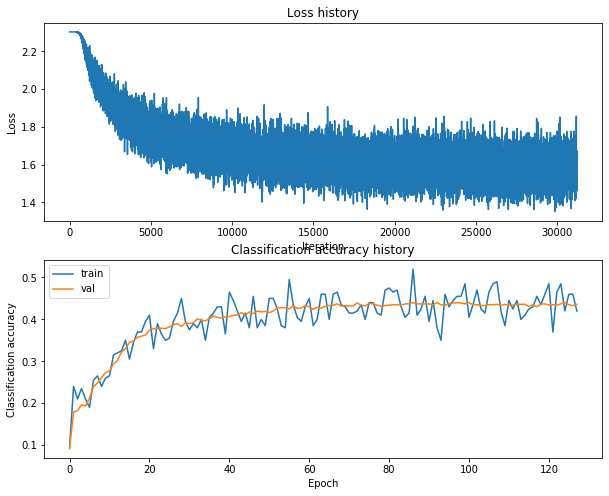

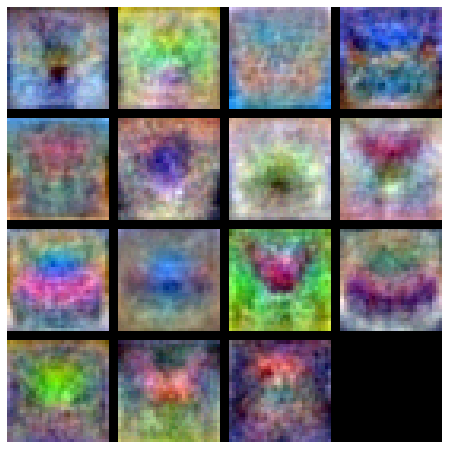










24it [15:49, 48.50s/it]

val accuracy: 0.433
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 5, l_r: 0.0005530506916253576, train_itrs: 2476, reg: 0.07006089607897162, l_r_decay: 0.9078163974718341
---------------------------------------------------------------------------------------
iteration 0 / 2476: loss 2.302595
iteration 100 / 2476: loss 2.177949
iteration 200 / 2476: loss 1.946374
iteration 300 / 2476: loss 1.843498
iteration 400 / 2476: loss 1.889409
iteration 500 / 2476: loss 1.860017
iteration 600 / 2476: loss 1.869356
iteration 700 / 2476: loss 1.890673
iteration 800 / 2476: loss 1.811479
iteration 900 / 2476: loss 1.888963
iteration 1000 / 2476: loss 1.896161
iteration 1100 / 2476: loss 1.805746
iteration 1200 / 2476: loss 1.797815
iteration 1300 / 2476: loss 1.829301
iteration 1400 / 2476: loss 1.913840
iteration 1500 / 2476: loss 1.767000
iteration 1600 / 2476: loss 1.6852

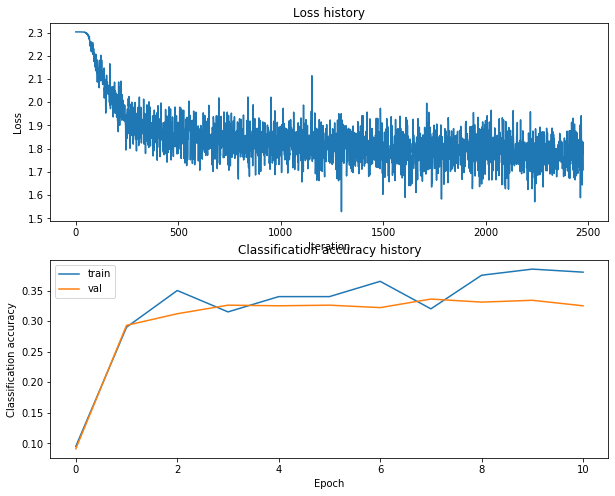

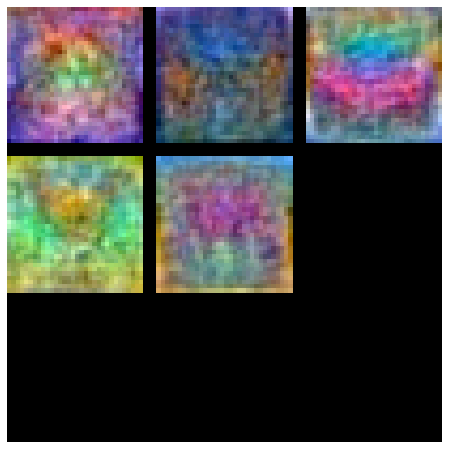










25it [15:57, 36.46s/it]

val accuracy: 0.323
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 18, l_r: 0.00010064952776151211, train_itrs: 1289, reg: 0.01569425706604858, l_r_decay: 0.9278138220092853
---------------------------------------------------------------------------------------
iteration 0 / 1289: loss 2.302592
iteration 100 / 1289: loss 2.302469
iteration 200 / 1289: loss 2.301608
iteration 300 / 1289: loss 2.292001
iteration 400 / 1289: loss 2.238628
iteration 500 / 1289: loss 2.180938
iteration 600 / 1289: loss 2.119961
iteration 700 / 1289: loss 2.119824
iteration 800 / 1289: loss 2.029768
iteration 900 / 1289: loss 2.008844
iteration 1000 / 1289: loss 1.985572
iteration 1100 / 1289: loss 1.968362
iteration 1200 / 1289: loss 1.924389


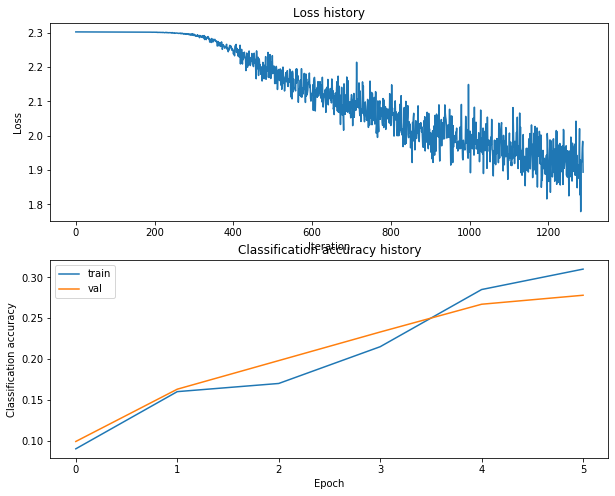

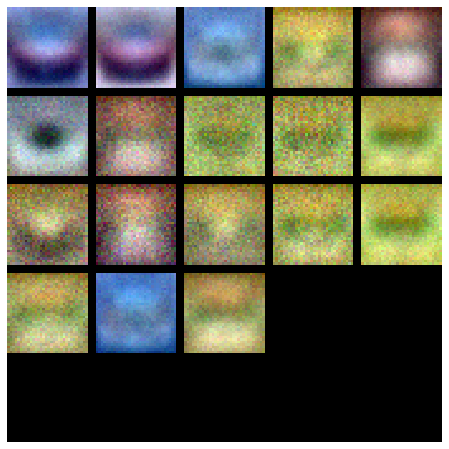










26it [16:03, 27.21s/it]

val accuracy: 0.275
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 27, l_r: 0.0004607991882806374, train_itrs: 2167, reg: 0.017489568460134268, l_r_decay: 0.8490661312010567
---------------------------------------------------------------------------------------
iteration 0 / 2167: loss 2.302609
iteration 100 / 2167: loss 2.187255
iteration 200 / 2167: loss 2.050526
iteration 300 / 2167: loss 1.788740
iteration 400 / 2167: loss 1.759219
iteration 500 / 2167: loss 1.843279
iteration 600 / 2167: loss 1.883663
iteration 700 / 2167: loss 1.720063
iteration 800 / 2167: loss 1.724699
iteration 900 / 2167: loss 1.741762
iteration 1000 / 2167: loss 1.542525
iteration 1100 / 2167: loss 1.701558
iteration 1200 / 2167: loss 1.536203
iteration 1300 / 2167: loss 1.694750
iteration 1400 / 2167: loss 1.598911
iteration 1500 / 2167: loss 1.502141
iteration 1600 / 2167: loss 1.53

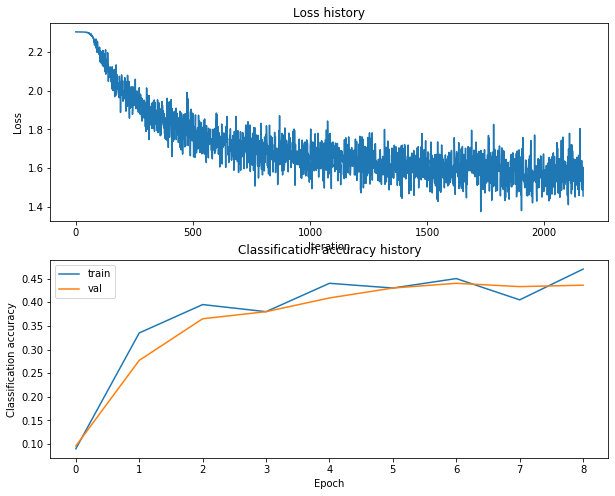

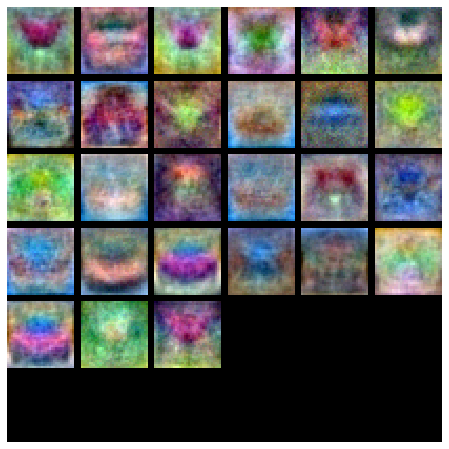










27it [16:14, 22.33s/it]

val accuracy: 0.442
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 7, l_r: 3.589029340184059e-05, train_itrs: 2660, reg: 0.008692018996663107, l_r_decay: 0.881919706283431
---------------------------------------------------------------------------------------
iteration 0 / 2660: loss 2.302580
iteration 100 / 2660: loss 2.302583
iteration 200 / 2660: loss 2.302568
iteration 300 / 2660: loss 2.302518
iteration 400 / 2660: loss 2.302471
iteration 500 / 2660: loss 2.302361
iteration 600 / 2660: loss 2.302046
iteration 700 / 2660: loss 2.301888
iteration 800 / 2660: loss 2.301508
iteration 900 / 2660: loss 2.299997
iteration 1000 / 2660: loss 2.298001
iteration 1100 / 2660: loss 2.292473
iteration 1200 / 2660: loss 2.290213
iteration 1300 / 2660: loss 2.284848
iteration 1400 / 2660: loss 2.269453
iteration 1500 / 2660: loss 2.258166
iteration 1600 / 2660: loss 2.2670

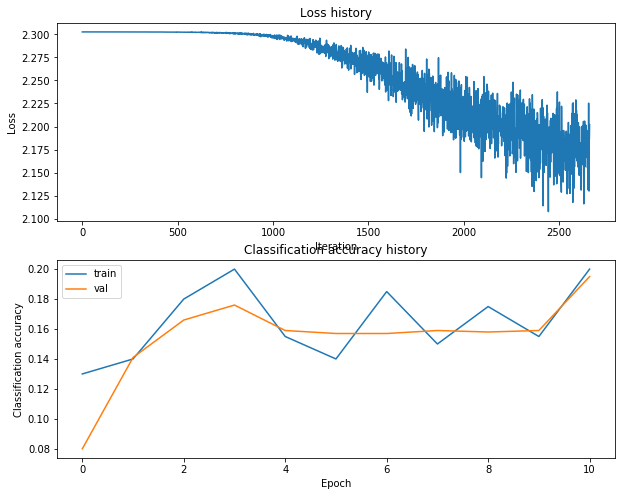

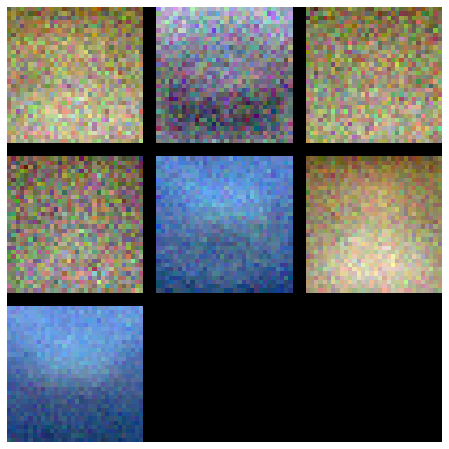










28it [16:24, 18.51s/it]

val accuracy: 0.197
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 13, l_r: 1.0859371815334014e-05, train_itrs: 5088, reg: 0.01955058341797749, l_r_decay: 0.8214768849600793
---------------------------------------------------------------------------------------
iteration 0 / 5088: loss 2.302594
iteration 100 / 5088: loss 2.302580
iteration 200 / 5088: loss 2.302571
iteration 300 / 5088: loss 2.302565
iteration 400 / 5088: loss 2.302550
iteration 500 / 5088: loss 2.302554
iteration 600 / 5088: loss 2.302522
iteration 700 / 5088: loss 2.302549
iteration 800 / 5088: loss 2.302492
iteration 900 / 5088: loss 2.302502
iteration 1000 / 5088: loss 2.302518
iteration 1100 / 5088: loss 2.302483
iteration 1200 / 5088: loss 2.302478
iteration 1300 / 5088: loss 2.302508
iteration 1400 / 5088: loss 2.302519
iteration 1500 / 5088: loss 2.302420
iteration 1600 / 5088: loss 2.30

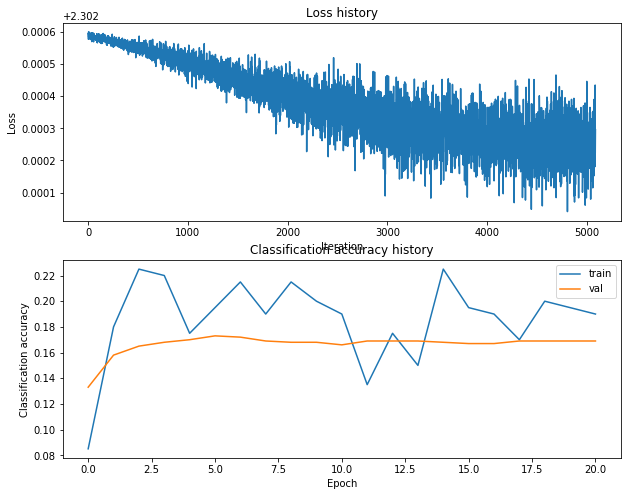

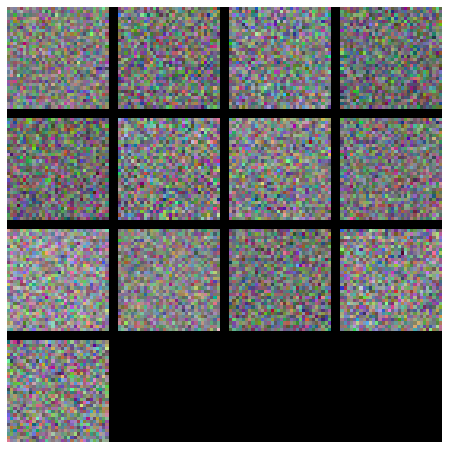










29it [16:42, 18.60s/it]

val accuracy: 0.169
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 67, l_r: 2.4590198500691565e-05, train_itrs: 32156, reg: 0.0014966039902461416, l_r_decay: 0.8312351420193125
---------------------------------------------------------------------------------------
iteration 0 / 32156: loss 2.302602
iteration 100 / 32156: loss 2.302539
iteration 200 / 32156: loss 2.302458
iteration 300 / 32156: loss 2.302404
iteration 400 / 32156: loss 2.302259
iteration 500 / 32156: loss 2.302196
iteration 600 / 32156: loss 2.302032
iteration 700 / 32156: loss 2.301508
iteration 800 / 32156: loss 2.300902
iteration 900 / 32156: loss 2.300801
iteration 1000 / 32156: loss 2.301155
iteration 1100 / 32156: loss 2.300056
iteration 1200 / 32156: loss 2.299784
iteration 1300 / 32156: loss 2.297289
iteration 1400 / 32156: loss 2.297738
iteration 1500 / 32156: loss 2.294612
iteration 160

iteration 20300 / 32156: loss 2.253968
iteration 20400 / 32156: loss 2.254450
iteration 20500 / 32156: loss 2.246872
iteration 20600 / 32156: loss 2.251549
iteration 20700 / 32156: loss 2.249189
iteration 20800 / 32156: loss 2.247364
iteration 20900 / 32156: loss 2.248231
iteration 21000 / 32156: loss 2.237546
iteration 21100 / 32156: loss 2.236885
iteration 21200 / 32156: loss 2.262433
iteration 21300 / 32156: loss 2.255757
iteration 21400 / 32156: loss 2.258292
iteration 21500 / 32156: loss 2.246193
iteration 21600 / 32156: loss 2.239368
iteration 21700 / 32156: loss 2.247220
iteration 21800 / 32156: loss 2.237120
iteration 21900 / 32156: loss 2.242619
iteration 22000 / 32156: loss 2.239677
iteration 22100 / 32156: loss 2.254371
iteration 22200 / 32156: loss 2.254846
iteration 22300 / 32156: loss 2.265837
iteration 22400 / 32156: loss 2.228036
iteration 22500 / 32156: loss 2.228439
iteration 22600 / 32156: loss 2.245183
iteration 22700 / 32156: loss 2.238339
iteration 22800 / 32156: 

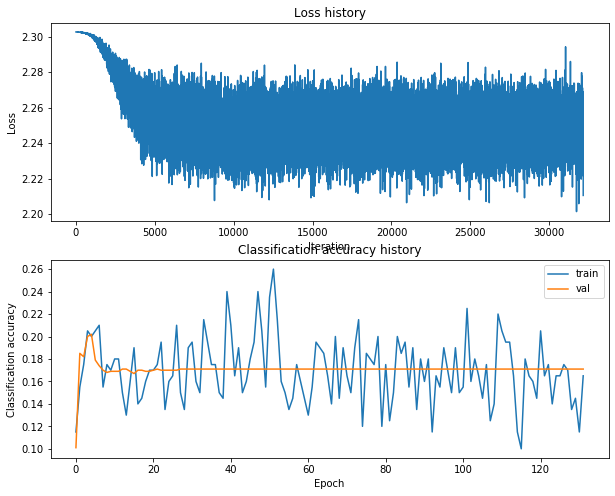

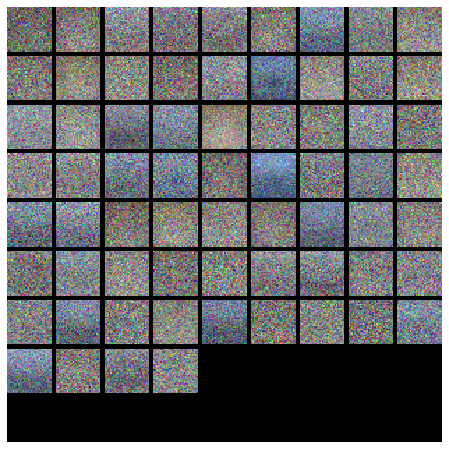










30it [20:48, 86.65s/it]

val accuracy: 0.171
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 8, l_r: 2.976916128352086e-05, train_itrs: 2141, reg: 0.054893354610318246, l_r_decay: 0.8208195835005856
---------------------------------------------------------------------------------------
iteration 0 / 2141: loss 2.302607
iteration 100 / 2141: loss 2.302599
iteration 200 / 2141: loss 2.302598
iteration 300 / 2141: loss 2.302586
iteration 400 / 2141: loss 2.302589
iteration 500 / 2141: loss 2.302574
iteration 600 / 2141: loss 2.302579
iteration 700 / 2141: loss 2.302561
iteration 800 / 2141: loss 2.302532
iteration 900 / 2141: loss 2.302522
iteration 1000 / 2141: loss 2.302458
iteration 1100 / 2141: loss 2.302404
iteration 1200 / 2141: loss 2.302367
iteration 1300 / 2141: loss 2.302280
iteration 1400 / 2141: loss 2.302196
iteration 1500 / 2141: loss 2.302073
iteration 1600 / 2141: loss 2.302

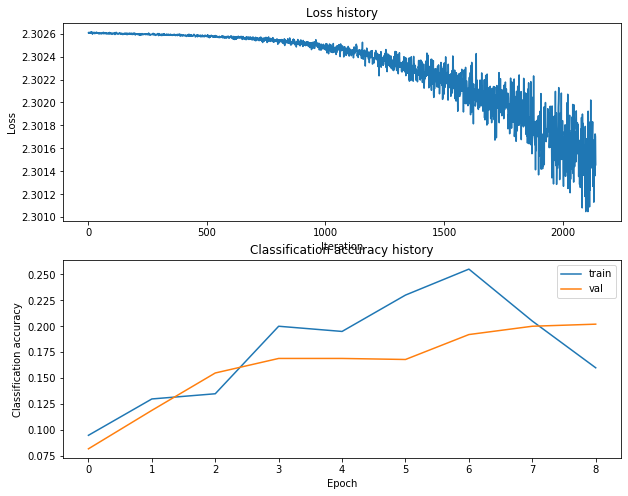

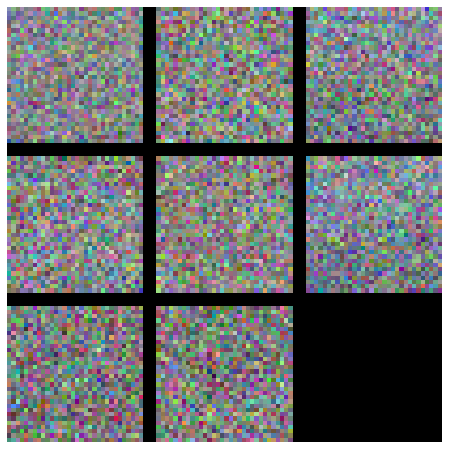










31it [20:55, 62.88s/it]

val accuracy: 0.2
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 51, l_r: 1.9182010148061997e-05, train_itrs: 573, reg: 0.02009905982447048, l_r_decay: 0.9179133113949846
---------------------------------------------------------------------------------------
iteration 0 / 573: loss 2.302597
iteration 100 / 573: loss 2.302562
iteration 200 / 573: loss 2.302478
iteration 300 / 573: loss 2.302444
iteration 400 / 573: loss 2.302360
iteration 500 / 573: loss 2.302072


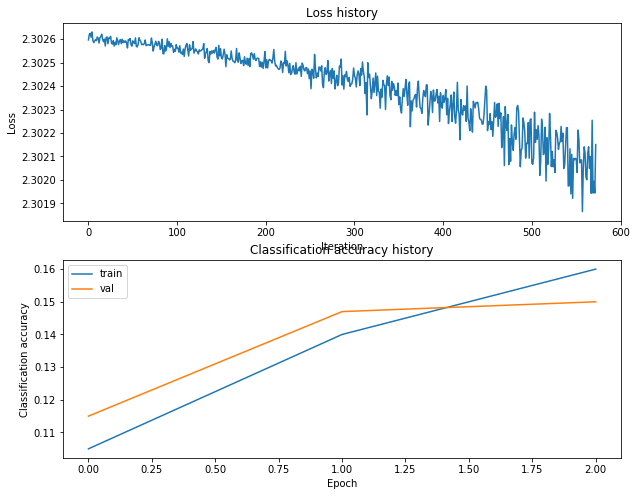

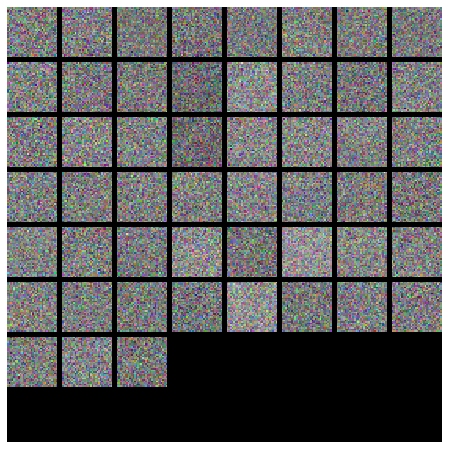










32it [20:59, 45.26s/it]

val accuracy: 0.163
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 57, l_r: 0.00041667558973261217, train_itrs: 27485, reg: 0.02580555826518483, l_r_decay: 0.9723054695482463
---------------------------------------------------------------------------------------
iteration 0 / 27485: loss 2.302640
iteration 100 / 27485: loss 2.143984
iteration 200 / 27485: loss 1.958367
iteration 300 / 27485: loss 1.817312
iteration 400 / 27485: loss 1.761217
iteration 500 / 27485: loss 1.731789
iteration 600 / 27485: loss 1.690854
iteration 700 / 27485: loss 1.703443
iteration 800 / 27485: loss 1.483307
iteration 900 / 27485: loss 1.721197
iteration 1000 / 27485: loss 1.487120
iteration 1100 / 27485: loss 1.557792
iteration 1200 / 27485: loss 1.358769
iteration 1300 / 27485: loss 1.624592
iteration 1400 / 27485: loss 1.578138
iteration 1500 / 27485: loss 1.531796
iteration 1600 

iteration 20300 / 27485: loss 1.130850
iteration 20400 / 27485: loss 0.998970
iteration 20500 / 27485: loss 1.143550
iteration 20600 / 27485: loss 0.990250
iteration 20700 / 27485: loss 1.036254
iteration 20800 / 27485: loss 1.063305
iteration 20900 / 27485: loss 1.128499
iteration 21000 / 27485: loss 0.995201
iteration 21100 / 27485: loss 1.050729
iteration 21200 / 27485: loss 1.099905
iteration 21300 / 27485: loss 1.054947
iteration 21400 / 27485: loss 1.048169
iteration 21500 / 27485: loss 1.188060
iteration 21600 / 27485: loss 0.960547
iteration 21700 / 27485: loss 1.133800
iteration 21800 / 27485: loss 1.156563
iteration 21900 / 27485: loss 1.249375
iteration 22000 / 27485: loss 1.007695
iteration 22100 / 27485: loss 1.142891
iteration 22200 / 27485: loss 1.084477
iteration 22300 / 27485: loss 0.902105
iteration 22400 / 27485: loss 0.995724
iteration 22500 / 27485: loss 1.041436
iteration 22600 / 27485: loss 1.181326
iteration 22700 / 27485: loss 1.069834
iteration 22800 / 27485: 

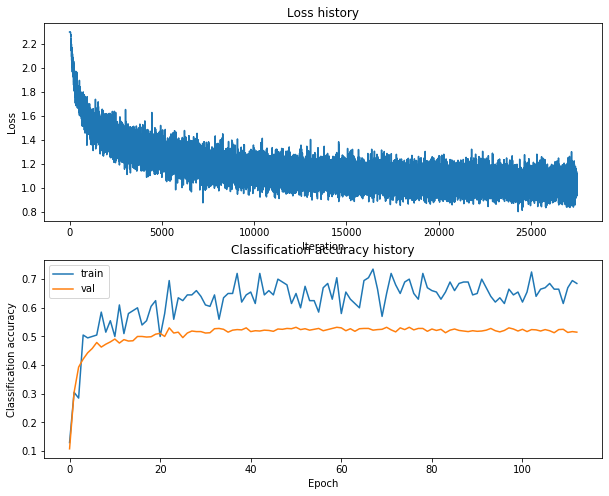

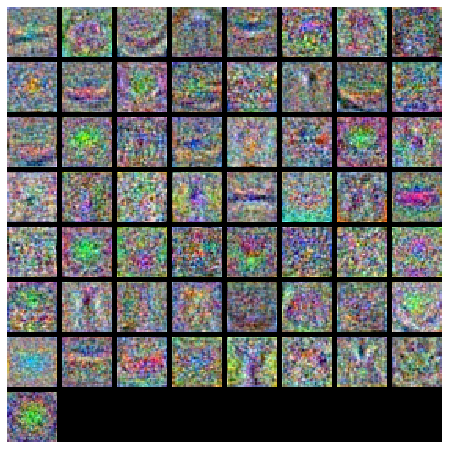










33it [24:08, 88.33s/it]

val accuracy: 0.52
Found better model with val acuracy: 0.52, with combination: (57, 0.00041667558973261217, 27485, 0.02580555826518483, 0.9723054695482463)
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 7, l_r: 2.5364538407561895e-05, train_itrs: 1067, reg: 0.0022930498033621877, l_r_decay: 0.8574457991019011
---------------------------------------------------------------------------------------
iteration 0 / 1067: loss 2.302587
iteration 100 / 1067: loss 2.302584
iteration 200 / 1067: loss 2.302563
iteration 300 / 1067: loss 2.302559
iteration 400 / 1067: loss 2.302547
iteration 500 / 1067: loss 2.302510
iteration 600 / 1067: loss 2.302440
iteration 700 / 1067: loss 2.302400
iteration 800 / 1067: loss 2.302326
iteration 900 / 1067: loss 2.302129
iteration 1000 / 1067: loss 2.301826


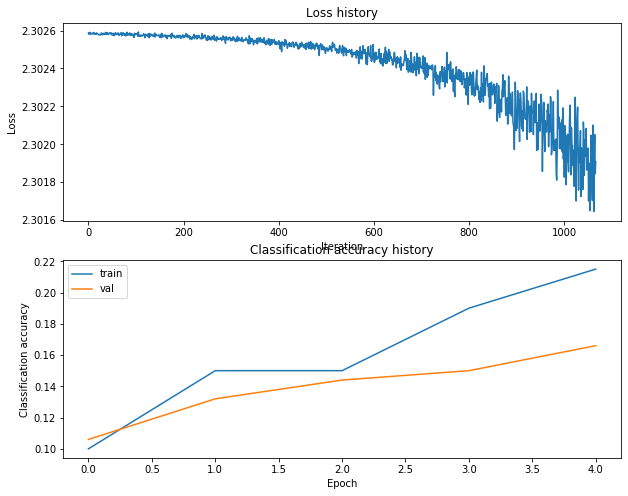

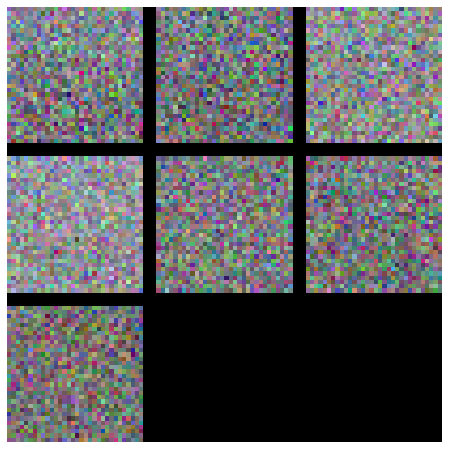










34it [24:12, 63.08s/it]

val accuracy: 0.171
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 13, l_r: 0.00017132198508353706, train_itrs: 26214, reg: 0.033805581282770905, l_r_decay: 0.8238526616847275
---------------------------------------------------------------------------------------
iteration 0 / 26214: loss 2.302597
iteration 100 / 26214: loss 2.302283
iteration 200 / 26214: loss 2.293435
iteration 300 / 26214: loss 2.218642
iteration 400 / 26214: loss 2.145609
iteration 500 / 26214: loss 2.087295
iteration 600 / 26214: loss 2.031092
iteration 700 / 26214: loss 1.971397
iteration 800 / 26214: loss 2.000866
iteration 900 / 26214: loss 1.981647
iteration 1000 / 26214: loss 1.883114
iteration 1100 / 26214: loss 1.997253
iteration 1200 / 26214: loss 1.991662
iteration 1300 / 26214: loss 1.976849
iteration 1400 / 26214: loss 1.850649
iteration 1500 / 26214: loss 1.847533
iteration 1600

iteration 20300 / 26214: loss 1.775261
iteration 20400 / 26214: loss 1.793000
iteration 20500 / 26214: loss 1.783368
iteration 20600 / 26214: loss 1.784176
iteration 20700 / 26214: loss 1.776092
iteration 20800 / 26214: loss 1.833170
iteration 20900 / 26214: loss 1.818124
iteration 21000 / 26214: loss 1.853179
iteration 21100 / 26214: loss 1.963395
iteration 21200 / 26214: loss 1.872803
iteration 21300 / 26214: loss 1.734550
iteration 21400 / 26214: loss 1.666187
iteration 21500 / 26214: loss 1.680783
iteration 21600 / 26214: loss 1.897122
iteration 21700 / 26214: loss 1.793137
iteration 21800 / 26214: loss 1.820707
iteration 21900 / 26214: loss 1.728538
iteration 22000 / 26214: loss 1.674779
iteration 22100 / 26214: loss 1.815028
iteration 22200 / 26214: loss 1.898700
iteration 22300 / 26214: loss 1.802374
iteration 22400 / 26214: loss 1.797702
iteration 22500 / 26214: loss 1.692723
iteration 22600 / 26214: loss 1.718114
iteration 22700 / 26214: loss 1.717504
iteration 22800 / 26214: 

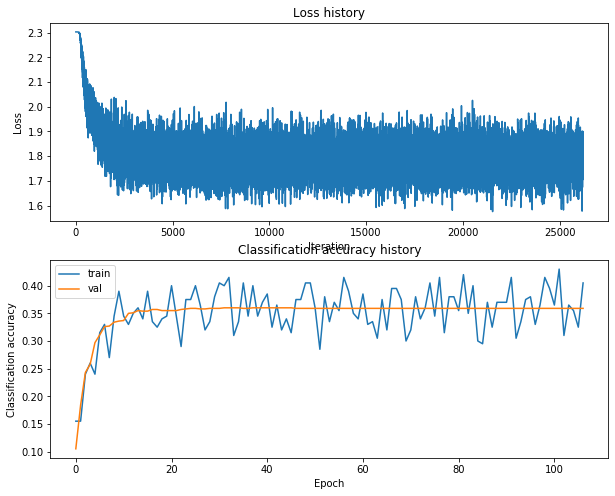

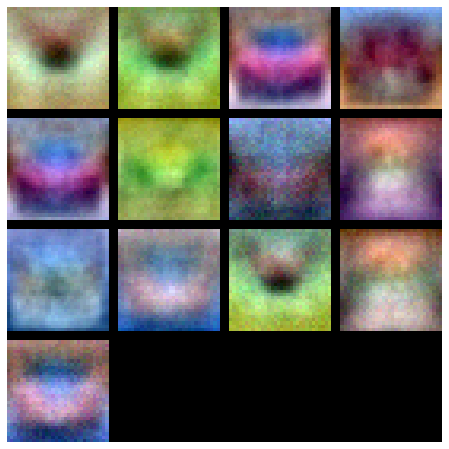










35it [25:51, 73.69s/it]

val accuracy: 0.359
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 11, l_r: 0.00027938795177069695, train_itrs: 8230, reg: 0.007071890626448661, l_r_decay: 0.8669171362716146
---------------------------------------------------------------------------------------
iteration 0 / 8230: loss 2.302602
iteration 100 / 8230: loss 2.300314
iteration 200 / 8230: loss 2.159382
iteration 300 / 8230: loss 2.078710
iteration 400 / 8230: loss 1.925932
iteration 500 / 8230: loss 2.018278
iteration 600 / 8230: loss 1.910410
iteration 700 / 8230: loss 1.858897
iteration 800 / 8230: loss 1.883150
iteration 900 / 8230: loss 1.850686
iteration 1000 / 8230: loss 1.719627
iteration 1100 / 8230: loss 1.752715
iteration 1200 / 8230: loss 1.769663
iteration 1300 / 8230: loss 1.816926
iteration 1400 / 8230: loss 1.762439
iteration 1500 / 8230: loss 1.687911
iteration 1600 / 8230: loss 1.7

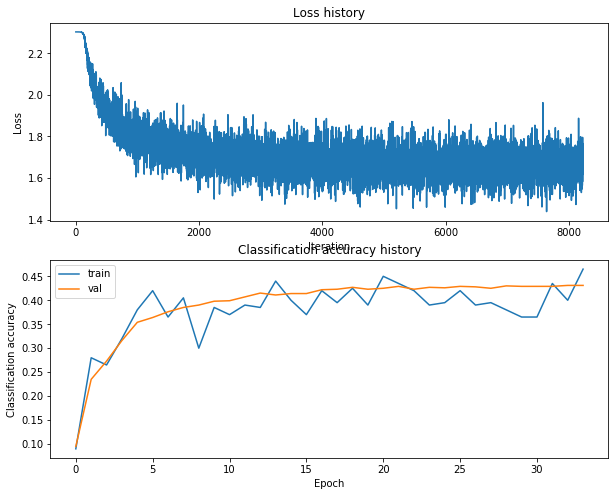

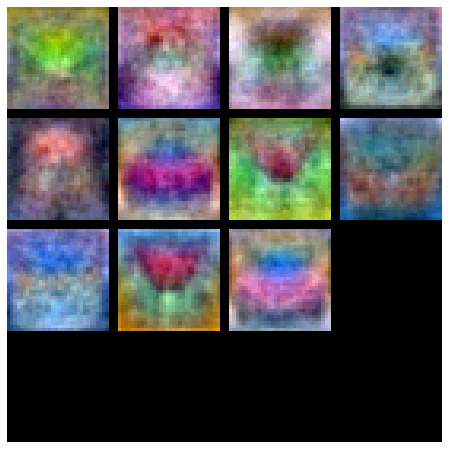










36it [26:21, 60.73s/it]

val accuracy: 0.432
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 6, l_r: 9.639477002222091e-05, train_itrs: 10985, reg: 0.0022452147059738494, l_r_decay: 0.8678900648278772
---------------------------------------------------------------------------------------
iteration 0 / 10985: loss 2.302589
iteration 100 / 10985: loss 2.302572
iteration 200 / 10985: loss 2.302476
iteration 300 / 10985: loss 2.302073
iteration 400 / 10985: loss 2.298084
iteration 500 / 10985: loss 2.280812
iteration 600 / 10985: loss 2.247564
iteration 700 / 10985: loss 2.216705
iteration 800 / 10985: loss 2.059438
iteration 900 / 10985: loss 2.103427
iteration 1000 / 10985: loss 2.078117
iteration 1100 / 10985: loss 2.079854
iteration 1200 / 10985: loss 1.951920
iteration 1300 / 10985: loss 2.125407
iteration 1400 / 10985: loss 2.048978
iteration 1500 / 10985: loss 1.983440
iteration 1600 

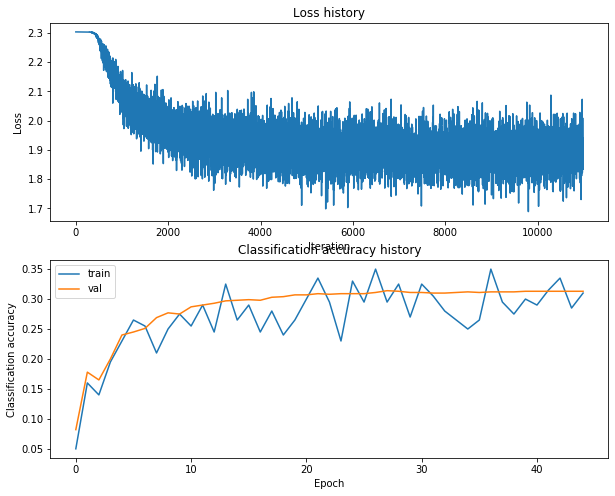

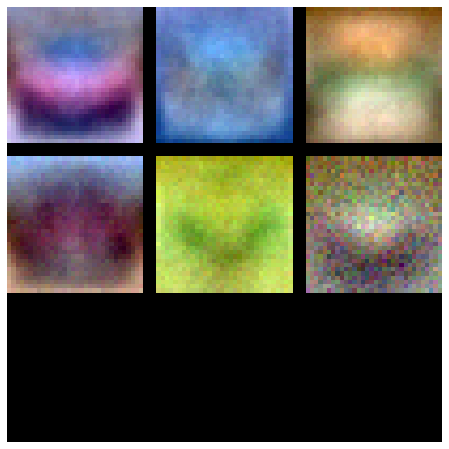










37it [27:00, 54.05s/it]

val accuracy: 0.313
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 28, l_r: 8.738035386381753e-05, train_itrs: 641, reg: 0.0019916809324424297, l_r_decay: 0.8032909960498459
---------------------------------------------------------------------------------------
iteration 0 / 641: loss 2.302591
iteration 100 / 641: loss 2.302446
iteration 200 / 641: loss 2.301755
iteration 300 / 641: loss 2.298110
iteration 400 / 641: loss 2.287710
iteration 500 / 641: loss 2.251397
iteration 600 / 641: loss 2.212208


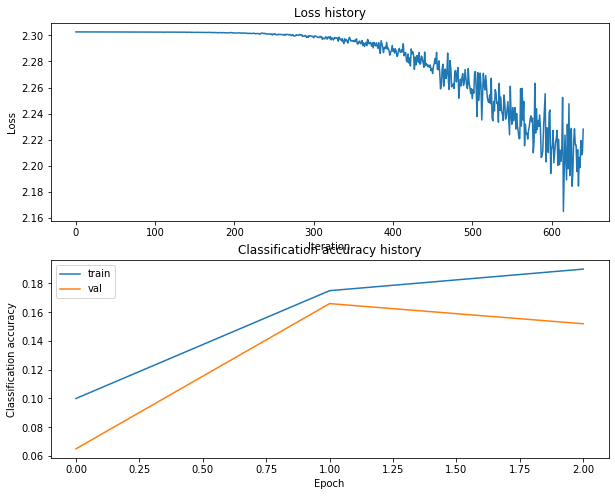

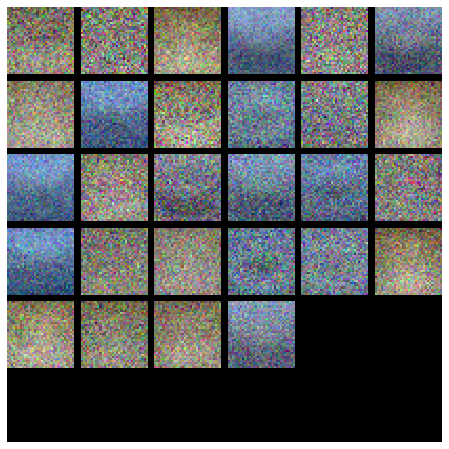










38it [27:04, 39.06s/it]

val accuracy: 0.183
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 48, l_r: 0.0002707168357562803, train_itrs: 793, reg: 0.03433618233894751, l_r_decay: 0.8275868233316073
---------------------------------------------------------------------------------------
iteration 0 / 793: loss 2.302621
iteration 100 / 793: loss 2.292385
iteration 200 / 793: loss 2.127433
iteration 300 / 793: loss 2.102855
iteration 400 / 793: loss 1.914318
iteration 500 / 793: loss 1.942857
iteration 600 / 793: loss 1.830216
iteration 700 / 793: loss 1.879144


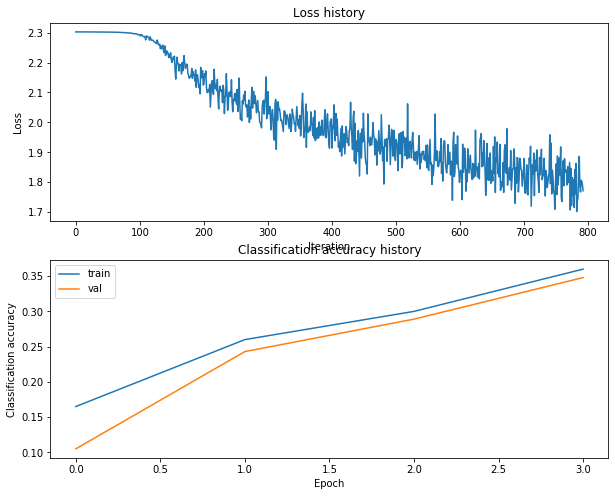

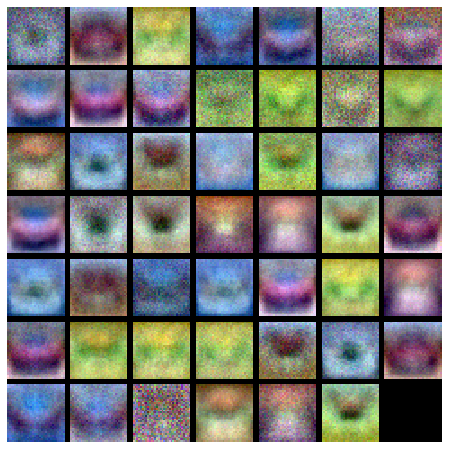










39it [27:10, 29.06s/it]

val accuracy: 0.355
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 30, l_r: 2.1918275697911758e-05, train_itrs: 7949, reg: 0.018007932608752754, l_r_decay: 0.9464561530354939
---------------------------------------------------------------------------------------
iteration 0 / 7949: loss 2.302609
iteration 100 / 7949: loss 2.302554
iteration 200 / 7949: loss 2.302540
iteration 300 / 7949: loss 2.302510
iteration 400 / 7949: loss 2.302424
iteration 500 / 7949: loss 2.302380
iteration 600 / 7949: loss 2.302204
iteration 700 / 7949: loss 2.302032
iteration 800 / 7949: loss 2.301693
iteration 900 / 7949: loss 2.301368
iteration 1000 / 7949: loss 2.300646
iteration 1100 / 7949: loss 2.300126
iteration 1200 / 7949: loss 2.297137
iteration 1300 / 7949: loss 2.295183
iteration 1400 / 7949: loss 2.292481
iteration 1500 / 7949: loss 2.283748
iteration 1600 / 7949: loss 2.2

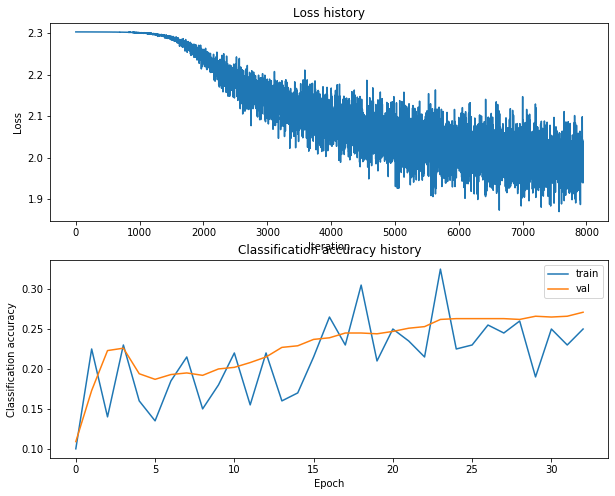

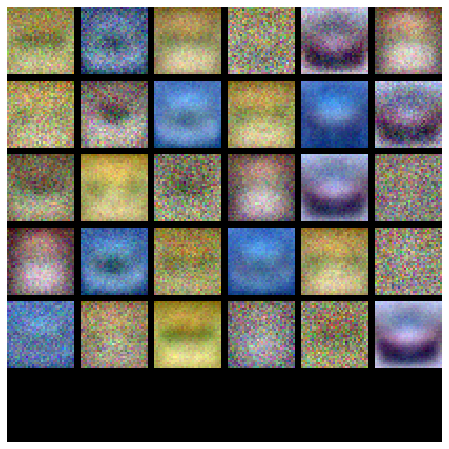










40it [27:53, 33.23s/it]

val accuracy: 0.269
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 26, l_r: 0.0007549271210552654, train_itrs: 869, reg: 0.0901178047259064, l_r_decay: 0.9878819997741334
---------------------------------------------------------------------------------------
iteration 0 / 869: loss 2.302657
iteration 100 / 869: loss 2.048491
iteration 200 / 869: loss 1.850634
iteration 300 / 869: loss 1.732644
iteration 400 / 869: loss 1.652164
iteration 500 / 869: loss 1.542947
iteration 600 / 869: loss 1.494753
iteration 700 / 869: loss 1.638828
iteration 800 / 869: loss 1.526779


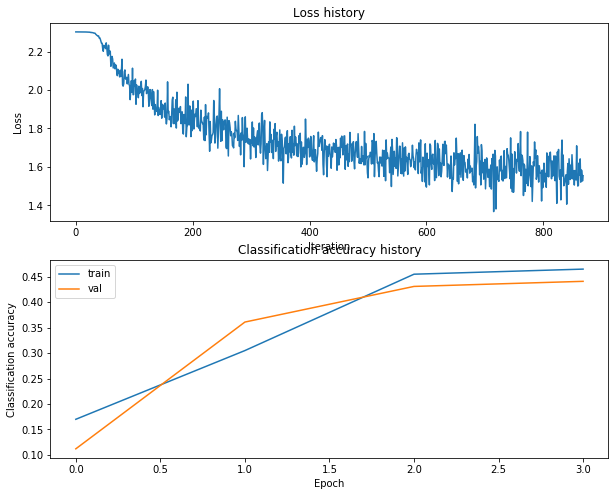

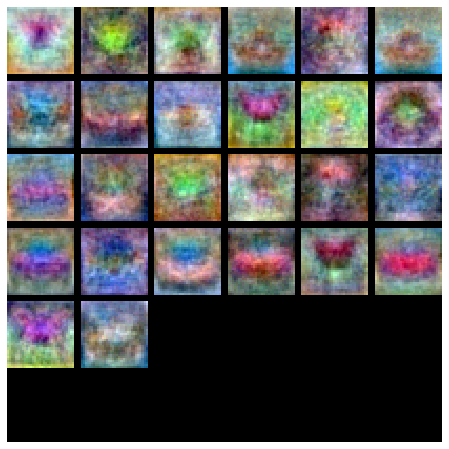










41it [27:57, 24.61s/it]

val accuracy: 0.455
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 46, l_r: 6.67536181771576e-05, train_itrs: 38839, reg: 0.05025682856587892, l_r_decay: 0.8635419983747198
---------------------------------------------------------------------------------------
iteration 0 / 38839: loss 2.302656
iteration 100 / 38839: loss 2.302520
iteration 200 / 38839: loss 2.302349
iteration 300 / 38839: loss 2.301397
iteration 400 / 38839: loss 2.296215
iteration 500 / 38839: loss 2.286862
iteration 600 / 38839: loss 2.270256
iteration 700 / 38839: loss 2.234697
iteration 800 / 38839: loss 2.204271
iteration 900 / 38839: loss 2.138082
iteration 1000 / 38839: loss 2.145449
iteration 1100 / 38839: loss 2.182154
iteration 1200 / 38839: loss 2.078950
iteration 1300 / 38839: loss 2.061393
iteration 1400 / 38839: loss 2.068259
iteration 1500 / 38839: loss 2.035539
iteration 1600 / 

iteration 20400 / 38839: loss 1.934472
iteration 20500 / 38839: loss 1.930472
iteration 20600 / 38839: loss 1.925793
iteration 20700 / 38839: loss 1.877152
iteration 20800 / 38839: loss 1.889400
iteration 20900 / 38839: loss 1.965170
iteration 21000 / 38839: loss 1.841015
iteration 21100 / 38839: loss 1.895749
iteration 21200 / 38839: loss 1.953522
iteration 21300 / 38839: loss 1.988519
iteration 21400 / 38839: loss 1.895233
iteration 21500 / 38839: loss 1.907993
iteration 21600 / 38839: loss 1.921436
iteration 21700 / 38839: loss 1.918477
iteration 21800 / 38839: loss 1.958813
iteration 21900 / 38839: loss 1.895263
iteration 22000 / 38839: loss 1.864157
iteration 22100 / 38839: loss 1.836431
iteration 22200 / 38839: loss 1.976306
iteration 22300 / 38839: loss 2.019794
iteration 22400 / 38839: loss 1.972207
iteration 22500 / 38839: loss 1.860785
iteration 22600 / 38839: loss 1.943613
iteration 22700 / 38839: loss 1.895888
iteration 22800 / 38839: loss 1.913545
iteration 22900 / 38839: 

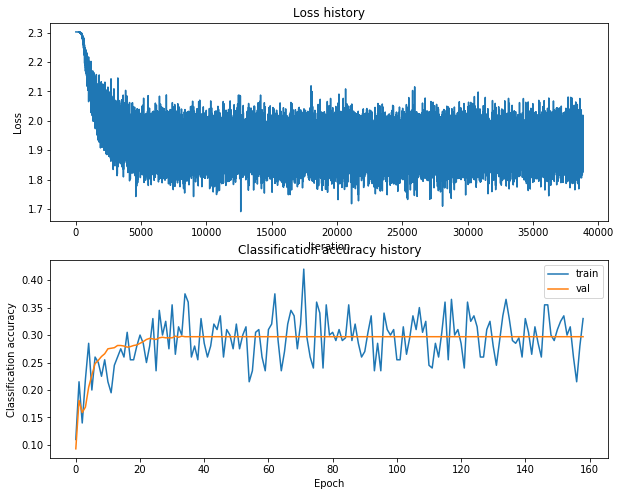

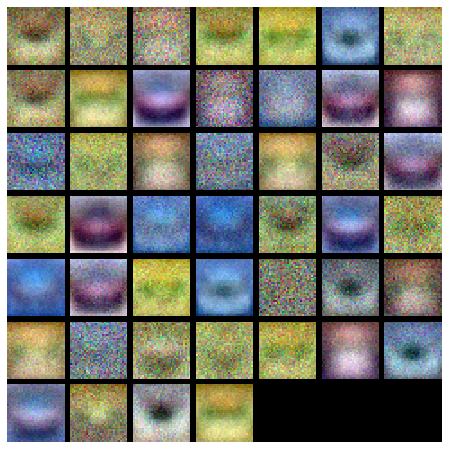










42it [32:02, 90.86s/it]

val accuracy: 0.297
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 79, l_r: 0.00015466858757832609, train_itrs: 15716, reg: 0.018082802405495285, l_r_decay: 0.8867431947987907
---------------------------------------------------------------------------------------
iteration 0 / 15716: loss 2.302612
iteration 100 / 15716: loss 2.300772
iteration 200 / 15716: loss 2.252564
iteration 300 / 15716: loss 2.170109
iteration 400 / 15716: loss 2.107414
iteration 500 / 15716: loss 1.989406
iteration 600 / 15716: loss 1.988296
iteration 700 / 15716: loss 1.934965
iteration 800 / 15716: loss 1.870116
iteration 900 / 15716: loss 1.788475
iteration 1000 / 15716: loss 1.749064
iteration 1100 / 15716: loss 1.860313
iteration 1200 / 15716: loss 1.871671
iteration 1300 / 15716: loss 1.795732
iteration 1400 / 15716: loss 1.806340
iteration 1500 / 15716: loss 1.884932
iteration 1600

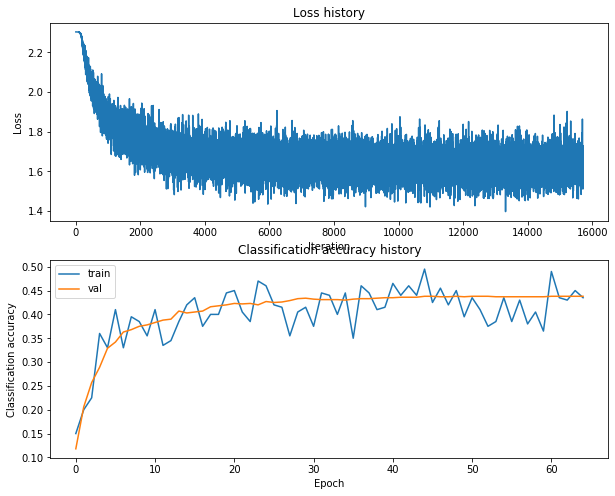

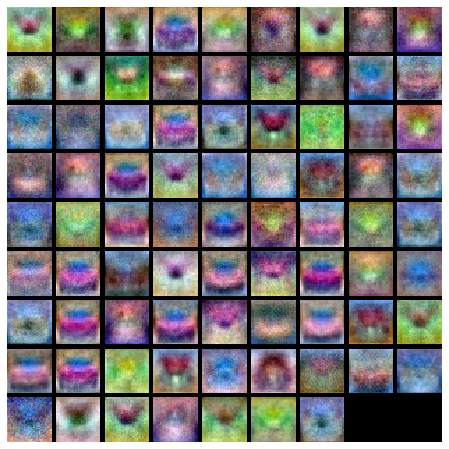










43it [34:29, 107.52s/it]

val accuracy: 0.438
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 20, l_r: 0.00016301808526241496, train_itrs: 43160, reg: 0.023012075219853764, l_r_decay: 0.8482764182584334
---------------------------------------------------------------------------------------
iteration 0 / 43160: loss 2.302578
iteration 100 / 43160: loss 2.301726
iteration 200 / 43160: loss 2.287330
iteration 300 / 43160: loss 2.173602
iteration 400 / 43160: loss 2.098624
iteration 500 / 43160: loss 2.067073
iteration 600 / 43160: loss 2.023224
iteration 700 / 43160: loss 2.062693
iteration 800 / 43160: loss 1.913590
iteration 900 / 43160: loss 1.952066
iteration 1000 / 43160: loss 1.857740
iteration 1100 / 43160: loss 1.886819
iteration 1200 / 43160: loss 1.892101
iteration 1300 / 43160: loss 1.859365
iteration 1400 / 43160: loss 1.864718
iteration 1500 / 43160: loss 1.871751
iteration 1600

iteration 20300 / 43160: loss 1.811577
iteration 20400 / 43160: loss 1.692215
iteration 20500 / 43160: loss 1.663726
iteration 20600 / 43160: loss 1.750406
iteration 20700 / 43160: loss 1.725930
iteration 20800 / 43160: loss 1.731234
iteration 20900 / 43160: loss 1.859560
iteration 21000 / 43160: loss 1.710027
iteration 21100 / 43160: loss 1.848866
iteration 21200 / 43160: loss 1.694780
iteration 21300 / 43160: loss 1.765739
iteration 21400 / 43160: loss 1.752090
iteration 21500 / 43160: loss 1.826388
iteration 21600 / 43160: loss 1.688019
iteration 21700 / 43160: loss 1.727931
iteration 21800 / 43160: loss 1.626259
iteration 21900 / 43160: loss 1.823339
iteration 22000 / 43160: loss 1.750824
iteration 22100 / 43160: loss 1.726925
iteration 22200 / 43160: loss 1.724921
iteration 22300 / 43160: loss 1.690921
iteration 22400 / 43160: loss 1.738419
iteration 22500 / 43160: loss 1.747916
iteration 22600 / 43160: loss 1.821045
iteration 22700 / 43160: loss 1.718335
iteration 22800 / 43160: 

iteration 41400 / 43160: loss 1.902507
iteration 41500 / 43160: loss 1.787112
iteration 41600 / 43160: loss 1.679677
iteration 41700 / 43160: loss 1.678728
iteration 41800 / 43160: loss 1.746888
iteration 41900 / 43160: loss 1.702305
iteration 42000 / 43160: loss 1.692889
iteration 42100 / 43160: loss 1.769289
iteration 42200 / 43160: loss 1.770986
iteration 42300 / 43160: loss 1.789366
iteration 42400 / 43160: loss 1.825604
iteration 42500 / 43160: loss 1.779735
iteration 42600 / 43160: loss 1.761496
iteration 42700 / 43160: loss 1.834748
iteration 42800 / 43160: loss 1.742530
iteration 42900 / 43160: loss 1.680942
iteration 43000 / 43160: loss 1.699474
iteration 43100 / 43160: loss 1.774957


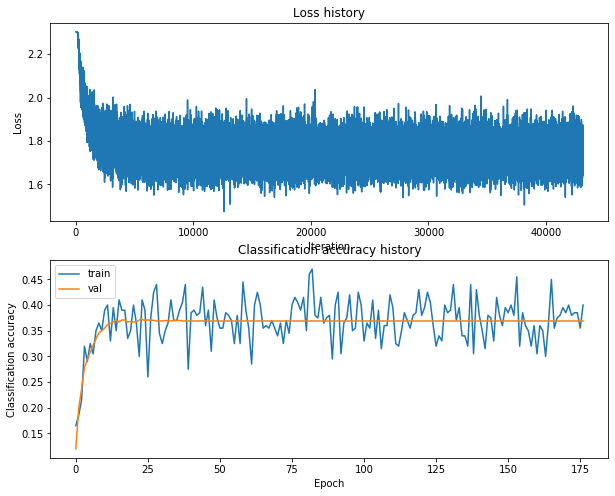

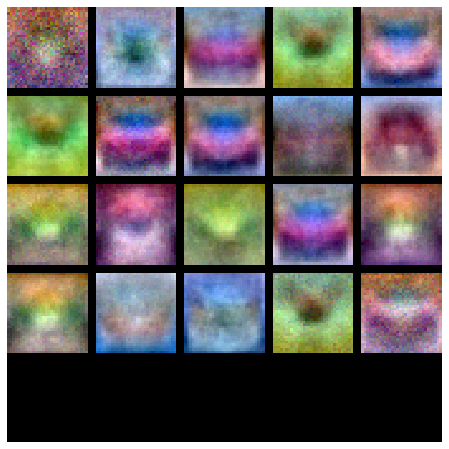










44it [37:41, 132.98s/it]

val accuracy: 0.369
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 37, l_r: 0.0006500363089166781, train_itrs: 3663, reg: 0.007347347249652799, l_r_decay: 0.824465945109253
---------------------------------------------------------------------------------------
iteration 0 / 3663: loss 2.302589
iteration 100 / 3663: loss 2.089026
iteration 200 / 3663: loss 1.935702
iteration 300 / 3663: loss 1.887816
iteration 400 / 3663: loss 1.688870
iteration 500 / 3663: loss 1.670641
iteration 600 / 3663: loss 1.642531
iteration 700 / 3663: loss 1.601022
iteration 800 / 3663: loss 1.666049
iteration 900 / 3663: loss 1.532048
iteration 1000 / 3663: loss 1.536673
iteration 1100 / 3663: loss 1.581438
iteration 1200 / 3663: loss 1.571848
iteration 1300 / 3663: loss 1.573778
iteration 1400 / 3663: loss 1.431669
iteration 1500 / 3663: loss 1.592431
iteration 1600 / 3663: loss 1.527

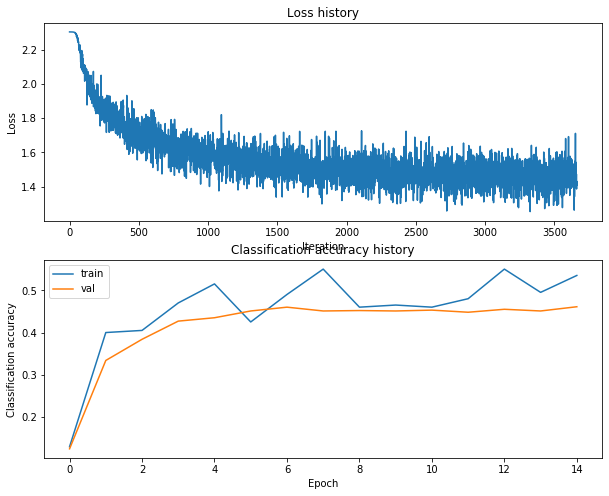

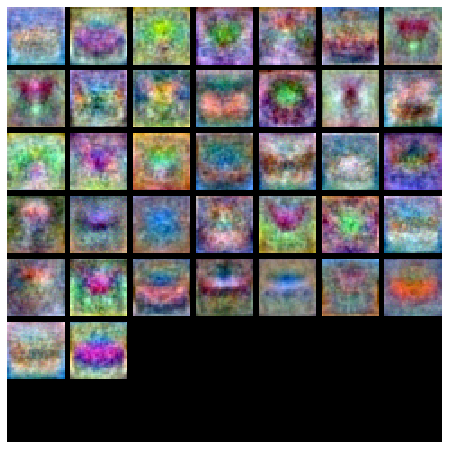










45it [38:04, 99.77s/it] 

val accuracy: 0.455
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 56, l_r: 0.0007248742731762323, train_itrs: 28664, reg: 0.003841886673535191, l_r_decay: 0.8872410091568632
---------------------------------------------------------------------------------------
iteration 0 / 28664: loss 2.302608
iteration 100 / 28664: loss 2.032418
iteration 200 / 28664: loss 1.932635
iteration 300 / 28664: loss 1.792069
iteration 400 / 28664: loss 1.702210
iteration 500 / 28664: loss 1.634014
iteration 600 / 28664: loss 1.630986
iteration 700 / 28664: loss 1.470912
iteration 800 / 28664: loss 1.639531
iteration 900 / 28664: loss 1.595113
iteration 1000 / 28664: loss 1.460568
iteration 1100 / 28664: loss 1.643383
iteration 1200 / 28664: loss 1.343193
iteration 1300 / 28664: loss 1.433805
iteration 1400 / 28664: loss 1.494710
iteration 1500 / 28664: loss 1.364669
iteration 1600 

iteration 20300 / 28664: loss 1.230711
iteration 20400 / 28664: loss 1.265389
iteration 20500 / 28664: loss 1.271836
iteration 20600 / 28664: loss 1.198311
iteration 20700 / 28664: loss 1.321992
iteration 20800 / 28664: loss 1.291379
iteration 20900 / 28664: loss 1.193221
iteration 21000 / 28664: loss 1.304611
iteration 21100 / 28664: loss 1.239150
iteration 21200 / 28664: loss 1.293067
iteration 21300 / 28664: loss 1.362281
iteration 21400 / 28664: loss 1.329432
iteration 21500 / 28664: loss 1.178356
iteration 21600 / 28664: loss 1.282845
iteration 21700 / 28664: loss 1.278546
iteration 21800 / 28664: loss 1.197151
iteration 21900 / 28664: loss 1.346075
iteration 22000 / 28664: loss 1.362384
iteration 22100 / 28664: loss 1.205704
iteration 22200 / 28664: loss 1.169824
iteration 22300 / 28664: loss 1.272430
iteration 22400 / 28664: loss 1.234137
iteration 22500 / 28664: loss 1.359241
iteration 22600 / 28664: loss 1.290457
iteration 22700 / 28664: loss 1.126266
iteration 22800 / 28664: 

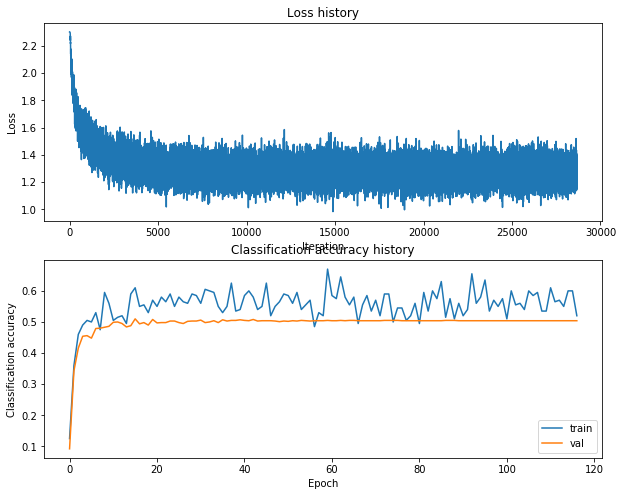

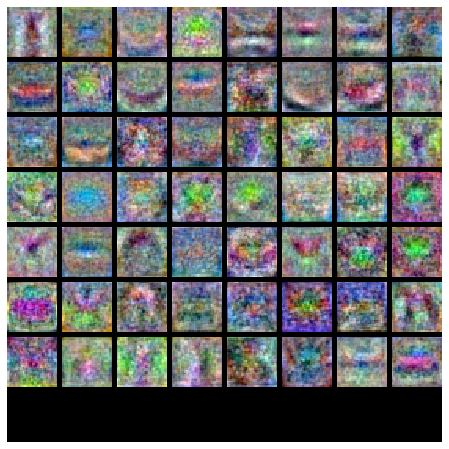










46it [41:19, 128.52s/it]

val accuracy: 0.504
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 31, l_r: 1.0119094323815852e-05, train_itrs: 11189, reg: 0.0018271494217740043, l_r_decay: 0.9423619388325091
---------------------------------------------------------------------------------------
iteration 0 / 11189: loss 2.302602
iteration 100 / 11189: loss 2.302564
iteration 200 / 11189: loss 2.302563
iteration 300 / 11189: loss 2.302541
iteration 400 / 11189: loss 2.302501
iteration 500 / 11189: loss 2.302498
iteration 600 / 11189: loss 2.302479
iteration 700 / 11189: loss 2.302449
iteration 800 / 11189: loss 2.302377
iteration 900 / 11189: loss 2.302354
iteration 1000 / 11189: loss 2.302265
iteration 1100 / 11189: loss 2.302238
iteration 1200 / 11189: loss 2.302207
iteration 1300 / 11189: loss 2.302108
iteration 1400 / 11189: loss 2.302168
iteration 1500 / 11189: loss 2.302037
iteration 160

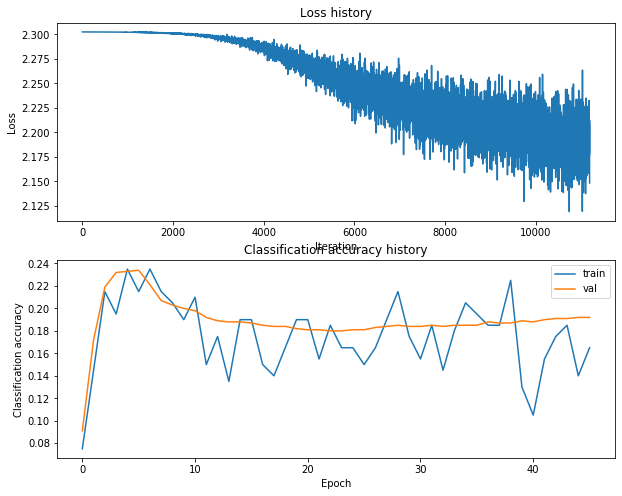

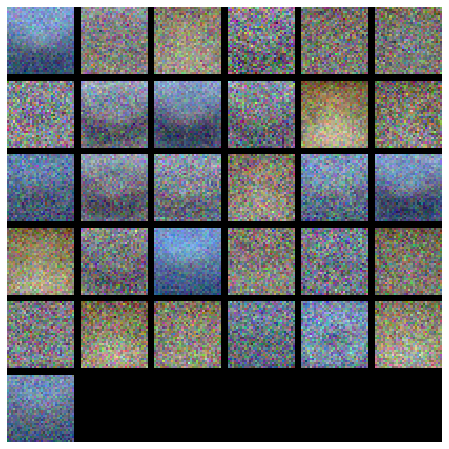










47it [42:28, 110.69s/it]

val accuracy: 0.192
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 10, l_r: 0.00012438764582557168, train_itrs: 856, reg: 0.017737540764986032, l_r_decay: 0.9891738764954412
---------------------------------------------------------------------------------------
iteration 0 / 856: loss 2.302581
iteration 100 / 856: loss 2.302280
iteration 200 / 856: loss 2.292745
iteration 300 / 856: loss 2.199493
iteration 400 / 856: loss 2.129945
iteration 500 / 856: loss 2.119309
iteration 600 / 856: loss 1.972807
iteration 700 / 856: loss 1.975064
iteration 800 / 856: loss 1.888670


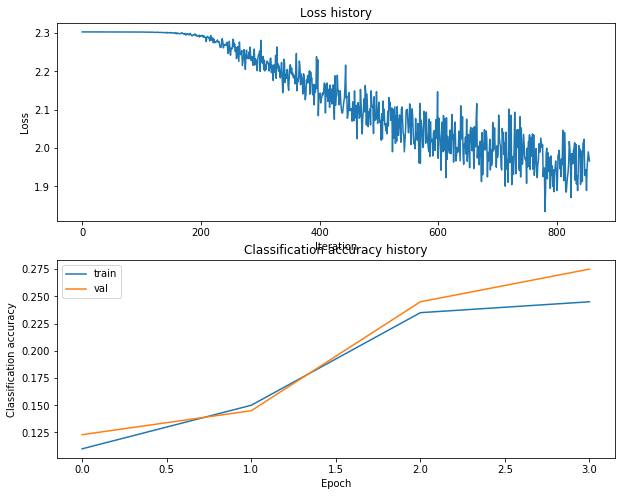

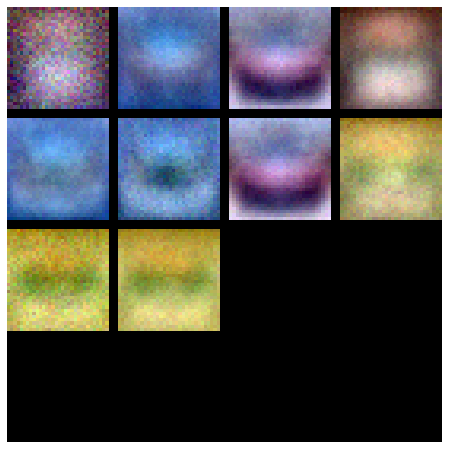










48it [42:32, 78.55s/it] 

val accuracy: 0.269
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 20, l_r: 1.2085544581720617e-05, train_itrs: 19371, reg: 0.0014985545251205157, l_r_decay: 0.8295882402029628
---------------------------------------------------------------------------------------
iteration 0 / 19371: loss 2.302575
iteration 100 / 19371: loss 2.302575
iteration 200 / 19371: loss 2.302579
iteration 300 / 19371: loss 2.302569
iteration 400 / 19371: loss 2.302545
iteration 500 / 19371: loss 2.302521
iteration 600 / 19371: loss 2.302523
iteration 700 / 19371: loss 2.302489
iteration 800 / 19371: loss 2.302438
iteration 900 / 19371: loss 2.302464
iteration 1000 / 19371: loss 2.302550
iteration 1100 / 19371: loss 2.302369
iteration 1200 / 19371: loss 2.302413
iteration 1300 / 19371: loss 2.302264
iteration 1400 / 19371: loss 2.302182
iteration 1500 / 19371: loss 2.302424
iteration 160

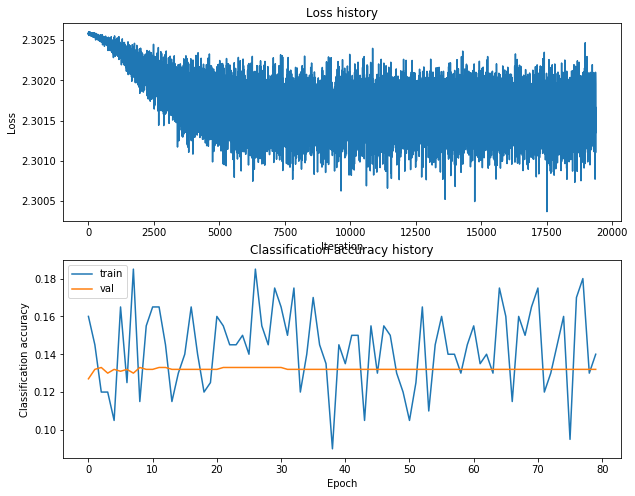

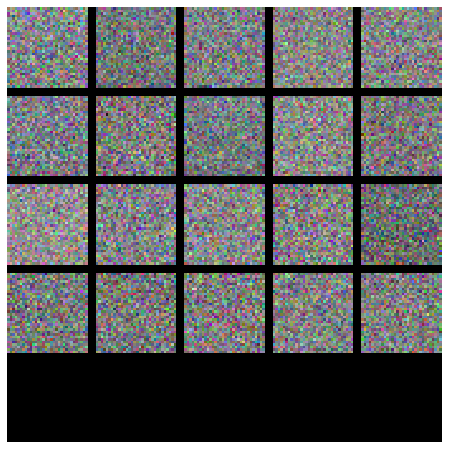










49it [43:55, 79.87s/it]

val accuracy: 0.132
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 12, l_r: 8.65948392162136e-05, train_itrs: 26872, reg: 0.009716144117617129, l_r_decay: 0.8480328251561151
---------------------------------------------------------------------------------------
iteration 0 / 26872: loss 2.302600
iteration 100 / 26872: loss 2.302495
iteration 200 / 26872: loss 2.301786
iteration 300 / 26872: loss 2.298018
iteration 400 / 26872: loss 2.280684
iteration 500 / 26872: loss 2.271760
iteration 600 / 26872: loss 2.232676
iteration 700 / 26872: loss 2.143496
iteration 800 / 26872: loss 2.167086
iteration 900 / 26872: loss 2.154512
iteration 1000 / 26872: loss 2.108163
iteration 1100 / 26872: loss 2.060121
iteration 1200 / 26872: loss 1.984399
iteration 1300 / 26872: loss 2.054996
iteration 1400 / 26872: loss 2.026660
iteration 1500 / 26872: loss 1.964795
iteration 1600 /

iteration 20300 / 26872: loss 1.860895
iteration 20400 / 26872: loss 1.925137
iteration 20500 / 26872: loss 1.870537
iteration 20600 / 26872: loss 1.934520
iteration 20700 / 26872: loss 1.889945
iteration 20800 / 26872: loss 1.900717
iteration 20900 / 26872: loss 1.832883
iteration 21000 / 26872: loss 1.901623
iteration 21100 / 26872: loss 1.917430
iteration 21200 / 26872: loss 2.023432
iteration 21300 / 26872: loss 1.850386
iteration 21400 / 26872: loss 1.833166
iteration 21500 / 26872: loss 1.824226
iteration 21600 / 26872: loss 1.920804
iteration 21700 / 26872: loss 1.765147
iteration 21800 / 26872: loss 1.887534
iteration 21900 / 26872: loss 1.874015
iteration 22000 / 26872: loss 1.981213
iteration 22100 / 26872: loss 1.923957
iteration 22200 / 26872: loss 2.002201
iteration 22300 / 26872: loss 1.947172
iteration 22400 / 26872: loss 1.918184
iteration 22500 / 26872: loss 1.778564
iteration 22600 / 26872: loss 1.911455
iteration 22700 / 26872: loss 1.901318
iteration 22800 / 26872: 

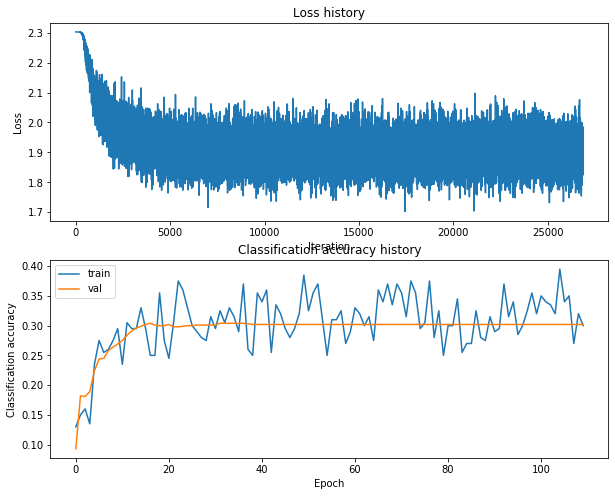

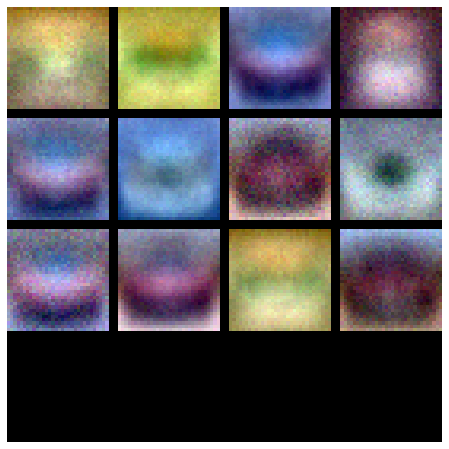










50it [45:48, 90.03s/it]

val accuracy: 0.302
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 38, l_r: 0.0002008259397530421, train_itrs: 1761, reg: 0.06760631007184448, l_r_decay: 0.9381366491470028
---------------------------------------------------------------------------------------
iteration 0 / 1761: loss 2.302677
iteration 100 / 1761: loss 2.299091
iteration 200 / 1761: loss 2.169019
iteration 300 / 1761: loss 2.138149
iteration 400 / 1761: loss 2.020202
iteration 500 / 1761: loss 1.843477
iteration 600 / 1761: loss 1.869469
iteration 700 / 1761: loss 1.843497
iteration 800 / 1761: loss 1.931654
iteration 900 / 1761: loss 1.774052
iteration 1000 / 1761: loss 1.817449
iteration 1100 / 1761: loss 1.748050
iteration 1200 / 1761: loss 1.853888
iteration 1300 / 1761: loss 1.700383
iteration 1400 / 1761: loss 1.713315
iteration 1500 / 1761: loss 1.601653
iteration 1600 / 1761: loss 1.766

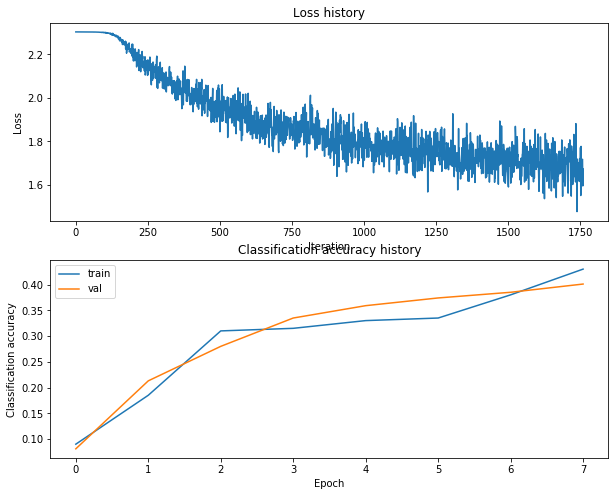

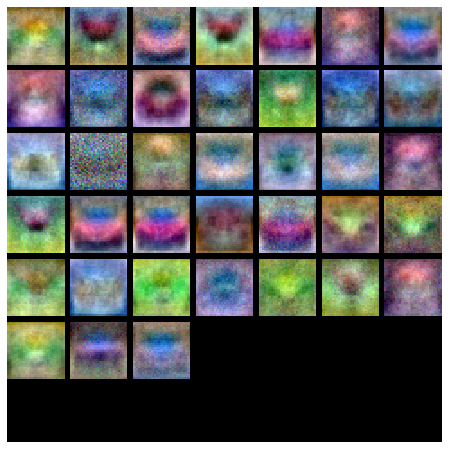










51it [46:00, 66.35s/it]

val accuracy: 0.412
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 49, l_r: 1.3194448736053725e-05, train_itrs: 7068, reg: 0.002575875116837315, l_r_decay: 0.9582099044790906
---------------------------------------------------------------------------------------
iteration 0 / 7068: loss 2.302600
iteration 100 / 7068: loss 2.302557
iteration 200 / 7068: loss 2.302520
iteration 300 / 7068: loss 2.302470
iteration 400 / 7068: loss 2.302400
iteration 500 / 7068: loss 2.302347
iteration 600 / 7068: loss 2.302341
iteration 700 / 7068: loss 2.302211
iteration 800 / 7068: loss 2.302024
iteration 900 / 7068: loss 2.301977
iteration 1000 / 7068: loss 2.301829
iteration 1100 / 7068: loss 2.301470
iteration 1200 / 7068: loss 2.300922
iteration 1300 / 7068: loss 2.300525
iteration 1400 / 7068: loss 2.300753
iteration 1500 / 7068: loss 2.300039
iteration 1600 / 7068: loss 2.2

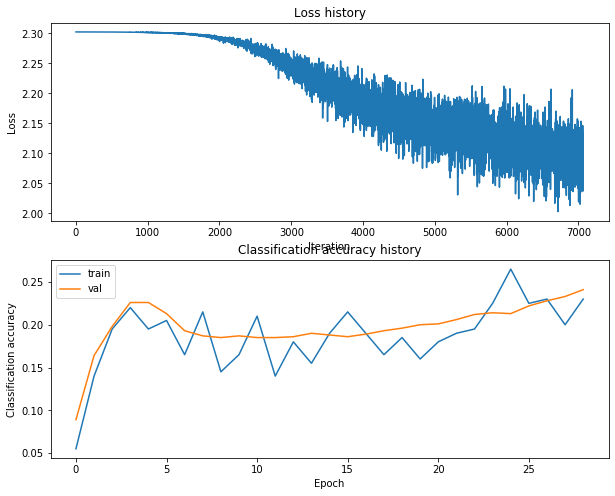

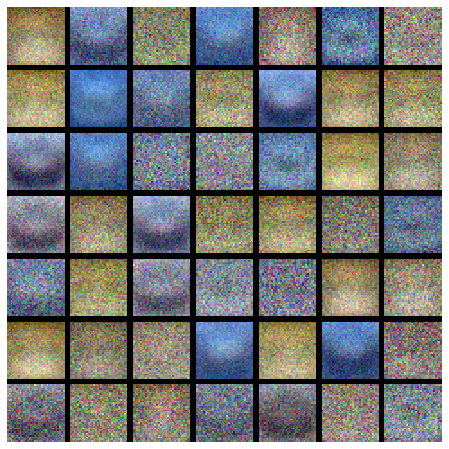










52it [46:44, 59.66s/it]

val accuracy: 0.238
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 65, l_r: 1.6366363720844152e-05, train_itrs: 26139, reg: 0.022046147122036692, l_r_decay: 0.8303724467393143
---------------------------------------------------------------------------------------
iteration 0 / 26139: loss 2.302643
iteration 100 / 26139: loss 2.302570
iteration 200 / 26139: loss 2.302591
iteration 300 / 26139: loss 2.302498
iteration 400 / 26139: loss 2.302473
iteration 500 / 26139: loss 2.302410
iteration 600 / 26139: loss 2.302290
iteration 700 / 26139: loss 2.302212
iteration 800 / 26139: loss 2.302190
iteration 900 / 26139: loss 2.302071
iteration 1000 / 26139: loss 2.301625
iteration 1100 / 26139: loss 2.301582
iteration 1200 / 26139: loss 2.301452
iteration 1300 / 26139: loss 2.301296
iteration 1400 / 26139: loss 2.301337
iteration 1500 / 26139: loss 2.300742
iteration 1600

iteration 20300 / 26139: loss 2.293772
iteration 20400 / 26139: loss 2.294339
iteration 20500 / 26139: loss 2.294162
iteration 20600 / 26139: loss 2.295489
iteration 20700 / 26139: loss 2.295131
iteration 20800 / 26139: loss 2.293588
iteration 20900 / 26139: loss 2.294930
iteration 21000 / 26139: loss 2.296155
iteration 21100 / 26139: loss 2.292595
iteration 21200 / 26139: loss 2.297244
iteration 21300 / 26139: loss 2.296894
iteration 21400 / 26139: loss 2.295505
iteration 21500 / 26139: loss 2.297851
iteration 21600 / 26139: loss 2.297598
iteration 21700 / 26139: loss 2.296680
iteration 21800 / 26139: loss 2.295100
iteration 21900 / 26139: loss 2.295065
iteration 22000 / 26139: loss 2.296738
iteration 22100 / 26139: loss 2.296739
iteration 22200 / 26139: loss 2.296896
iteration 22300 / 26139: loss 2.297158
iteration 22400 / 26139: loss 2.294147
iteration 22500 / 26139: loss 2.293519
iteration 22600 / 26139: loss 2.294923
iteration 22700 / 26139: loss 2.297274
iteration 22800 / 26139: 

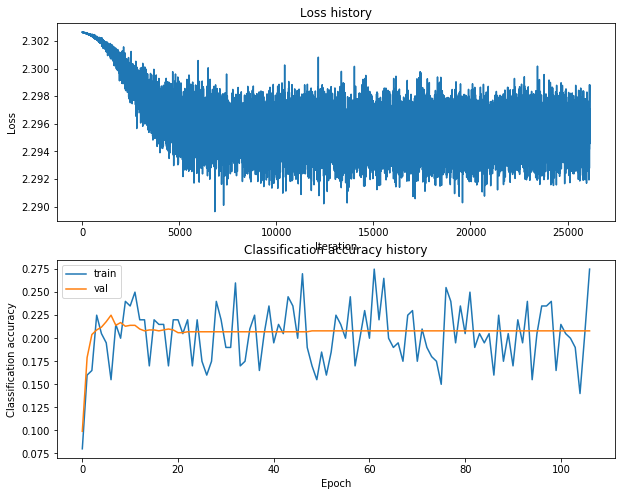

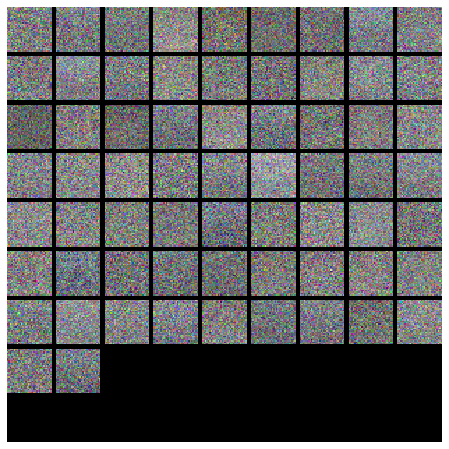










53it [50:11, 104.02s/it]

val accuracy: 0.208
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 24, l_r: 1.140937306162045e-05, train_itrs: 3051, reg: 0.006887106783967385, l_r_decay: 0.9586601495605556
---------------------------------------------------------------------------------------
iteration 0 / 3051: loss 2.302589
iteration 100 / 3051: loss 2.302570
iteration 200 / 3051: loss 2.302562
iteration 300 / 3051: loss 2.302555
iteration 400 / 3051: loss 2.302535
iteration 500 / 3051: loss 2.302541
iteration 600 / 3051: loss 2.302496
iteration 700 / 3051: loss 2.302465
iteration 800 / 3051: loss 2.302442
iteration 900 / 3051: loss 2.302401
iteration 1000 / 3051: loss 2.302322
iteration 1100 / 3051: loss 2.302261
iteration 1200 / 3051: loss 2.302093
iteration 1300 / 3051: loss 2.302111
iteration 1400 / 3051: loss 2.301902
iteration 1500 / 3051: loss 2.301646
iteration 1600 / 3051: loss 2.30

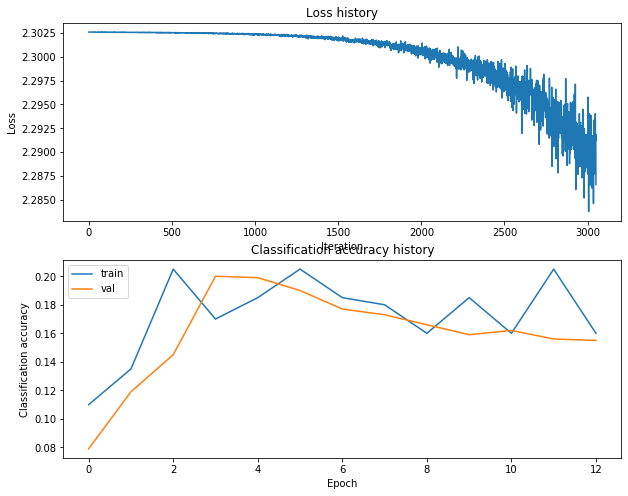

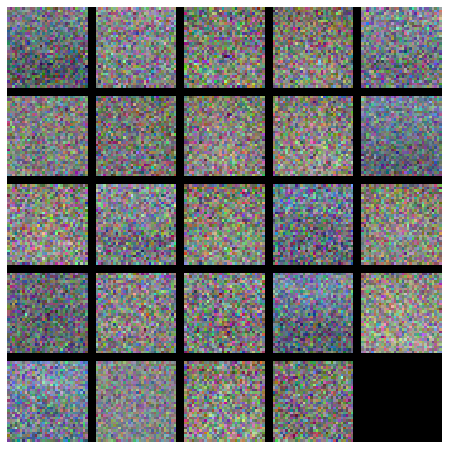










54it [50:31, 78.79s/it] 

val accuracy: 0.154
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 8, l_r: 1.0572211260918156e-05, train_itrs: 20898, reg: 0.03734029718381452, l_r_decay: 0.845502034572587
---------------------------------------------------------------------------------------
iteration 0 / 20898: loss 2.302601
iteration 100 / 20898: loss 2.302597
iteration 200 / 20898: loss 2.302590
iteration 300 / 20898: loss 2.302581
iteration 400 / 20898: loss 2.302582
iteration 500 / 20898: loss 2.302572
iteration 600 / 20898: loss 2.302562
iteration 700 / 20898: loss 2.302569
iteration 800 / 20898: loss 2.302546
iteration 900 / 20898: loss 2.302550
iteration 1000 / 20898: loss 2.302542
iteration 1100 / 20898: loss 2.302531
iteration 1200 / 20898: loss 2.302512
iteration 1300 / 20898: loss 2.302494
iteration 1400 / 20898: loss 2.302501
iteration 1500 / 20898: loss 2.302518
iteration 1600 / 

iteration 20400 / 20898: loss 2.302274
iteration 20500 / 20898: loss 2.302242
iteration 20600 / 20898: loss 2.302129
iteration 20700 / 20898: loss 2.302149
iteration 20800 / 20898: loss 2.302262


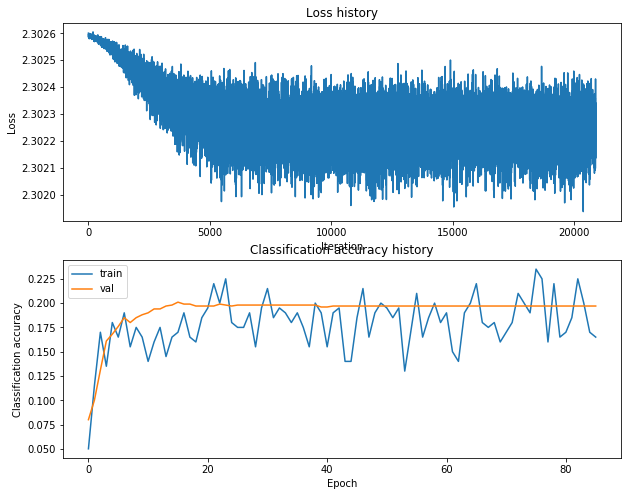

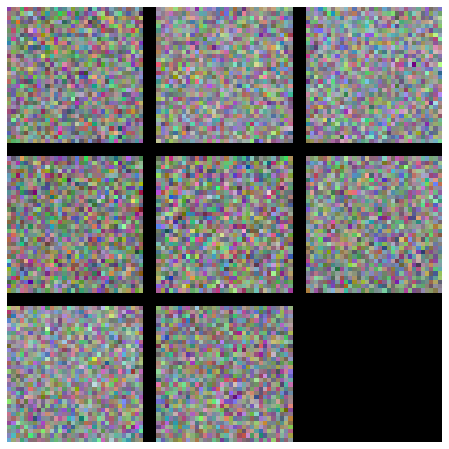










55it [51:42, 76.35s/it]

val accuracy: 0.197
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 27, l_r: 2.0906433208898485e-05, train_itrs: 1303, reg: 0.0010237927804810378, l_r_decay: 0.8576478645595993
---------------------------------------------------------------------------------------
iteration 0 / 1303: loss 2.302584
iteration 100 / 1303: loss 2.302572
iteration 200 / 1303: loss 2.302530
iteration 300 / 1303: loss 2.302490
iteration 400 / 1303: loss 2.302489
iteration 500 / 1303: loss 2.302396
iteration 600 / 1303: loss 2.302443
iteration 700 / 1303: loss 2.302273
iteration 800 / 1303: loss 2.302181
iteration 900 / 1303: loss 2.302084
iteration 1000 / 1303: loss 2.302014
iteration 1100 / 1303: loss 2.301806
iteration 1200 / 1303: loss 2.301690
iteration 1300 / 1303: loss 2.301201


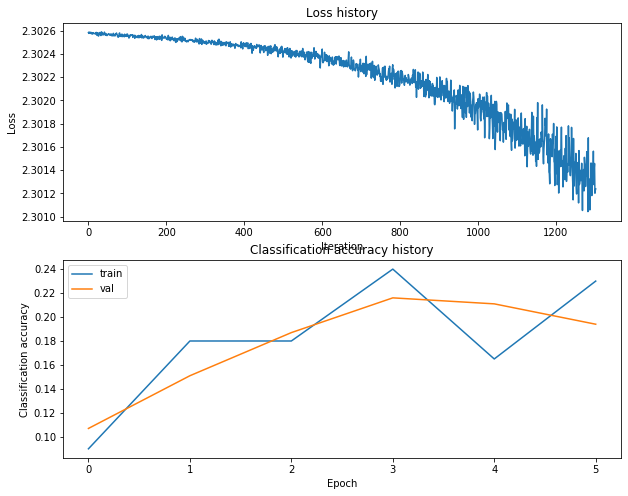

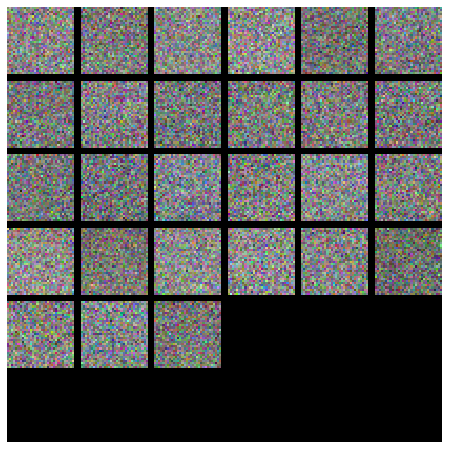










56it [51:49, 55.51s/it]

val accuracy: 0.195
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 48, l_r: 0.000270543319675751, train_itrs: 20191, reg: 0.09066975859706103, l_r_decay: 0.95943317119379
---------------------------------------------------------------------------------------
iteration 0 / 20191: loss 2.302721
iteration 100 / 20191: loss 2.265866
iteration 200 / 20191: loss 2.063577
iteration 300 / 20191: loss 1.936405
iteration 400 / 20191: loss 1.986280
iteration 500 / 20191: loss 1.942245
iteration 600 / 20191: loss 1.845437
iteration 700 / 20191: loss 1.789722
iteration 800 / 20191: loss 1.742082
iteration 900 / 20191: loss 1.709087
iteration 1000 / 20191: loss 1.636695
iteration 1100 / 20191: loss 1.820063
iteration 1200 / 20191: loss 1.586450
iteration 1300 / 20191: loss 1.698357
iteration 1400 / 20191: loss 1.570927
iteration 1500 / 20191: loss 1.496921
iteration 1600 / 20

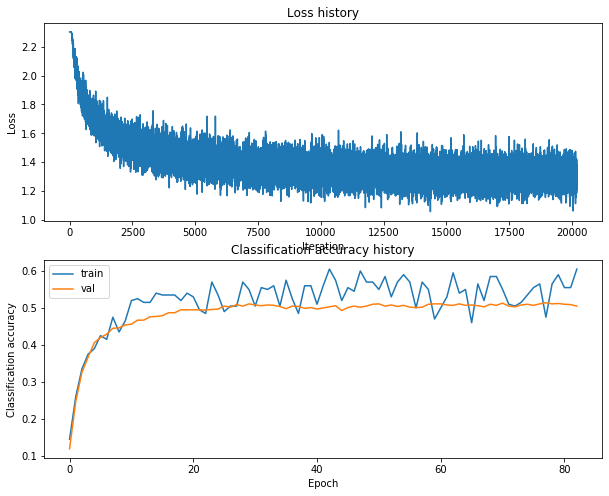

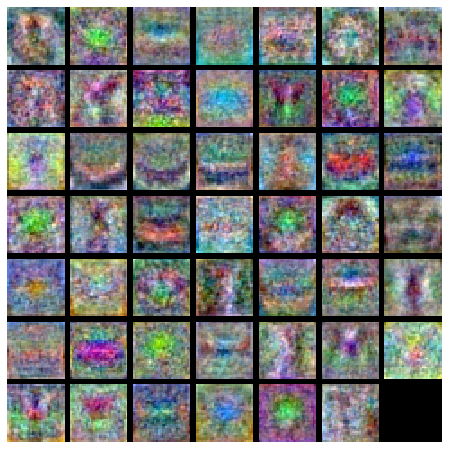










57it [53:56, 77.13s/it]

val accuracy: 0.508
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 10, l_r: 0.0003899016728263248, train_itrs: 42574, reg: 0.0024017718017371567, l_r_decay: 0.8704274417241936
---------------------------------------------------------------------------------------
iteration 0 / 42574: loss 2.302575
iteration 100 / 42574: loss 2.258701
iteration 200 / 42574: loss 2.093988
iteration 300 / 42574: loss 2.044255
iteration 400 / 42574: loss 1.882393
iteration 500 / 42574: loss 1.777728
iteration 600 / 42574: loss 1.821652
iteration 700 / 42574: loss 1.807707
iteration 800 / 42574: loss 1.805162
iteration 900 / 42574: loss 1.787675
iteration 1000 / 42574: loss 1.689885
iteration 1100 / 42574: loss 1.719782
iteration 1200 / 42574: loss 1.770040
iteration 1300 / 42574: loss 1.691025
iteration 1400 / 42574: loss 1.608203
iteration 1500 / 42574: loss 1.697816
iteration 1600

iteration 20300 / 42574: loss 1.618897
iteration 20400 / 42574: loss 1.575579
iteration 20500 / 42574: loss 1.635015
iteration 20600 / 42574: loss 1.661131
iteration 20700 / 42574: loss 1.633196
iteration 20800 / 42574: loss 1.693628
iteration 20900 / 42574: loss 1.631700
iteration 21000 / 42574: loss 1.661696
iteration 21100 / 42574: loss 1.686496
iteration 21200 / 42574: loss 1.601933
iteration 21300 / 42574: loss 1.615035
iteration 21400 / 42574: loss 1.504210
iteration 21500 / 42574: loss 1.701650
iteration 21600 / 42574: loss 1.583967
iteration 21700 / 42574: loss 1.622226
iteration 21800 / 42574: loss 1.726166
iteration 21900 / 42574: loss 1.479396
iteration 22000 / 42574: loss 1.668840
iteration 22100 / 42574: loss 1.559077
iteration 22200 / 42574: loss 1.689920
iteration 22300 / 42574: loss 1.651952
iteration 22400 / 42574: loss 1.552086
iteration 22500 / 42574: loss 1.507870
iteration 22600 / 42574: loss 1.536972
iteration 22700 / 42574: loss 1.468350
iteration 22800 / 42574: 

iteration 41400 / 42574: loss 1.687443
iteration 41500 / 42574: loss 1.629787
iteration 41600 / 42574: loss 1.583712
iteration 41700 / 42574: loss 1.631098
iteration 41800 / 42574: loss 1.613726
iteration 41900 / 42574: loss 1.635821
iteration 42000 / 42574: loss 1.617974
iteration 42100 / 42574: loss 1.578028
iteration 42200 / 42574: loss 1.618164
iteration 42300 / 42574: loss 1.624735
iteration 42400 / 42574: loss 1.646804
iteration 42500 / 42574: loss 1.541509


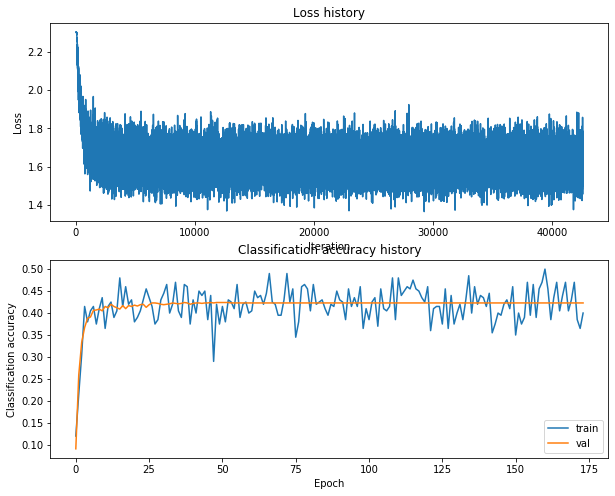

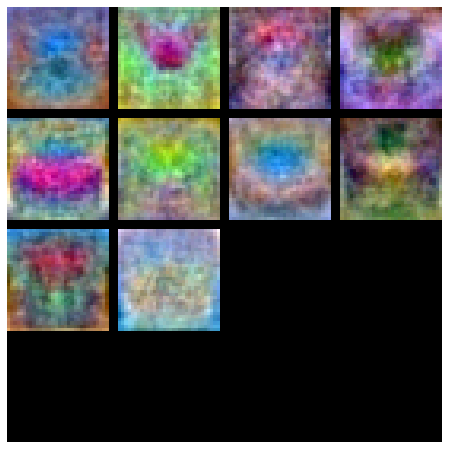










58it [56:37, 102.17s/it]

val accuracy: 0.423
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 42, l_r: 0.00047719471346725404, train_itrs: 11391, reg: 0.016655449953680346, l_r_decay: 0.8782212639135408
---------------------------------------------------------------------------------------
iteration 0 / 11391: loss 2.302618
iteration 100 / 11391: loss 2.201190
iteration 200 / 11391: loss 1.996858
iteration 300 / 11391: loss 1.939534
iteration 400 / 11391: loss 1.750157
iteration 500 / 11391: loss 1.801453
iteration 600 / 11391: loss 1.773747
iteration 700 / 11391: loss 1.817960
iteration 800 / 11391: loss 1.586807
iteration 900 / 11391: loss 1.691714
iteration 1000 / 11391: loss 1.662961
iteration 1100 / 11391: loss 1.522574
iteration 1200 / 11391: loss 1.644954
iteration 1300 / 11391: loss 1.617316
iteration 1400 / 11391: loss 1.695679
iteration 1500 / 11391: loss 1.548790
iteration 1600

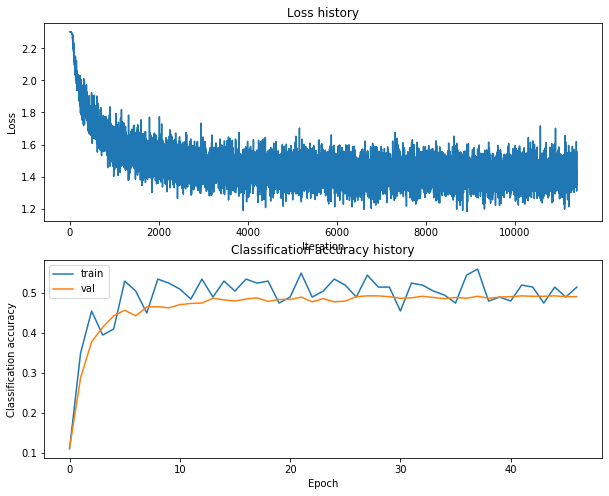

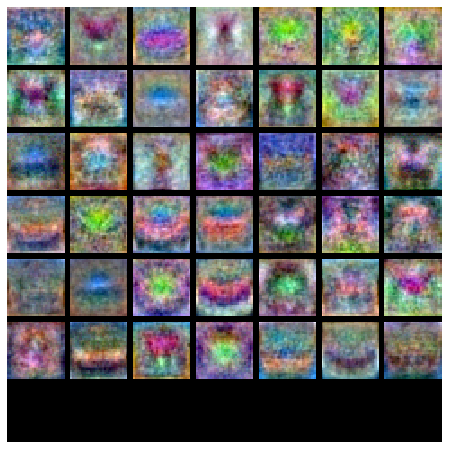










59it [57:45, 91.92s/it] 

val accuracy: 0.491
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 5, l_r: 1.896291490528096e-05, train_itrs: 704, reg: 0.005233858824766909, l_r_decay: 0.9492763172949382
---------------------------------------------------------------------------------------
iteration 0 / 704: loss 2.302585
iteration 100 / 704: loss 2.302589
iteration 200 / 704: loss 2.302580
iteration 300 / 704: loss 2.302579
iteration 400 / 704: loss 2.302582
iteration 500 / 704: loss 2.302575
iteration 600 / 704: loss 2.302567
iteration 700 / 704: loss 2.302566


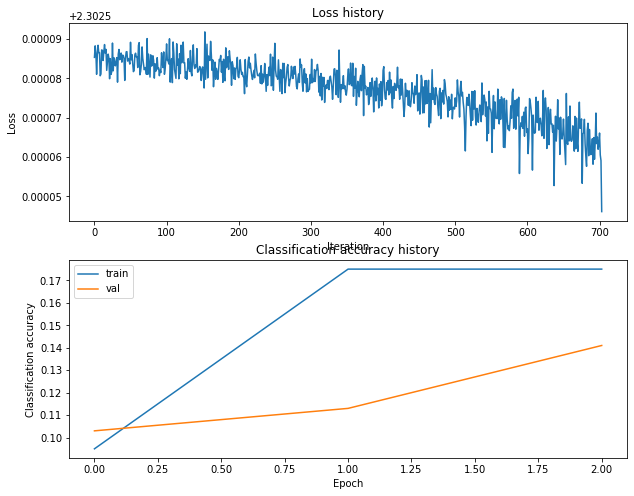

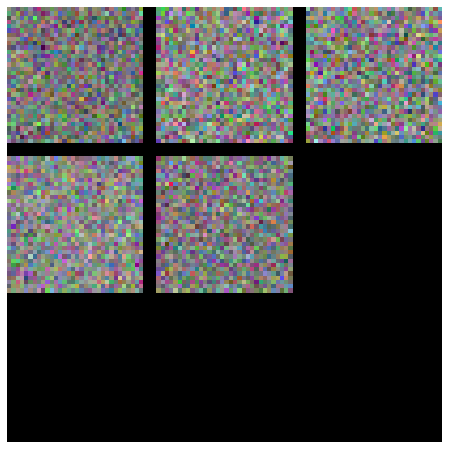










60it [57:47, 65.15s/it]

val accuracy: 0.172
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 18, l_r: 3.612310357235739e-05, train_itrs: 3200, reg: 0.0012336618659252925, l_r_decay: 0.8387800115536984
---------------------------------------------------------------------------------------
iteration 0 / 3200: loss 2.302579
iteration 100 / 3200: loss 2.302519
iteration 200 / 3200: loss 2.302466
iteration 300 / 3200: loss 2.302306
iteration 400 / 3200: loss 2.302172
iteration 500 / 3200: loss 2.301833
iteration 600 / 3200: loss 2.301571
iteration 700 / 3200: loss 2.300727
iteration 800 / 3200: loss 2.298912
iteration 900 / 3200: loss 2.297554
iteration 1000 / 3200: loss 2.294683
iteration 1100 / 3200: loss 2.293244
iteration 1200 / 3200: loss 2.288350
iteration 1300 / 3200: loss 2.265539
iteration 1400 / 3200: loss 2.262737
iteration 1500 / 3200: loss 2.271681
iteration 1600 / 3200: loss 2.2

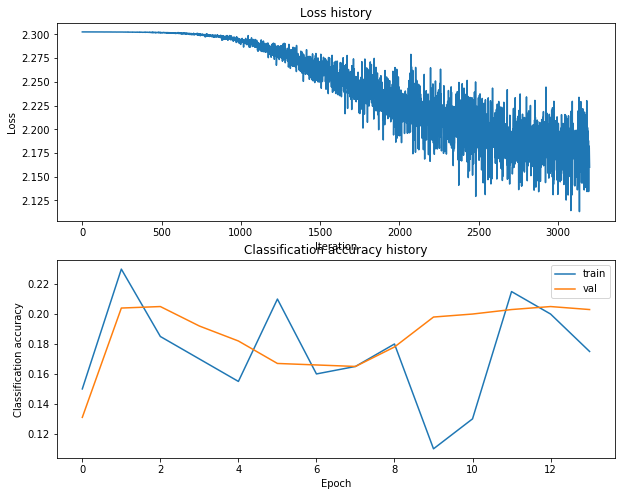

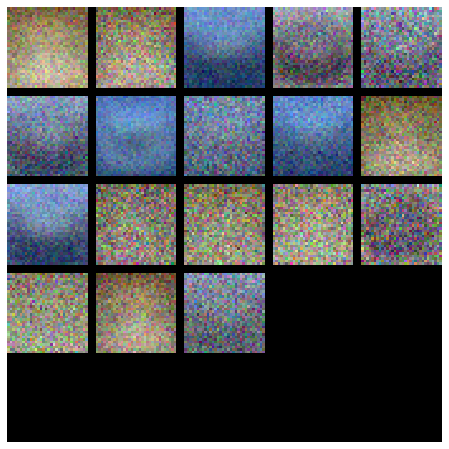










61it [58:01, 49.64s/it]

val accuracy: 0.204
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 18, l_r: 2.7443738818213942e-05, train_itrs: 4925, reg: 0.0884185056239891, l_r_decay: 0.89195999226072
---------------------------------------------------------------------------------------
iteration 0 / 4925: loss 2.302636
iteration 100 / 4925: loss 2.302619
iteration 200 / 4925: loss 2.302610
iteration 300 / 4925: loss 2.302557
iteration 400 / 4925: loss 2.302550
iteration 500 / 4925: loss 2.302415
iteration 600 / 4925: loss 2.302291
iteration 700 / 4925: loss 2.302143
iteration 800 / 4925: loss 2.301924
iteration 900 / 4925: loss 2.301241
iteration 1000 / 4925: loss 2.300452
iteration 1100 / 4925: loss 2.299946
iteration 1200 / 4925: loss 2.299465
iteration 1300 / 4925: loss 2.296961
iteration 1400 / 4925: loss 2.294613
iteration 1500 / 4925: loss 2.293410
iteration 1600 / 4925: loss 2.28627

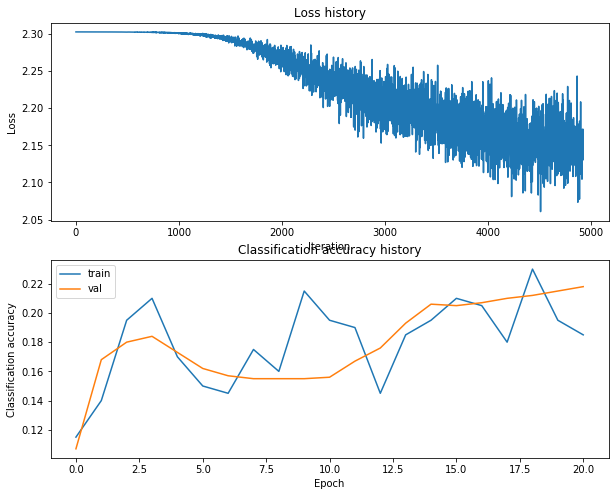

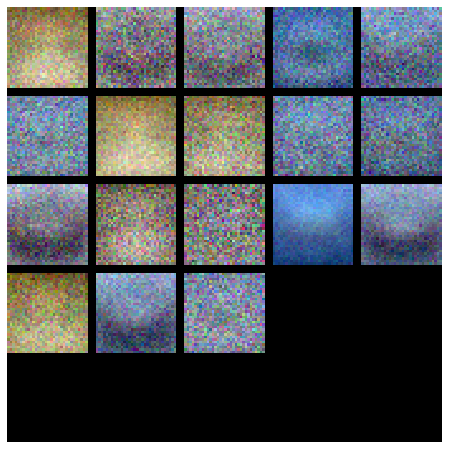










62it [58:22, 41.07s/it]

val accuracy: 0.219
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 14, l_r: 5.031102317508501e-05, train_itrs: 1137, reg: 0.013372592077341703, l_r_decay: 0.9199941972603678
---------------------------------------------------------------------------------------
iteration 0 / 1137: loss 2.302603
iteration 100 / 1137: loss 2.302563
iteration 200 / 1137: loss 2.302452
iteration 300 / 1137: loss 2.302185
iteration 400 / 1137: loss 2.301158
iteration 500 / 1137: loss 2.300066
iteration 600 / 1137: loss 2.290761
iteration 700 / 1137: loss 2.277442
iteration 800 / 1137: loss 2.262748
iteration 900 / 1137: loss 2.243450
iteration 1000 / 1137: loss 2.192857
iteration 1100 / 1137: loss 2.182965


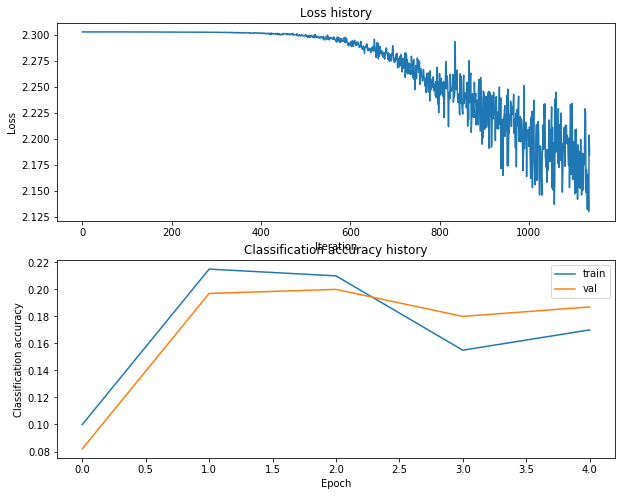

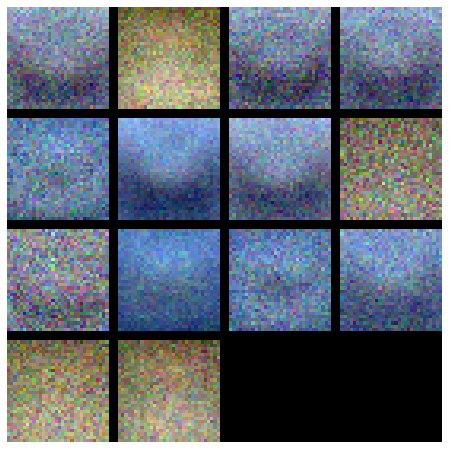










63it [58:27, 30.16s/it]

val accuracy: 0.21
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 6, l_r: 4.398243822601297e-05, train_itrs: 6030, reg: 0.0013471911646400962, l_r_decay: 0.8369000666661218
---------------------------------------------------------------------------------------
iteration 0 / 6030: loss 2.302580
iteration 100 / 6030: loss 2.302583
iteration 200 / 6030: loss 2.302562
iteration 300 / 6030: loss 2.302544
iteration 400 / 6030: loss 2.302532
iteration 500 / 6030: loss 2.302397
iteration 600 / 6030: loss 2.302316
iteration 700 / 6030: loss 2.302207
iteration 800 / 6030: loss 2.301739
iteration 900 / 6030: loss 2.301143
iteration 1000 / 6030: loss 2.300361
iteration 1100 / 6030: loss 2.299239
iteration 1200 / 6030: loss 2.300216
iteration 1300 / 6030: loss 2.296726
iteration 1400 / 6030: loss 2.297538
iteration 1500 / 6030: loss 2.294495
iteration 1600 / 6030: loss 2.287

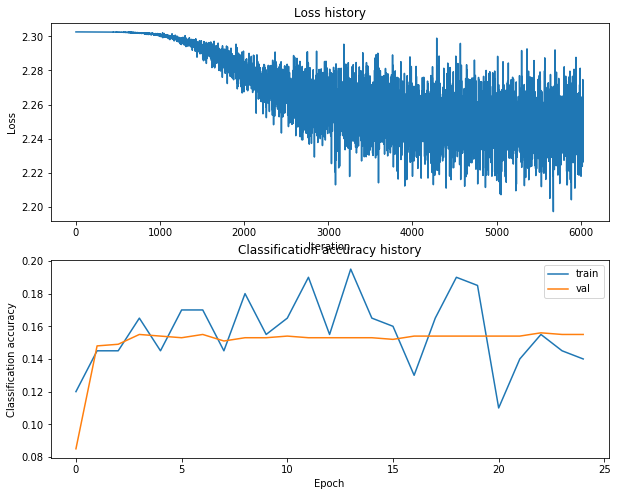

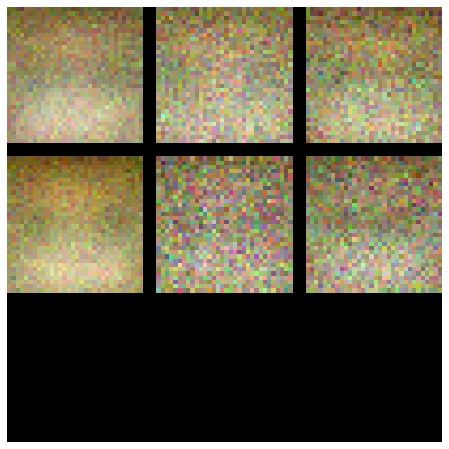










64it [58:47, 27.31s/it]

val accuracy: 0.155
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 29, l_r: 3.867776232168197e-05, train_itrs: 2224, reg: 0.0040687075011544005, l_r_decay: 0.9766395492688972
---------------------------------------------------------------------------------------
iteration 0 / 2224: loss 2.302600
iteration 100 / 2224: loss 2.302530
iteration 200 / 2224: loss 2.302435
iteration 300 / 2224: loss 2.302143
iteration 400 / 2224: loss 2.301774
iteration 500 / 2224: loss 2.300089
iteration 600 / 2224: loss 2.292770
iteration 700 / 2224: loss 2.287696
iteration 800 / 2224: loss 2.270688
iteration 900 / 2224: loss 2.251732
iteration 1000 / 2224: loss 2.186923
iteration 1100 / 2224: loss 2.195653
iteration 1200 / 2224: loss 2.182088
iteration 1300 / 2224: loss 2.073805
iteration 1400 / 2224: loss 2.108890
iteration 1500 / 2224: loss 2.127013
iteration 1600 / 2224: loss 2.1

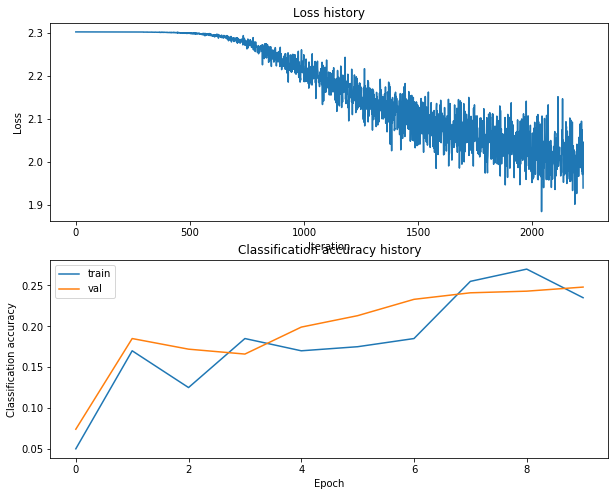

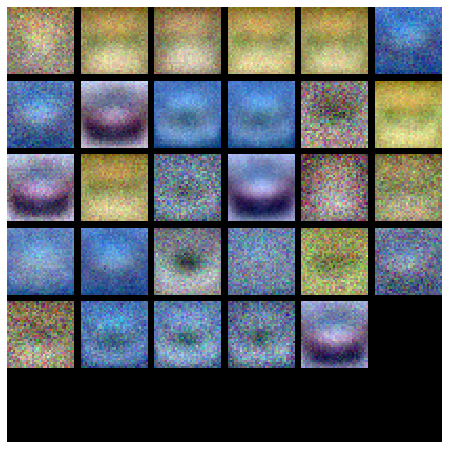










65it [58:59, 22.54s/it]

val accuracy: 0.251
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 9, l_r: 0.00018241185951814817, train_itrs: 4692, reg: 0.0696184559419063, l_r_decay: 0.9534965321518662
---------------------------------------------------------------------------------------
iteration 0 / 4692: loss 2.302606
iteration 100 / 4692: loss 2.301977
iteration 200 / 4692: loss 2.260368
iteration 300 / 4692: loss 2.113751
iteration 400 / 4692: loss 2.049986
iteration 500 / 4692: loss 2.027538
iteration 600 / 4692: loss 1.980983
iteration 700 / 4692: loss 1.943347
iteration 800 / 4692: loss 1.839153
iteration 900 / 4692: loss 1.784056
iteration 1000 / 4692: loss 1.828752
iteration 1100 / 4692: loss 1.762479
iteration 1200 / 4692: loss 1.792327
iteration 1300 / 4692: loss 1.896710
iteration 1400 / 4692: loss 1.771346
iteration 1500 / 4692: loss 1.746323
iteration 1600 / 4692: loss 1.7642

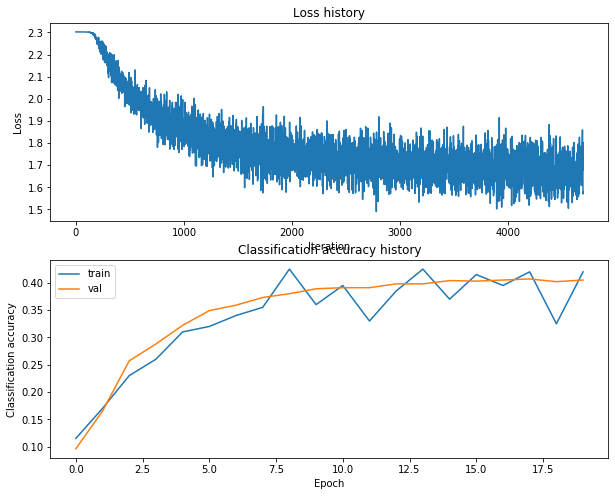

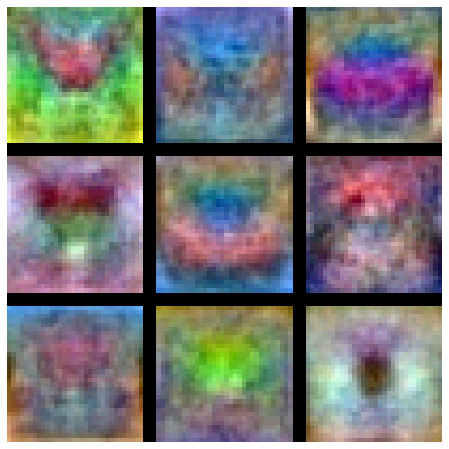










66it [59:15, 20.77s/it]

val accuracy: 0.407
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 10, l_r: 0.000868308864665399, train_itrs: 998, reg: 0.026650440401781765, l_r_decay: 0.8350191545751817
---------------------------------------------------------------------------------------
iteration 0 / 998: loss 2.302604
iteration 100 / 998: loss 2.097488
iteration 200 / 998: loss 1.886050
iteration 300 / 998: loss 1.814483
iteration 400 / 998: loss 1.826340
iteration 500 / 998: loss 1.677265
iteration 600 / 998: loss 1.708242
iteration 700 / 998: loss 1.697297
iteration 800 / 998: loss 1.654752
iteration 900 / 998: loss 1.793283


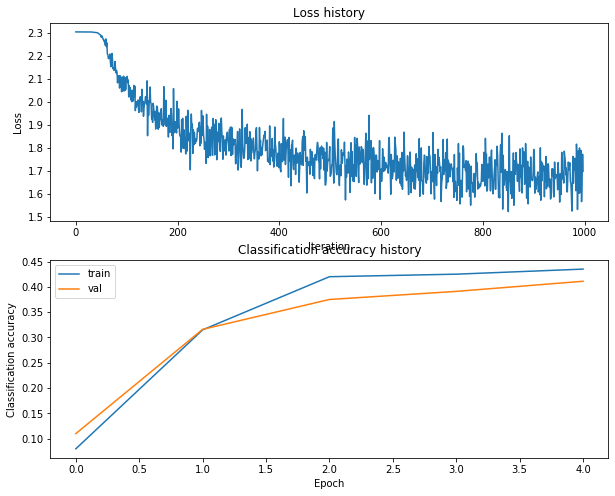

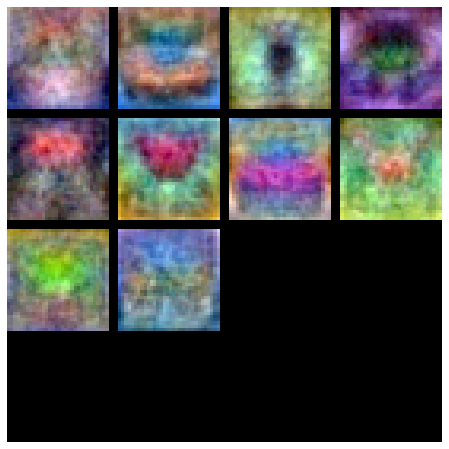










67it [59:19, 15.75s/it]

val accuracy: 0.419
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 31, l_r: 0.00039190338164661403, train_itrs: 903, reg: 0.012370346537988169, l_r_decay: 0.8535382600904506
---------------------------------------------------------------------------------------
iteration 0 / 903: loss 2.302601
iteration 100 / 903: loss 2.245065
iteration 200 / 903: loss 2.076479
iteration 300 / 903: loss 1.915881
iteration 400 / 903: loss 1.895636
iteration 500 / 903: loss 1.766611
iteration 600 / 903: loss 1.799722
iteration 700 / 903: loss 1.777354
iteration 800 / 903: loss 1.765307
iteration 900 / 903: loss 1.582580


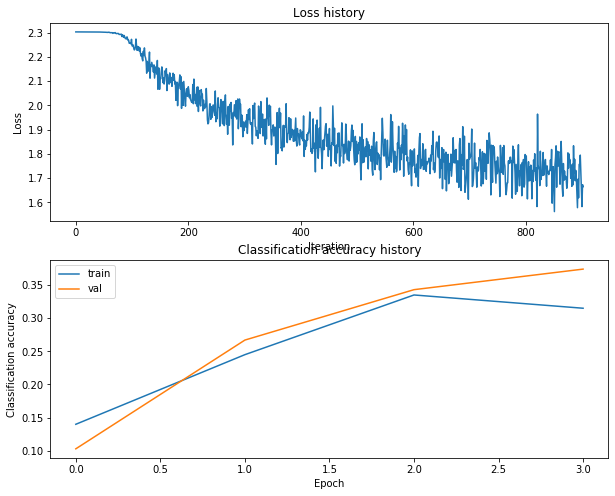

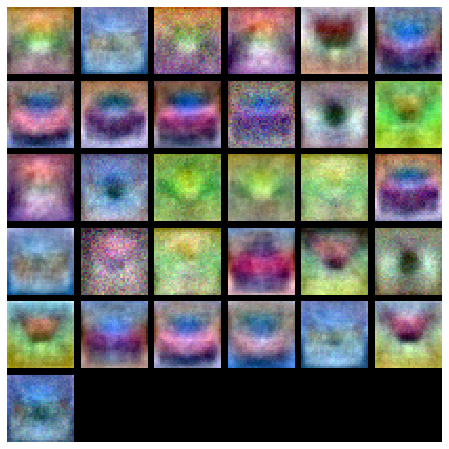










68it [59:25, 12.61s/it]

val accuracy: 0.374
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 7, l_r: 0.00014180216116490448, train_itrs: 31481, reg: 0.06348458311118316, l_r_decay: 0.9448102091919331
---------------------------------------------------------------------------------------
iteration 0 / 31481: loss 2.302601
iteration 100 / 31481: loss 2.302410
iteration 200 / 31481: loss 2.296494
iteration 300 / 31481: loss 2.265990
iteration 400 / 31481: loss 2.167725
iteration 500 / 31481: loss 2.118967
iteration 600 / 31481: loss 2.113493
iteration 700 / 31481: loss 1.993546
iteration 800 / 31481: loss 1.953359
iteration 900 / 31481: loss 1.943851
iteration 1000 / 31481: loss 1.886218
iteration 1100 / 31481: loss 1.941875
iteration 1200 / 31481: loss 1.865399
iteration 1300 / 31481: loss 1.881885
iteration 1400 / 31481: loss 1.843208
iteration 1500 / 31481: loss 1.800323
iteration 1600 /

iteration 20300 / 31481: loss 1.551542
iteration 20400 / 31481: loss 1.597465
iteration 20500 / 31481: loss 1.564763
iteration 20600 / 31481: loss 1.630287
iteration 20700 / 31481: loss 1.745340
iteration 20800 / 31481: loss 1.718431
iteration 20900 / 31481: loss 1.697985
iteration 21000 / 31481: loss 1.741875
iteration 21100 / 31481: loss 1.651542
iteration 21200 / 31481: loss 1.872910
iteration 21300 / 31481: loss 1.707114
iteration 21400 / 31481: loss 1.668675
iteration 21500 / 31481: loss 1.733894
iteration 21600 / 31481: loss 1.747149
iteration 21700 / 31481: loss 1.627019
iteration 21800 / 31481: loss 1.742522
iteration 21900 / 31481: loss 1.610452
iteration 22000 / 31481: loss 1.733962
iteration 22100 / 31481: loss 1.741830
iteration 22200 / 31481: loss 1.620612
iteration 22300 / 31481: loss 1.632243
iteration 22400 / 31481: loss 1.702066
iteration 22500 / 31481: loss 1.716884
iteration 22600 / 31481: loss 1.749459
iteration 22700 / 31481: loss 1.695885
iteration 22800 / 31481: 

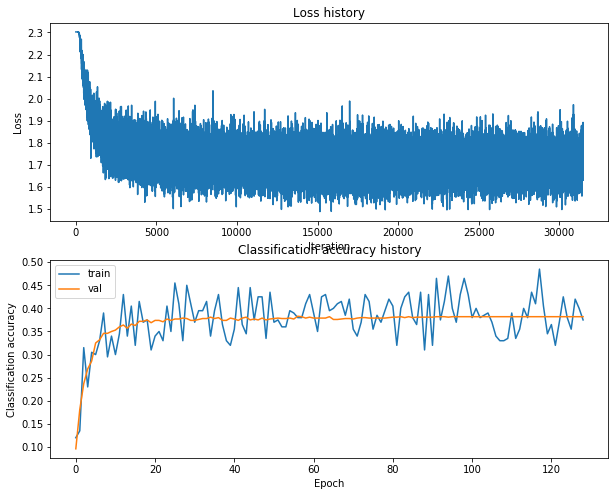

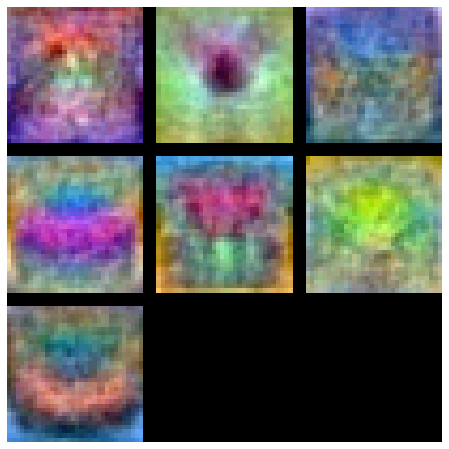










69it [1:01:25, 44.94s/it]

val accuracy: 0.382
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 22, l_r: 1.502547458113424e-05, train_itrs: 956, reg: 0.006570226285246369, l_r_decay: 0.8932657965948153
---------------------------------------------------------------------------------------
iteration 0 / 956: loss 2.302584
iteration 100 / 956: loss 2.302576
iteration 200 / 956: loss 2.302556
iteration 300 / 956: loss 2.302547
iteration 400 / 956: loss 2.302496
iteration 500 / 956: loss 2.302475
iteration 600 / 956: loss 2.302437
iteration 700 / 956: loss 2.302244
iteration 800 / 956: loss 2.302361
iteration 900 / 956: loss 2.302151


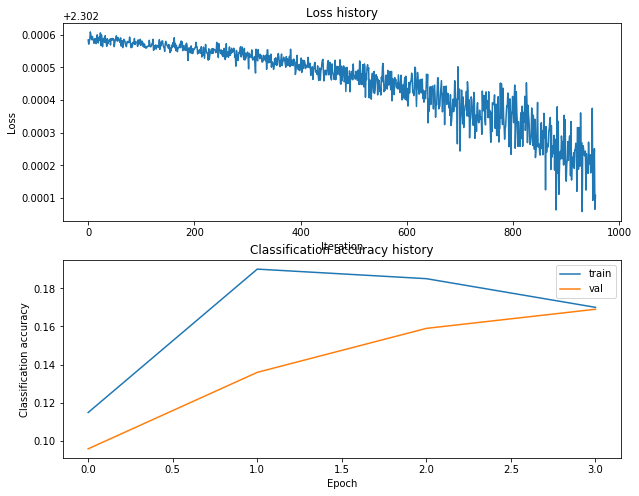

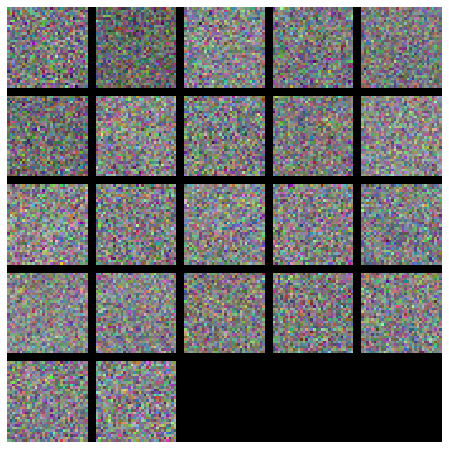










70it [1:01:30, 32.82s/it]

val accuracy: 0.171
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 71, l_r: 8.893498514098558e-05, train_itrs: 655, reg: 0.030716795771086516, l_r_decay: 0.8555809129238295
---------------------------------------------------------------------------------------
iteration 0 / 655: loss 2.302654
iteration 100 / 655: loss 2.302141
iteration 200 / 655: loss 2.300178
iteration 300 / 655: loss 2.281237
iteration 400 / 655: loss 2.254459
iteration 500 / 655: loss 2.204081
iteration 600 / 655: loss 2.134315


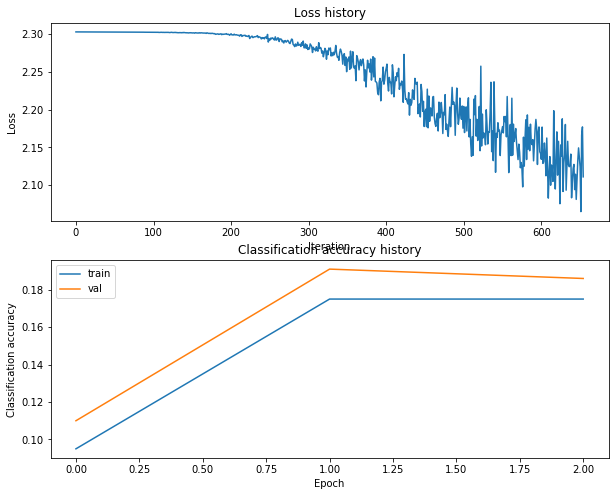

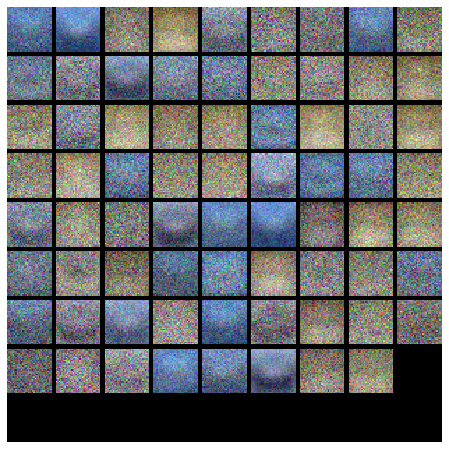










71it [1:01:35, 24.65s/it]

val accuracy: 0.217
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 11, l_r: 1.1742542694699774e-05, train_itrs: 6466, reg: 0.009598893141454682, l_r_decay: 0.9508187745238733
---------------------------------------------------------------------------------------
iteration 0 / 6466: loss 2.302585
iteration 100 / 6466: loss 2.302583
iteration 200 / 6466: loss 2.302573
iteration 300 / 6466: loss 2.302578
iteration 400 / 6466: loss 2.302565
iteration 500 / 6466: loss 2.302556
iteration 600 / 6466: loss 2.302538
iteration 700 / 6466: loss 2.302513
iteration 800 / 6466: loss 2.302523
iteration 900 / 6466: loss 2.302449
iteration 1000 / 6466: loss 2.302435
iteration 1100 / 6466: loss 2.302406
iteration 1200 / 6466: loss 2.302356
iteration 1300 / 6466: loss 2.302370
iteration 1400 / 6466: loss 2.302323
iteration 1500 / 6466: loss 2.302188
iteration 1600 / 6466: loss 2.3

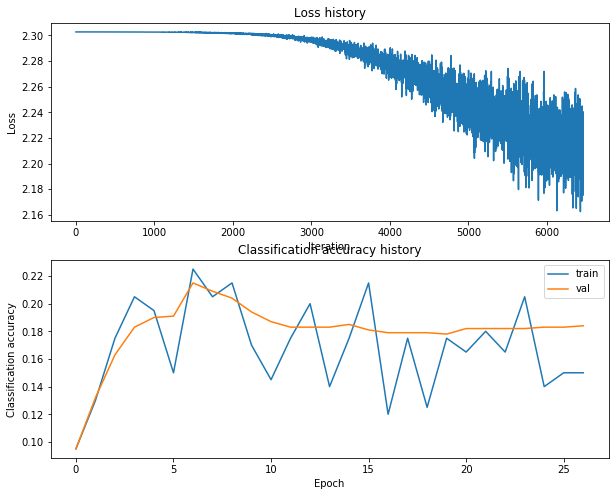

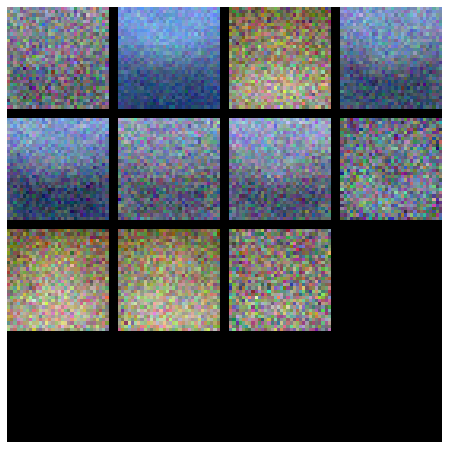










72it [1:02:00, 24.68s/it]

val accuracy: 0.184
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 45, l_r: 0.00033027323405812, train_itrs: 6621, reg: 0.009603633067268068, l_r_decay: 0.9304893213815099
---------------------------------------------------------------------------------------
iteration 0 / 6621: loss 2.302586
iteration 100 / 6621: loss 2.246091
iteration 200 / 6621: loss 2.074431
iteration 300 / 6621: loss 1.980734
iteration 400 / 6621: loss 1.942728
iteration 500 / 6621: loss 1.724722
iteration 600 / 6621: loss 1.793948
iteration 700 / 6621: loss 1.897081
iteration 800 / 6621: loss 1.779027
iteration 900 / 6621: loss 1.691374
iteration 1000 / 6621: loss 1.607858
iteration 1100 / 6621: loss 1.603738
iteration 1200 / 6621: loss 1.611616
iteration 1300 / 6621: loss 1.565722
iteration 1400 / 6621: loss 1.626503
iteration 1500 / 6621: loss 1.609014
iteration 1600 / 6621: loss 1.5888

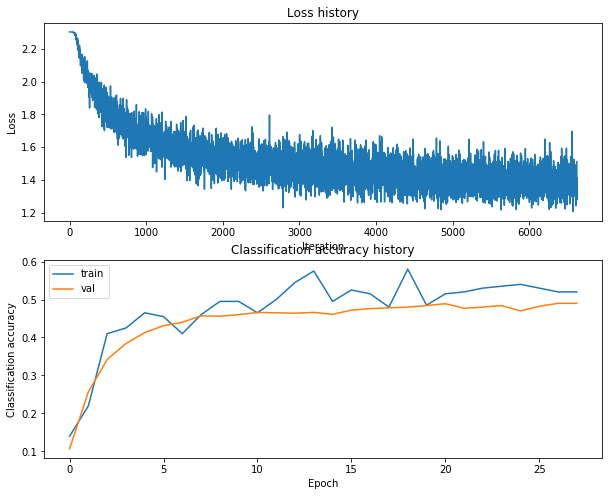

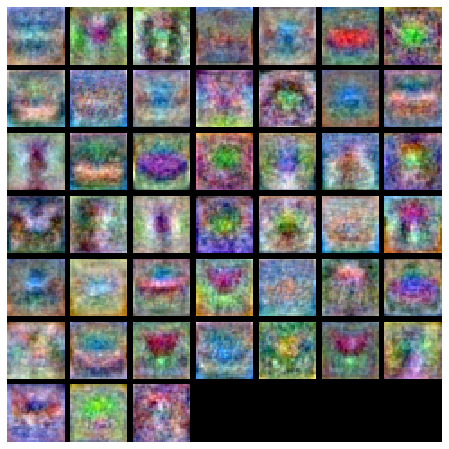










73it [1:02:40, 29.36s/it]

val accuracy: 0.489
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 24, l_r: 0.0006891587623780412, train_itrs: 804, reg: 0.04360148863355234, l_r_decay: 0.8303816771053791
---------------------------------------------------------------------------------------
iteration 0 / 804: loss 2.302614
iteration 100 / 804: loss 2.102782
iteration 200 / 804: loss 1.890584
iteration 300 / 804: loss 1.764931
iteration 400 / 804: loss 1.802728
iteration 500 / 804: loss 1.784150
iteration 600 / 804: loss 1.654018
iteration 700 / 804: loss 1.656488
iteration 800 / 804: loss 1.694301


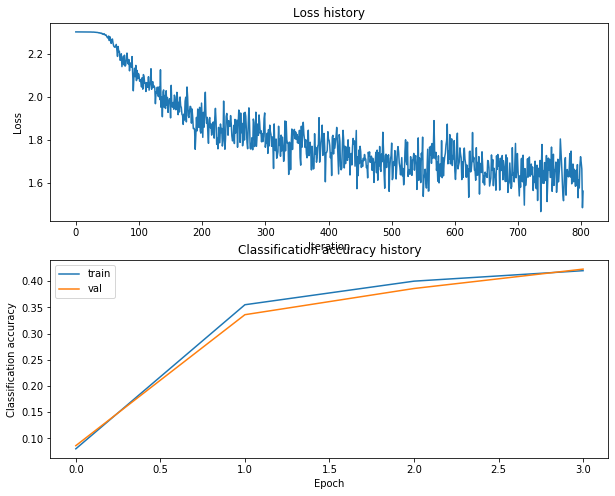

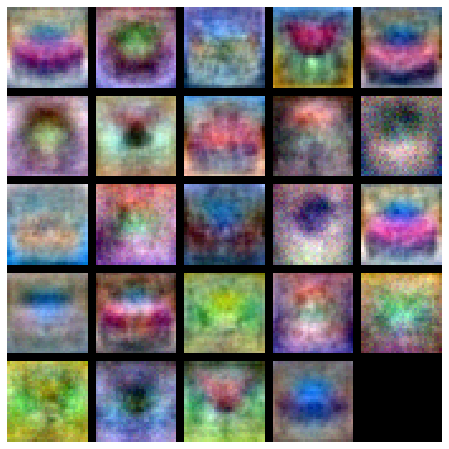










74it [1:02:44, 21.74s/it]

val accuracy: 0.423
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 31, l_r: 8.83327121419574e-05, train_itrs: 21228, reg: 0.054154041190531, l_r_decay: 0.9190414019578982
---------------------------------------------------------------------------------------
iteration 0 / 21228: loss 2.302605
iteration 100 / 21228: loss 2.302337
iteration 200 / 21228: loss 2.299696
iteration 300 / 21228: loss 2.285282
iteration 400 / 21228: loss 2.238083
iteration 500 / 21228: loss 2.169154
iteration 600 / 21228: loss 2.120296
iteration 700 / 21228: loss 2.057800
iteration 800 / 21228: loss 2.114534
iteration 900 / 21228: loss 2.020830
iteration 1000 / 21228: loss 2.020351
iteration 1100 / 21228: loss 1.955375
iteration 1200 / 21228: loss 1.876538
iteration 1300 / 21228: loss 1.961511
iteration 1400 / 21228: loss 1.959050
iteration 1500 / 21228: loss 1.918841
iteration 1600 / 21

iteration 20400 / 21228: loss 1.628745
iteration 20500 / 21228: loss 1.667193
iteration 20600 / 21228: loss 1.641299
iteration 20700 / 21228: loss 1.810576
iteration 20800 / 21228: loss 1.720424
iteration 20900 / 21228: loss 1.681062
iteration 21000 / 21228: loss 1.743997
iteration 21100 / 21228: loss 1.687693
iteration 21200 / 21228: loss 1.690525


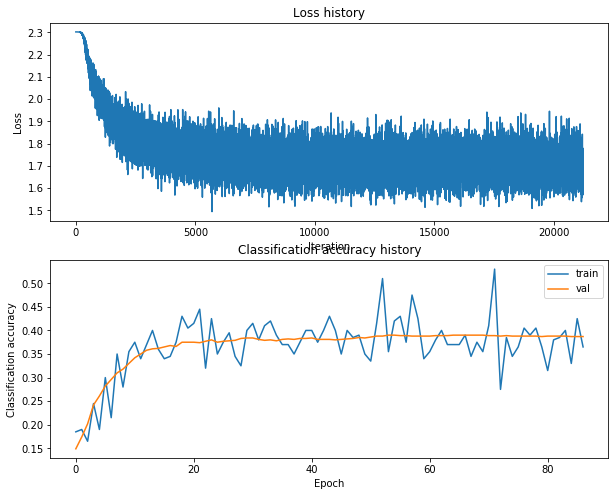

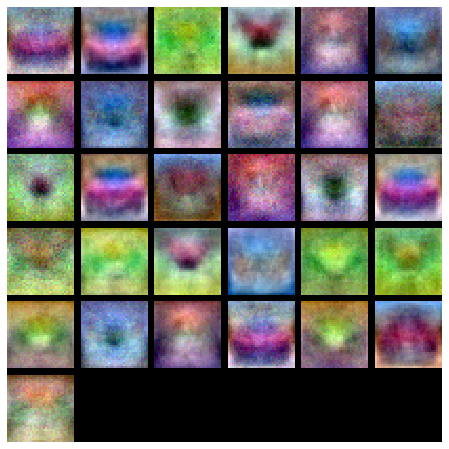










75it [1:04:36, 48.63s/it]

val accuracy: 0.387
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 43, l_r: 3.109569219521715e-05, train_itrs: 549, reg: 0.0059376010758991895, l_r_decay: 0.8935410441244643
---------------------------------------------------------------------------------------
iteration 0 / 549: loss 2.302607
iteration 100 / 549: loss 2.302544
iteration 200 / 549: loss 2.302452
iteration 300 / 549: loss 2.302361
iteration 400 / 549: loss 2.302202
iteration 500 / 549: loss 2.301875


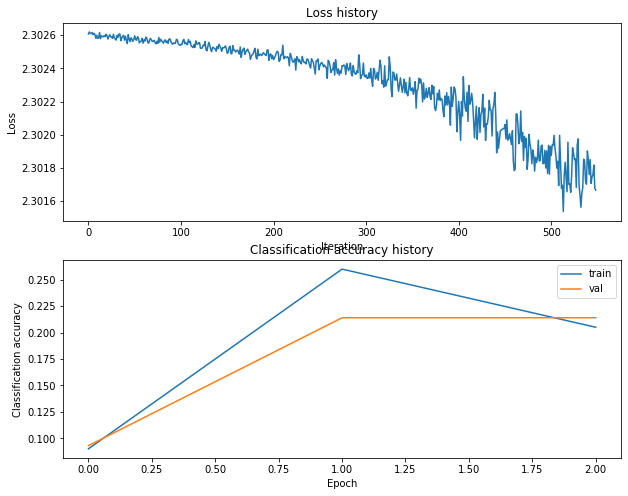

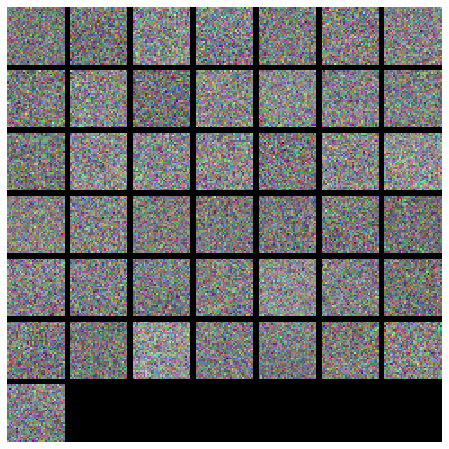










76it [1:04:39, 35.16s/it]

val accuracy: 0.219
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 66, l_r: 9.374892324185242e-05, train_itrs: 29502, reg: 0.028086171243873047, l_r_decay: 0.9343592082225137
---------------------------------------------------------------------------------------
iteration 0 / 29502: loss 2.302667
iteration 100 / 29502: loss 2.302190
iteration 200 / 29502: loss 2.298744
iteration 300 / 29502: loss 2.268850
iteration 400 / 29502: loss 2.212347
iteration 500 / 29502: loss 2.102910
iteration 600 / 29502: loss 2.106431
iteration 700 / 29502: loss 2.082822
iteration 800 / 29502: loss 1.995960
iteration 900 / 29502: loss 1.941561
iteration 1000 / 29502: loss 1.921111
iteration 1100 / 29502: loss 1.921536
iteration 1200 / 29502: loss 1.834312
iteration 1300 / 29502: loss 1.898559
iteration 1400 / 29502: loss 1.891920
iteration 1500 / 29502: loss 1.942541
iteration 1600 

iteration 20300 / 29502: loss 1.576181
iteration 20400 / 29502: loss 1.516852
iteration 20500 / 29502: loss 1.563990
iteration 20600 / 29502: loss 1.550697
iteration 20700 / 29502: loss 1.660063
iteration 20800 / 29502: loss 1.593091
iteration 20900 / 29502: loss 1.558809
iteration 21000 / 29502: loss 1.700386
iteration 21100 / 29502: loss 1.557802
iteration 21200 / 29502: loss 1.519362
iteration 21300 / 29502: loss 1.535448
iteration 21400 / 29502: loss 1.653535
iteration 21500 / 29502: loss 1.550767
iteration 21600 / 29502: loss 1.640084
iteration 21700 / 29502: loss 1.619274
iteration 21800 / 29502: loss 1.570182
iteration 21900 / 29502: loss 1.578228
iteration 22000 / 29502: loss 1.527492
iteration 22100 / 29502: loss 1.626473
iteration 22200 / 29502: loss 1.511670
iteration 22300 / 29502: loss 1.667003
iteration 22400 / 29502: loss 1.560766
iteration 22500 / 29502: loss 1.679923
iteration 22600 / 29502: loss 1.626245
iteration 22700 / 29502: loss 1.547798
iteration 22800 / 29502: 

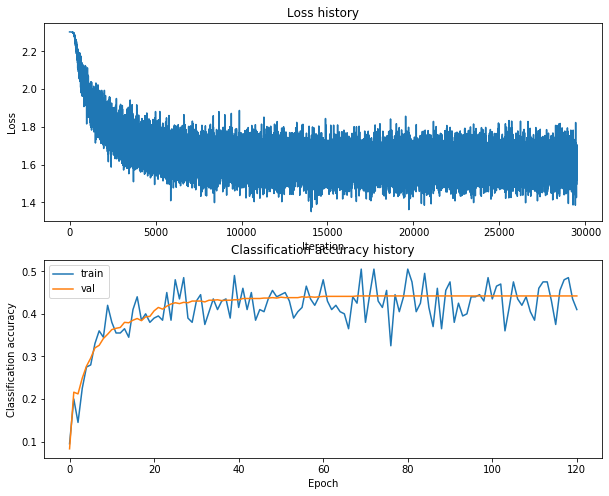

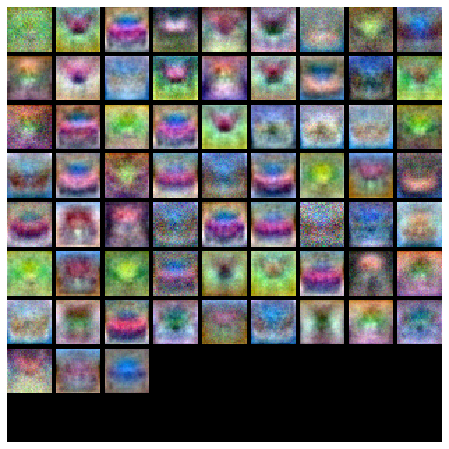










77it [1:08:21, 91.12s/it]

val accuracy: 0.442
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 49, l_r: 8.98699414182201e-05, train_itrs: 47412, reg: 0.005529921999523519, l_r_decay: 0.9606610953214554
---------------------------------------------------------------------------------------
iteration 0 / 47412: loss 2.302603
iteration 100 / 47412: loss 2.302327
iteration 200 / 47412: loss 2.300713
iteration 300 / 47412: loss 2.283649
iteration 400 / 47412: loss 2.211507
iteration 500 / 47412: loss 2.176792
iteration 600 / 47412: loss 2.114404
iteration 700 / 47412: loss 2.107153
iteration 800 / 47412: loss 2.023750
iteration 900 / 47412: loss 2.011001
iteration 1000 / 47412: loss 1.898906
iteration 1100 / 47412: loss 1.888259
iteration 1200 / 47412: loss 1.857462
iteration 1300 / 47412: loss 1.970123
iteration 1400 / 47412: loss 1.933836
iteration 1500 / 47412: loss 1.727155
iteration 1600 /

iteration 20300 / 47412: loss 1.530286
iteration 20400 / 47412: loss 1.382913
iteration 20500 / 47412: loss 1.494000
iteration 20600 / 47412: loss 1.594771
iteration 20700 / 47412: loss 1.480551
iteration 20800 / 47412: loss 1.631516
iteration 20900 / 47412: loss 1.429756
iteration 21000 / 47412: loss 1.540738
iteration 21100 / 47412: loss 1.395657
iteration 21200 / 47412: loss 1.526715
iteration 21300 / 47412: loss 1.469621
iteration 21400 / 47412: loss 1.427922
iteration 21500 / 47412: loss 1.547438
iteration 21600 / 47412: loss 1.497747
iteration 21700 / 47412: loss 1.513913
iteration 21800 / 47412: loss 1.545766
iteration 21900 / 47412: loss 1.614842
iteration 22000 / 47412: loss 1.456887
iteration 22100 / 47412: loss 1.484691
iteration 22200 / 47412: loss 1.604041
iteration 22300 / 47412: loss 1.522869
iteration 22400 / 47412: loss 1.473935
iteration 22500 / 47412: loss 1.433407
iteration 22600 / 47412: loss 1.542490
iteration 22700 / 47412: loss 1.506918
iteration 22800 / 47412: 

iteration 41400 / 47412: loss 1.474263
iteration 41500 / 47412: loss 1.473192
iteration 41600 / 47412: loss 1.438125
iteration 41700 / 47412: loss 1.437200
iteration 41800 / 47412: loss 1.436569
iteration 41900 / 47412: loss 1.414645
iteration 42000 / 47412: loss 1.433330
iteration 42100 / 47412: loss 1.534367
iteration 42200 / 47412: loss 1.533817
iteration 42300 / 47412: loss 1.505397
iteration 42400 / 47412: loss 1.519116
iteration 42500 / 47412: loss 1.487882
iteration 42600 / 47412: loss 1.452416
iteration 42700 / 47412: loss 1.530031
iteration 42800 / 47412: loss 1.395079
iteration 42900 / 47412: loss 1.444450
iteration 43000 / 47412: loss 1.554167
iteration 43100 / 47412: loss 1.493494
iteration 43200 / 47412: loss 1.520704
iteration 43300 / 47412: loss 1.405669
iteration 43400 / 47412: loss 1.444316
iteration 43500 / 47412: loss 1.466215
iteration 43600 / 47412: loss 1.411254
iteration 43700 / 47412: loss 1.463739
iteration 43800 / 47412: loss 1.477195
iteration 43900 / 47412: 

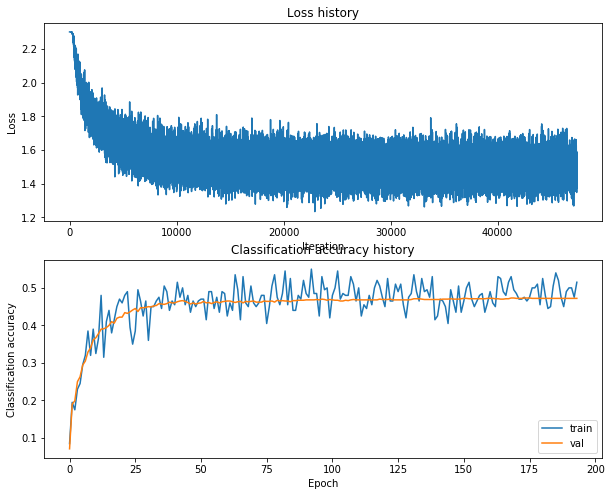

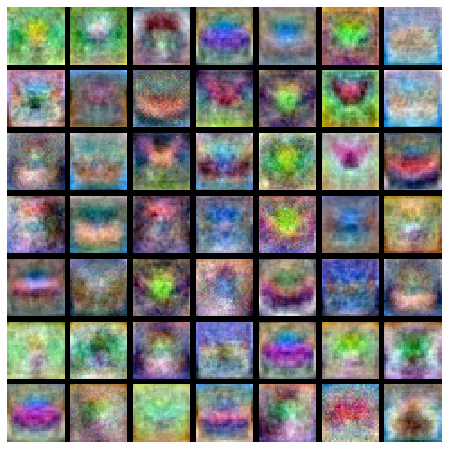










78it [1:13:53, 163.43s/it]

val accuracy: 0.472
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 7, l_r: 1.3231159407029647e-05, train_itrs: 16543, reg: 0.014929237678079183, l_r_decay: 0.8887648435972414
---------------------------------------------------------------------------------------
iteration 0 / 16543: loss 2.302593
iteration 100 / 16543: loss 2.302586
iteration 200 / 16543: loss 2.302578
iteration 300 / 16543: loss 2.302577
iteration 400 / 16543: loss 2.302574
iteration 500 / 16543: loss 2.302570
iteration 600 / 16543: loss 2.302554
iteration 700 / 16543: loss 2.302551
iteration 800 / 16543: loss 2.302536
iteration 900 / 16543: loss 2.302525
iteration 1000 / 16543: loss 2.302496
iteration 1100 / 16543: loss 2.302485
iteration 1200 / 16543: loss 2.302474
iteration 1300 / 16543: loss 2.302481
iteration 1400 / 16543: loss 2.302363
iteration 1500 / 16543: loss 2.302348
iteration 1600 

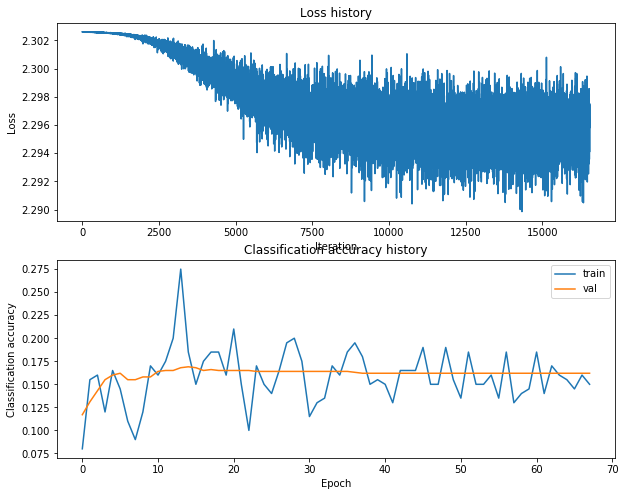

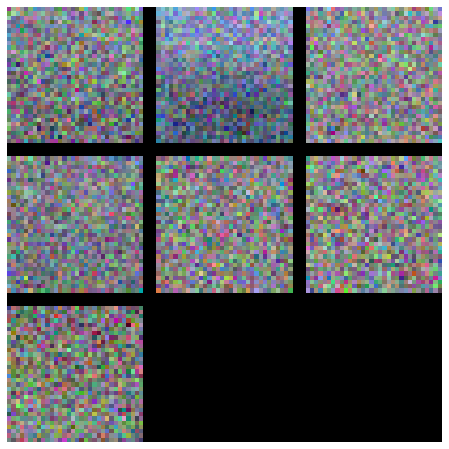










79it [1:14:52, 131.93s/it]

val accuracy: 0.162
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 14, l_r: 2.9302189514458442e-05, train_itrs: 2643, reg: 0.006819300245214166, l_r_decay: 0.8919910263596884
---------------------------------------------------------------------------------------
iteration 0 / 2643: loss 2.302591
iteration 100 / 2643: loss 2.302581
iteration 200 / 2643: loss 2.302533
iteration 300 / 2643: loss 2.302523
iteration 400 / 2643: loss 2.302453
iteration 500 / 2643: loss 2.302386
iteration 600 / 2643: loss 2.302192
iteration 700 / 2643: loss 2.301877
iteration 800 / 2643: loss 2.301079
iteration 900 / 2643: loss 2.300973
iteration 1000 / 2643: loss 2.299963
iteration 1100 / 2643: loss 2.298160
iteration 1200 / 2643: loss 2.291833
iteration 1300 / 2643: loss 2.291826
iteration 1400 / 2643: loss 2.285310
iteration 1500 / 2643: loss 2.278678
iteration 1600 / 2643: loss 2.2

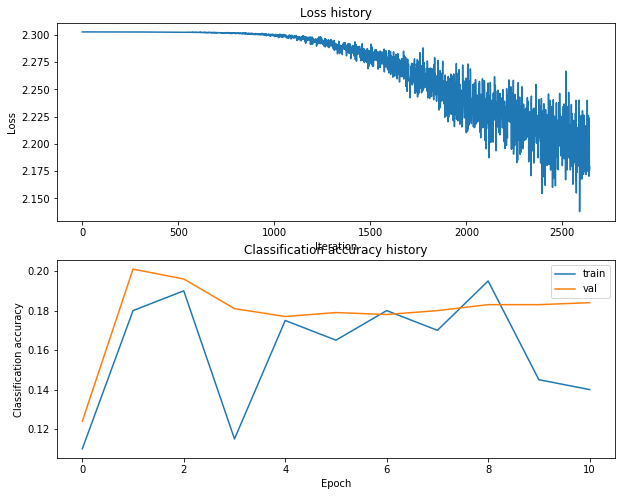

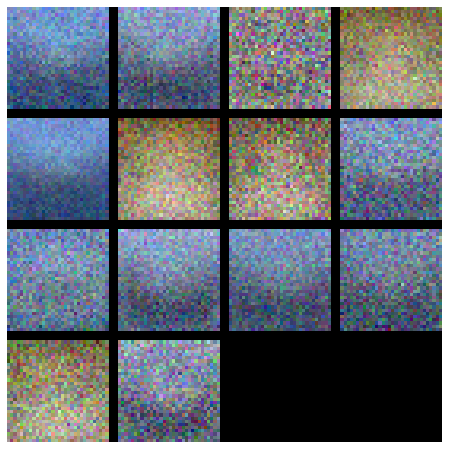










80it [1:15:03, 95.65s/it] 

val accuracy: 0.185
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 98, l_r: 0.0003112182168418934, train_itrs: 3185, reg: 0.0022041981576265525, l_r_decay: 0.8254039298558011
---------------------------------------------------------------------------------------
iteration 0 / 3185: loss 2.302627
iteration 100 / 3185: loss 2.264490
iteration 200 / 3185: loss 2.080022
iteration 300 / 3185: loss 2.001311
iteration 400 / 3185: loss 1.899648
iteration 500 / 3185: loss 1.822199
iteration 600 / 3185: loss 1.859493
iteration 700 / 3185: loss 1.777363
iteration 800 / 3185: loss 1.671848
iteration 900 / 3185: loss 1.754436
iteration 1000 / 3185: loss 1.916530
iteration 1100 / 3185: loss 1.773800
iteration 1200 / 3185: loss 1.751141
iteration 1300 / 3185: loss 1.755513
iteration 1400 / 3185: loss 1.801389
iteration 1500 / 3185: loss 1.559672
iteration 1600 / 3185: loss 1.6

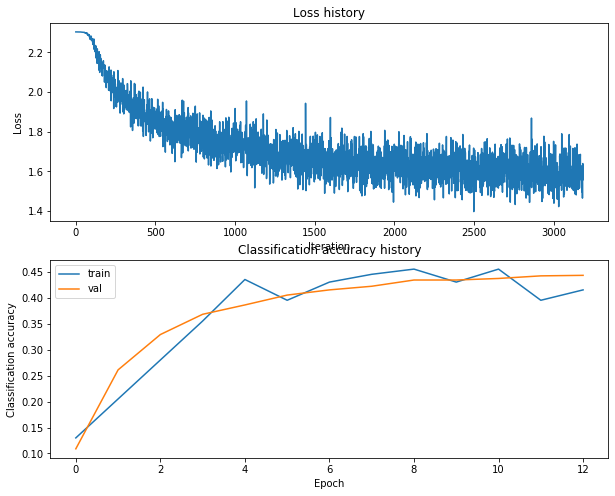

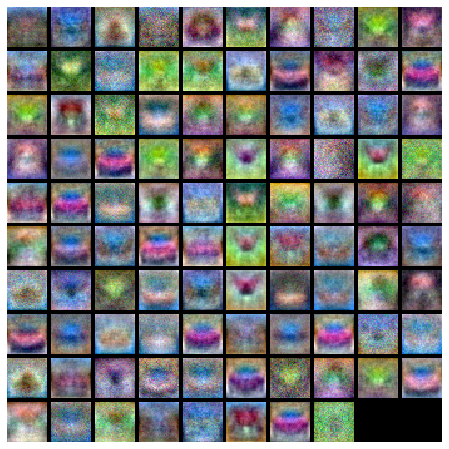










81it [1:15:34, 76.29s/it]

val accuracy: 0.445
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 95, l_r: 9.770823184534555e-05, train_itrs: 8985, reg: 0.0059922822193787684, l_r_decay: 0.971147203247963
---------------------------------------------------------------------------------------
iteration 0 / 8985: loss 2.302595
iteration 100 / 8985: loss 2.301762
iteration 200 / 8985: loss 2.292957
iteration 300 / 8985: loss 2.231281
iteration 400 / 8985: loss 2.197779
iteration 500 / 8985: loss 2.086544
iteration 600 / 8985: loss 2.055898
iteration 700 / 8985: loss 2.034590
iteration 800 / 8985: loss 1.921687
iteration 900 / 8985: loss 1.969001
iteration 1000 / 8985: loss 1.861958
iteration 1100 / 8985: loss 1.860489
iteration 1200 / 8985: loss 1.954143
iteration 1300 / 8985: loss 1.826511
iteration 1400 / 8985: loss 1.792975
iteration 1500 / 8985: loss 1.918969
iteration 1600 / 8985: loss 1.77

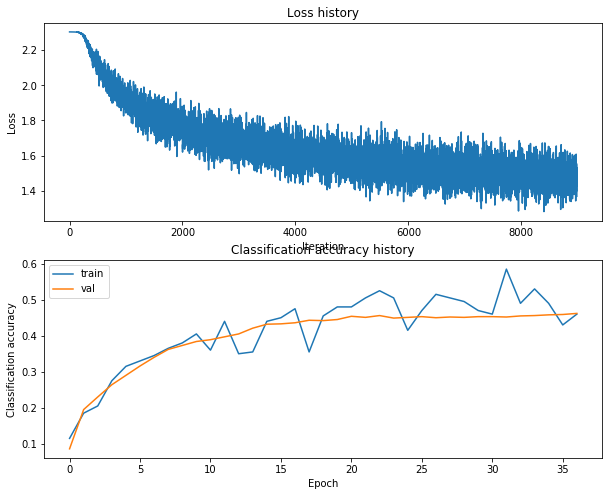

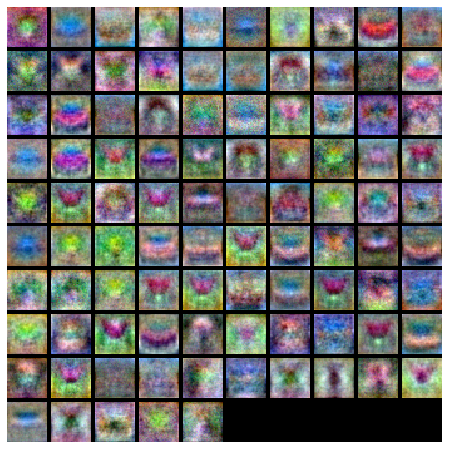










82it [1:16:59, 79.13s/it]

val accuracy: 0.462
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 76, l_r: 8.475893056307454e-05, train_itrs: 723, reg: 0.014953429507860392, l_r_decay: 0.8053428057264905
---------------------------------------------------------------------------------------
iteration 0 / 723: loss 2.302633
iteration 100 / 723: loss 2.302346
iteration 200 / 723: loss 2.300200
iteration 300 / 723: loss 2.292203
iteration 400 / 723: loss 2.273315
iteration 500 / 723: loss 2.213162
iteration 600 / 723: loss 2.211221
iteration 700 / 723: loss 2.166674


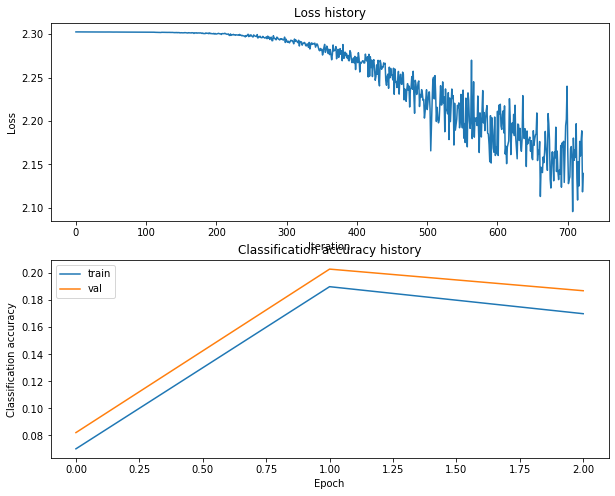

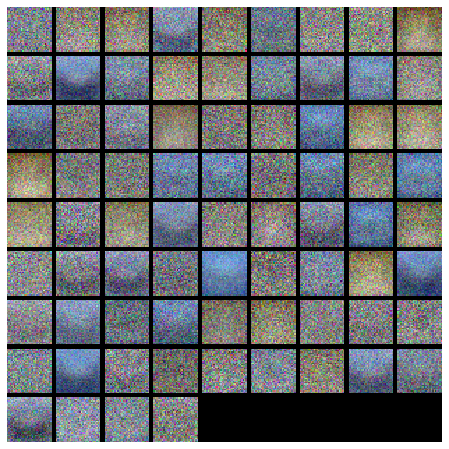










83it [1:17:06, 57.27s/it]

val accuracy: 0.209
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 25, l_r: 0.0007223696349733478, train_itrs: 7097, reg: 0.0016064941818798098, l_r_decay: 0.8777827785885622
---------------------------------------------------------------------------------------
iteration 0 / 7097: loss 2.302582
iteration 100 / 7097: loss 2.113867
iteration 200 / 7097: loss 1.937184
iteration 300 / 7097: loss 1.976033
iteration 400 / 7097: loss 1.753742
iteration 500 / 7097: loss 1.604349
iteration 600 / 7097: loss 1.604752
iteration 700 / 7097: loss 1.602971
iteration 800 / 7097: loss 1.662532
iteration 900 / 7097: loss 1.545874
iteration 1000 / 7097: loss 1.600585
iteration 1100 / 7097: loss 1.573065
iteration 1200 / 7097: loss 1.476011
iteration 1300 / 7097: loss 1.429090
iteration 1400 / 7097: loss 1.501889
iteration 1500 / 7097: loss 1.491693
iteration 1600 / 7097: loss 1.5

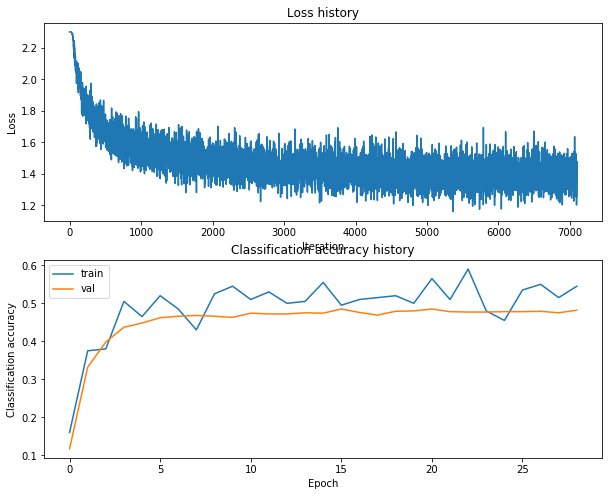

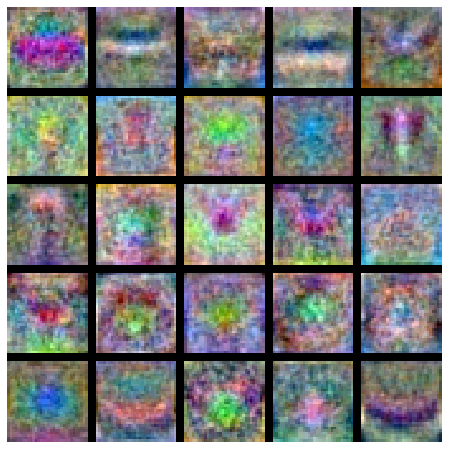










84it [1:17:38, 49.89s/it]

val accuracy: 0.481
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 93, l_r: 4.555945016133702e-05, train_itrs: 15065, reg: 0.05337235152990345, l_r_decay: 0.8623513084686798
---------------------------------------------------------------------------------------
iteration 0 / 15065: loss 2.302727
iteration 100 / 15065: loss 2.302556
iteration 200 / 15065: loss 2.302088
iteration 300 / 15065: loss 2.301568
iteration 400 / 15065: loss 2.300064
iteration 500 / 15065: loss 2.295649
iteration 600 / 15065: loss 2.295011
iteration 700 / 15065: loss 2.279687
iteration 800 / 15065: loss 2.249032
iteration 900 / 15065: loss 2.247825
iteration 1000 / 15065: loss 2.217091
iteration 1100 / 15065: loss 2.190431
iteration 1200 / 15065: loss 2.213162
iteration 1300 / 15065: loss 2.167324
iteration 1400 / 15065: loss 2.174110
iteration 1500 / 15065: loss 2.142839
iteration 1600 /

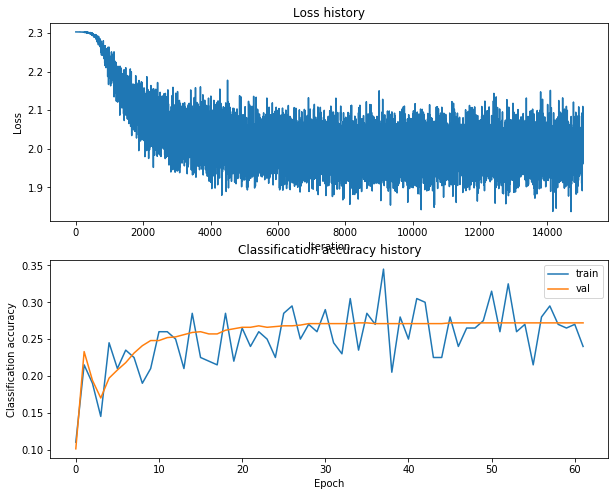

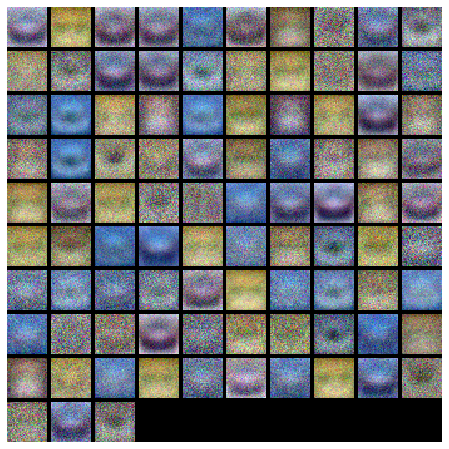










85it [1:19:59, 77.14s/it]

val accuracy: 0.272
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 43, l_r: 0.00016808140528185462, train_itrs: 847, reg: 0.0048011744600642975, l_r_decay: 0.8675998413383817
---------------------------------------------------------------------------------------
iteration 0 / 847: loss 2.302583
iteration 100 / 847: loss 2.301357
iteration 200 / 847: loss 2.256137
iteration 300 / 847: loss 2.177833
iteration 400 / 847: loss 2.081355
iteration 500 / 847: loss 2.005688
iteration 600 / 847: loss 1.990223
iteration 700 / 847: loss 1.946317
iteration 800 / 847: loss 1.922331


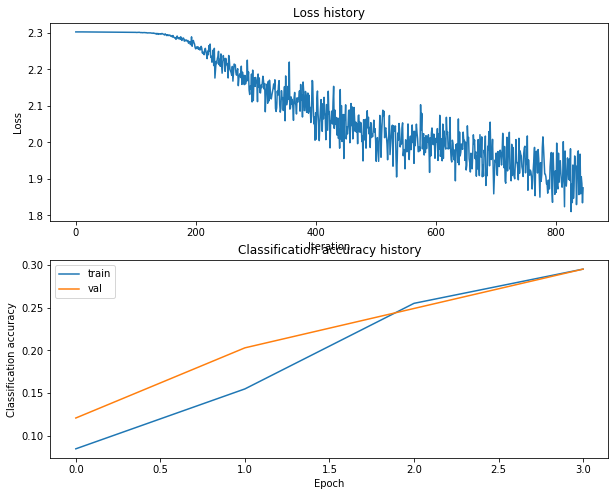

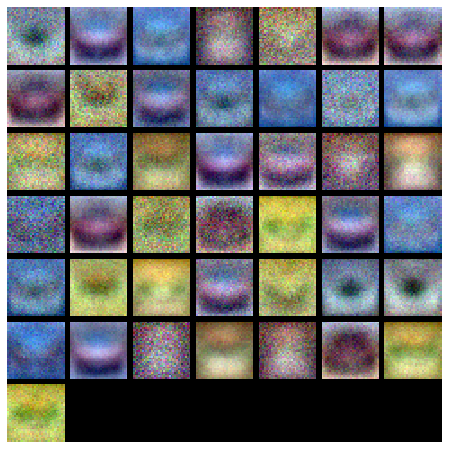










86it [1:20:05, 55.63s/it]

val accuracy: 0.308
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 48, l_r: 0.0007386687169306238, train_itrs: 7487, reg: 0.017889001520166536, l_r_decay: 0.9827431772946256
---------------------------------------------------------------------------------------
iteration 0 / 7487: loss 2.302609
iteration 100 / 7487: loss 2.040799
iteration 200 / 7487: loss 1.828689
iteration 300 / 7487: loss 1.818458
iteration 400 / 7487: loss 1.484946
iteration 500 / 7487: loss 1.592035
iteration 600 / 7487: loss 1.635732
iteration 700 / 7487: loss 1.540482
iteration 800 / 7487: loss 1.484014
iteration 900 / 7487: loss 1.577249
iteration 1000 / 7487: loss 1.407085
iteration 1100 / 7487: loss 1.502320
iteration 1200 / 7487: loss 1.507216
iteration 1300 / 7487: loss 1.540039
iteration 1400 / 7487: loss 1.423909
iteration 1500 / 7487: loss 1.546307
iteration 1600 / 7487: loss 1.36

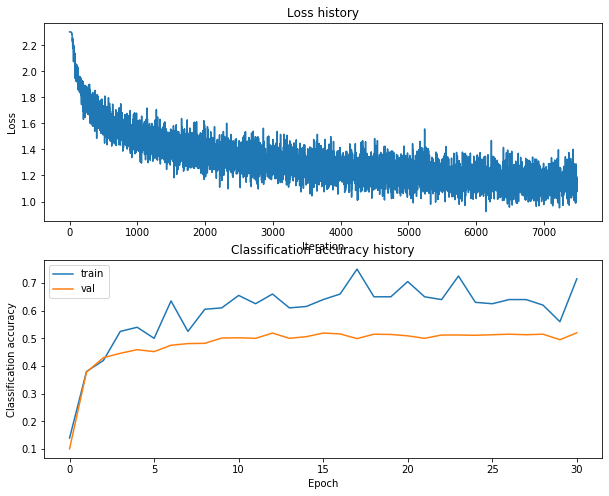

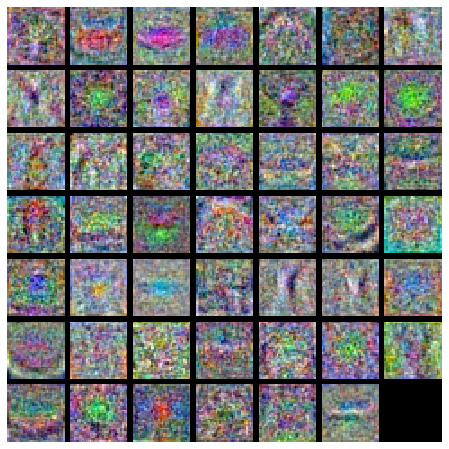










87it [1:20:49, 52.33s/it]

val accuracy: 0.518
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 64, l_r: 6.431459509954718e-05, train_itrs: 9365, reg: 0.022582631352259457, l_r_decay: 0.9553241118515331
---------------------------------------------------------------------------------------
iteration 0 / 9365: loss 2.302620
iteration 100 / 9365: loss 2.302347
iteration 200 / 9365: loss 2.301614
iteration 300 / 9365: loss 2.297048
iteration 400 / 9365: loss 2.272393
iteration 500 / 9365: loss 2.232049
iteration 600 / 9365: loss 2.209201
iteration 700 / 9365: loss 2.168172
iteration 800 / 9365: loss 2.150902
iteration 900 / 9365: loss 2.066592
iteration 1000 / 9365: loss 2.054618
iteration 1100 / 9365: loss 1.984050
iteration 1200 / 9365: loss 2.022697
iteration 1300 / 9365: loss 2.004498
iteration 1400 / 9365: loss 1.970160
iteration 1500 / 9365: loss 1.995117
iteration 1600 / 9365: loss 1.91

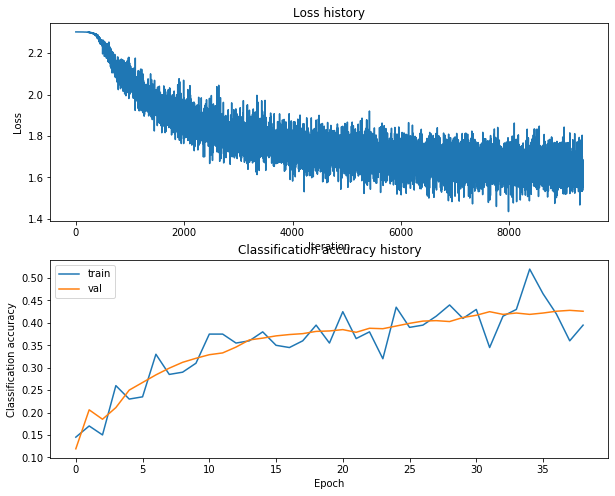

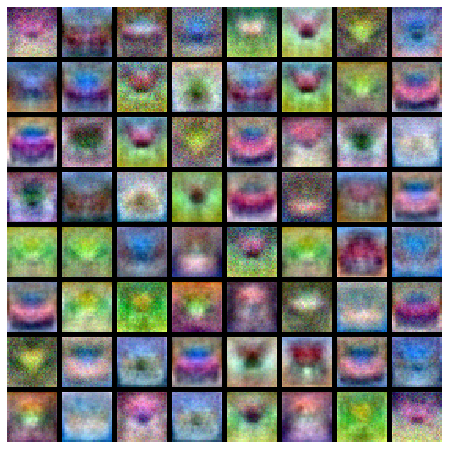










88it [1:21:57, 56.91s/it]

val accuracy: 0.432
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 51, l_r: 2.5523261197435875e-05, train_itrs: 1127, reg: 0.02218435353326411, l_r_decay: 0.9154373302332266
---------------------------------------------------------------------------------------
iteration 0 / 1127: loss 2.302639
iteration 100 / 1127: loss 2.302602
iteration 200 / 1127: loss 2.302579
iteration 300 / 1127: loss 2.302479
iteration 400 / 1127: loss 2.302414
iteration 500 / 1127: loss 2.302252
iteration 600 / 1127: loss 2.301987
iteration 700 / 1127: loss 2.301776
iteration 800 / 1127: loss 2.301598
iteration 900 / 1127: loss 2.300579
iteration 1000 / 1127: loss 2.299362
iteration 1100 / 1127: loss 2.298464


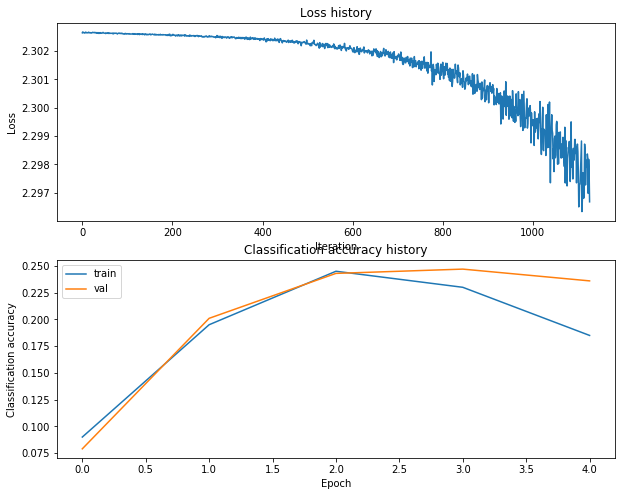

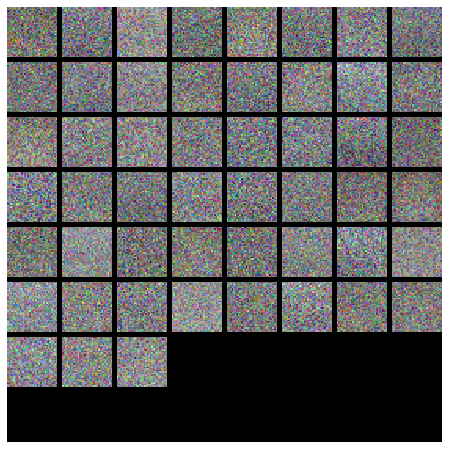










89it [1:22:04, 42.13s/it]

val accuracy: 0.217
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 22, l_r: 6.246419326248073e-05, train_itrs: 754, reg: 0.008867547129314037, l_r_decay: 0.9144300528950906
---------------------------------------------------------------------------------------
iteration 0 / 754: loss 2.302603
iteration 100 / 754: loss 2.302512
iteration 200 / 754: loss 2.302269
iteration 300 / 754: loss 2.301243
iteration 400 / 754: loss 2.297556
iteration 500 / 754: loss 2.279279
iteration 600 / 754: loss 2.267292
iteration 700 / 754: loss 2.207213


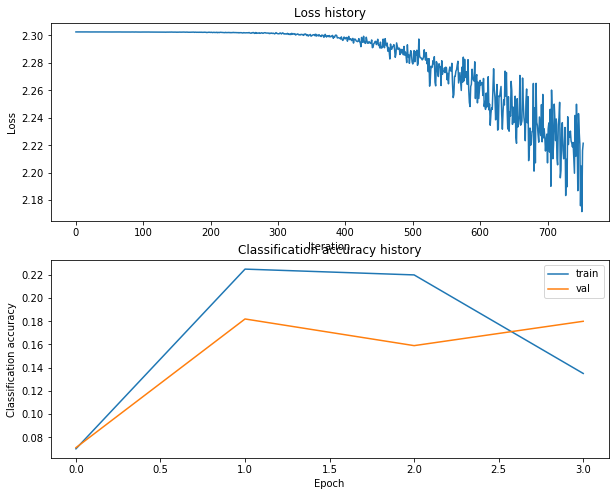

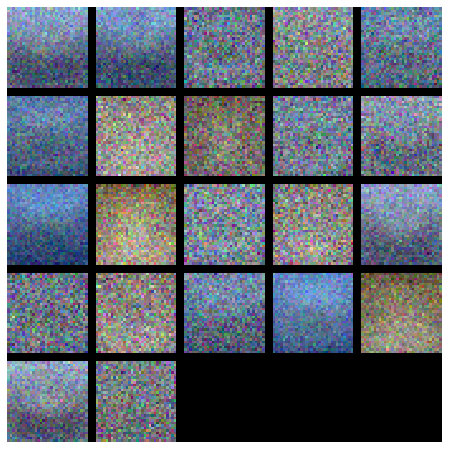










90it [1:22:08, 30.58s/it]

val accuracy: 0.176
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 14, l_r: 4.4966511117472655e-05, train_itrs: 10343, reg: 0.004158064634085141, l_r_decay: 0.8492189387906959
---------------------------------------------------------------------------------------
iteration 0 / 10343: loss 2.302594
iteration 100 / 10343: loss 2.302573
iteration 200 / 10343: loss 2.302530
iteration 300 / 10343: loss 2.302488
iteration 400 / 10343: loss 2.302426
iteration 500 / 10343: loss 2.302062
iteration 600 / 10343: loss 2.301986
iteration 700 / 10343: loss 2.301038
iteration 800 / 10343: loss 2.299563
iteration 900 / 10343: loss 2.297588
iteration 1000 / 10343: loss 2.293324
iteration 1100 / 10343: loss 2.290355
iteration 1200 / 10343: loss 2.279861
iteration 1300 / 10343: loss 2.276016
iteration 1400 / 10343: loss 2.261026
iteration 1500 / 10343: loss 2.254470
iteration 1600

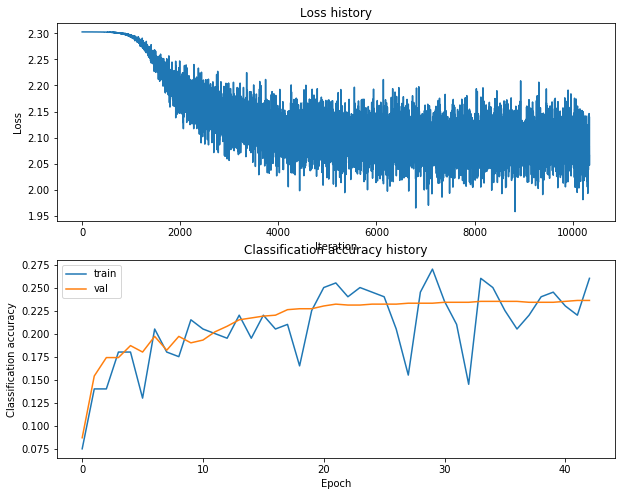

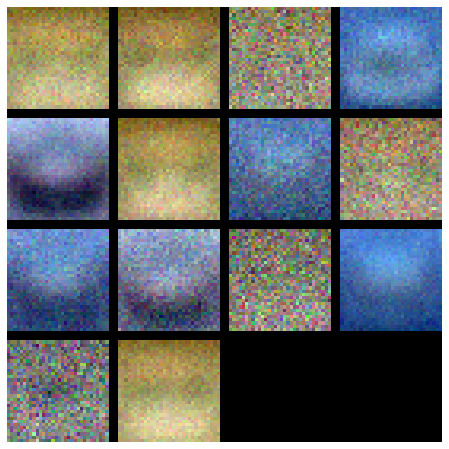










91it [1:22:48, 33.43s/it]

val accuracy: 0.236
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 43, l_r: 3.432374759299452e-05, train_itrs: 10830, reg: 0.05894313758131782, l_r_decay: 0.8454393947552934
---------------------------------------------------------------------------------------
iteration 0 / 10830: loss 2.302665
iteration 100 / 10830: loss 2.302594
iteration 200 / 10830: loss 2.302537
iteration 300 / 10830: loss 2.302356
iteration 400 / 10830: loss 2.302112
iteration 500 / 10830: loss 2.301703
iteration 600 / 10830: loss 2.300885
iteration 700 / 10830: loss 2.298847
iteration 800 / 10830: loss 2.298259
iteration 900 / 10830: loss 2.294720
iteration 1000 / 10830: loss 2.294964
iteration 1100 / 10830: loss 2.286744
iteration 1200 / 10830: loss 2.275398
iteration 1300 / 10830: loss 2.277062
iteration 1400 / 10830: loss 2.263653
iteration 1500 / 10830: loss 2.282884
iteration 1600 /

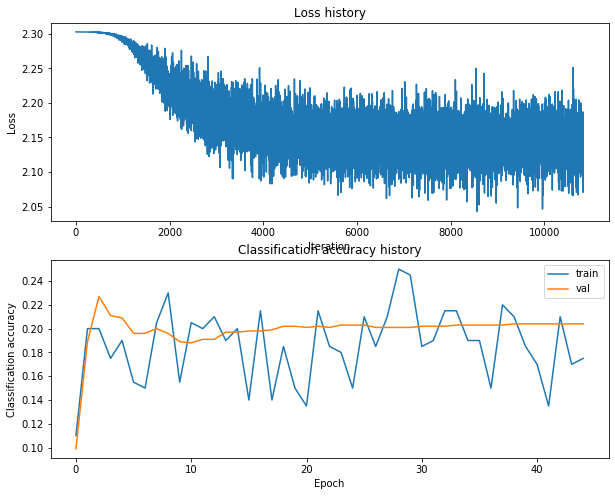

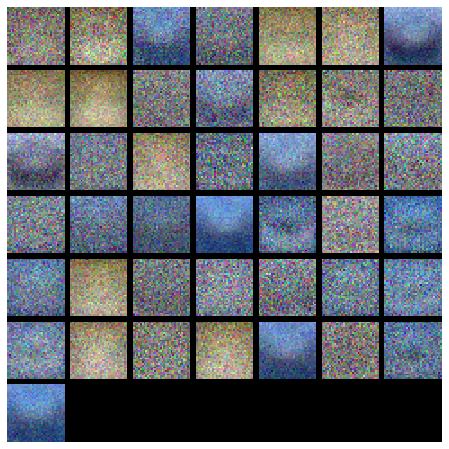










92it [1:24:07, 47.16s/it]

val accuracy: 0.204
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 16, l_r: 0.00015660959035345025, train_itrs: 8923, reg: 0.0275003709675879, l_r_decay: 0.908351789677875
---------------------------------------------------------------------------------------
iteration 0 / 8923: loss 2.302596
iteration 100 / 8923: loss 2.302051
iteration 200 / 8923: loss 2.286262
iteration 300 / 8923: loss 2.210229
iteration 400 / 8923: loss 2.100740
iteration 500 / 8923: loss 2.001083
iteration 600 / 8923: loss 1.980774
iteration 700 / 8923: loss 1.967187
iteration 800 / 8923: loss 1.919406
iteration 900 / 8923: loss 1.965862
iteration 1000 / 8923: loss 1.835856
iteration 1100 / 8923: loss 1.912995
iteration 1200 / 8923: loss 1.770506
iteration 1300 / 8923: loss 1.830033
iteration 1400 / 8923: loss 1.804758
iteration 1500 / 8923: loss 1.831601
iteration 1600 / 8923: loss 1.7515

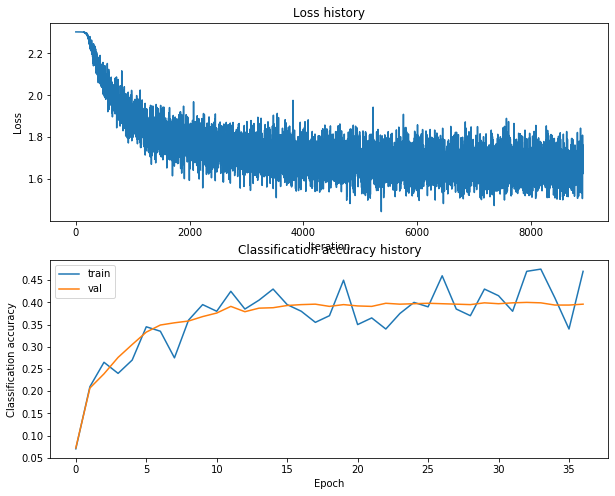

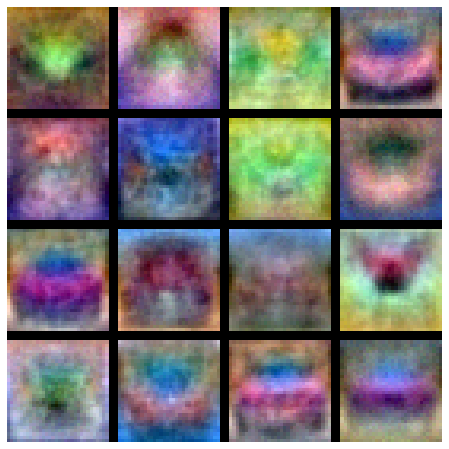










93it [1:24:42, 43.56s/it]

val accuracy: 0.395
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 10, l_r: 0.0006870516843152933, train_itrs: 2797, reg: 0.05091858955359571, l_r_decay: 0.8258599478191371
---------------------------------------------------------------------------------------
iteration 0 / 2797: loss 2.302592
iteration 100 / 2797: loss 2.150286
iteration 200 / 2797: loss 1.999940
iteration 300 / 2797: loss 1.882142
iteration 400 / 2797: loss 1.926519
iteration 500 / 2797: loss 1.669121
iteration 600 / 2797: loss 1.686547
iteration 700 / 2797: loss 1.614219
iteration 800 / 2797: loss 1.663289
iteration 900 / 2797: loss 1.754196
iteration 1000 / 2797: loss 1.608350
iteration 1100 / 2797: loss 1.746677
iteration 1200 / 2797: loss 1.720310
iteration 1300 / 2797: loss 1.631426
iteration 1400 / 2797: loss 1.637480
iteration 1500 / 2797: loss 1.708648
iteration 1600 / 2797: loss 1.601

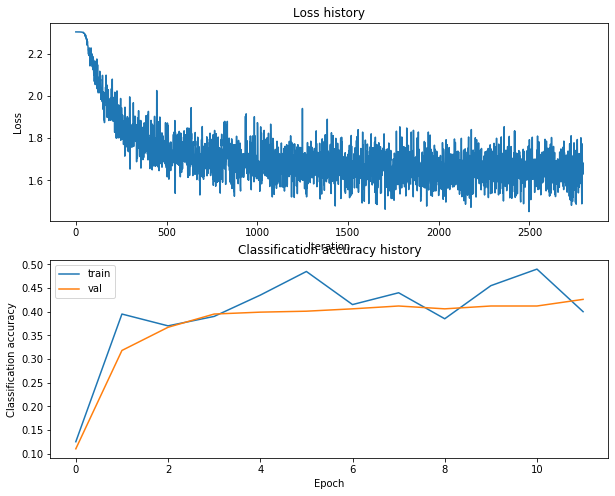

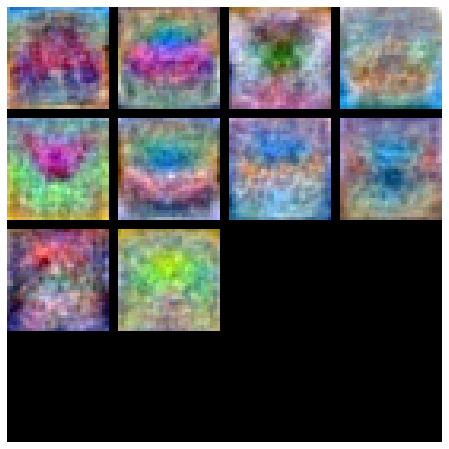










94it [1:24:53, 33.59s/it]

val accuracy: 0.414
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 9, l_r: 0.0001754787642981422, train_itrs: 3950, reg: 0.001236498298091803, l_r_decay: 0.9203238921693545
---------------------------------------------------------------------------------------
iteration 0 / 3950: loss 2.302586
iteration 100 / 3950: loss 2.302469
iteration 200 / 3950: loss 2.296285
iteration 300 / 3950: loss 2.211581
iteration 400 / 3950: loss 2.090103
iteration 500 / 3950: loss 1.996624
iteration 600 / 3950: loss 2.023233
iteration 700 / 3950: loss 1.913290
iteration 800 / 3950: loss 1.899278
iteration 900 / 3950: loss 1.880490
iteration 1000 / 3950: loss 1.869610
iteration 1100 / 3950: loss 1.931796
iteration 1200 / 3950: loss 1.798593
iteration 1300 / 3950: loss 1.788732
iteration 1400 / 3950: loss 1.800581
iteration 1500 / 3950: loss 1.735681
iteration 1600 / 3950: loss 1.810

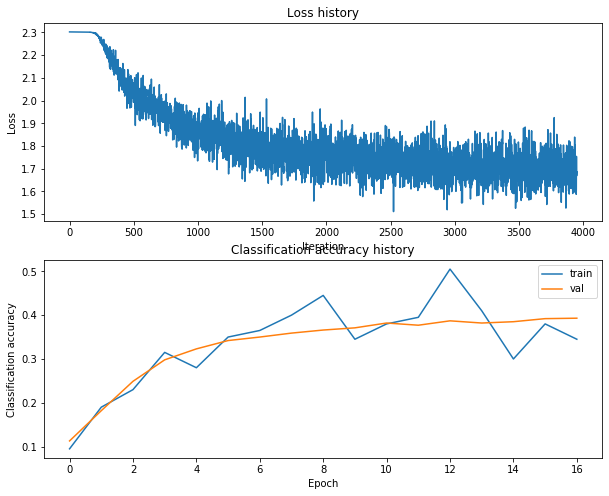

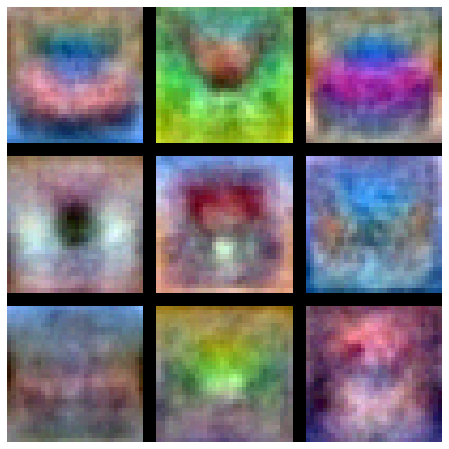










95it [1:25:08, 27.98s/it]

val accuracy: 0.39
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 30, l_r: 2.1506041218656306e-05, train_itrs: 14198, reg: 0.06723259596443651, l_r_decay: 0.921752949549155
---------------------------------------------------------------------------------------
iteration 0 / 14198: loss 2.302650
iteration 100 / 14198: loss 2.302615
iteration 200 / 14198: loss 2.302567
iteration 300 / 14198: loss 2.302539
iteration 400 / 14198: loss 2.302502
iteration 500 / 14198: loss 2.302320
iteration 600 / 14198: loss 2.302266
iteration 700 / 14198: loss 2.302289
iteration 800 / 14198: loss 2.301363
iteration 900 / 14198: loss 2.301120
iteration 1000 / 14198: loss 2.300686
iteration 1100 / 14198: loss 2.299183
iteration 1200 / 14198: loss 2.297331
iteration 1300 / 14198: loss 2.295374
iteration 1400 / 14198: loss 2.295255
iteration 1500 / 14198: loss 2.292237
iteration 1600 / 

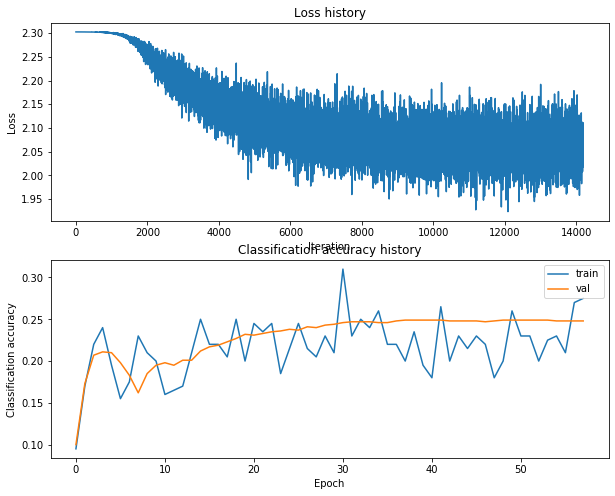

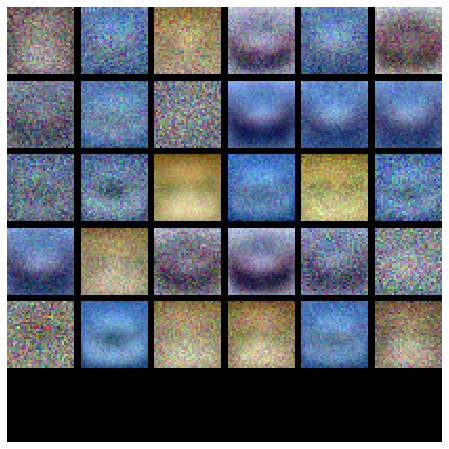










96it [1:26:20, 41.28s/it]

val accuracy: 0.248
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 32, l_r: 4.935095458496273e-05, train_itrs: 31233, reg: 0.03863254459600294, l_r_decay: 0.8118969743091462
---------------------------------------------------------------------------------------
iteration 0 / 31233: loss 2.302631
iteration 100 / 31233: loss 2.302535
iteration 200 / 31233: loss 2.302433
iteration 300 / 31233: loss 2.301845
iteration 400 / 31233: loss 2.299941
iteration 500 / 31233: loss 2.298673
iteration 600 / 31233: loss 2.297455
iteration 700 / 31233: loss 2.281705
iteration 800 / 31233: loss 2.280886
iteration 900 / 31233: loss 2.254660
iteration 1000 / 31233: loss 2.248035
iteration 1100 / 31233: loss 2.246644
iteration 1200 / 31233: loss 2.197471
iteration 1300 / 31233: loss 2.192436
iteration 1400 / 31233: loss 2.214899
iteration 1500 / 31233: loss 2.167334
iteration 1600 /

iteration 20300 / 31233: loss 2.049929
iteration 20400 / 31233: loss 2.088035
iteration 20500 / 31233: loss 2.081632
iteration 20600 / 31233: loss 2.061305
iteration 20700 / 31233: loss 2.056292
iteration 20800 / 31233: loss 2.096055
iteration 20900 / 31233: loss 2.149912
iteration 21000 / 31233: loss 2.092156
iteration 21100 / 31233: loss 2.075307
iteration 21200 / 31233: loss 2.191983
iteration 21300 / 31233: loss 2.146183
iteration 21400 / 31233: loss 2.059072
iteration 21500 / 31233: loss 2.115541
iteration 21600 / 31233: loss 2.129426
iteration 21700 / 31233: loss 2.111967
iteration 21800 / 31233: loss 2.128847
iteration 21900 / 31233: loss 2.138519
iteration 22000 / 31233: loss 2.121047
iteration 22100 / 31233: loss 2.188758
iteration 22200 / 31233: loss 2.111893
iteration 22300 / 31233: loss 2.155933
iteration 22400 / 31233: loss 2.078785
iteration 22500 / 31233: loss 2.139150
iteration 22600 / 31233: loss 2.085966
iteration 22700 / 31233: loss 2.174111
iteration 22800 / 31233: 

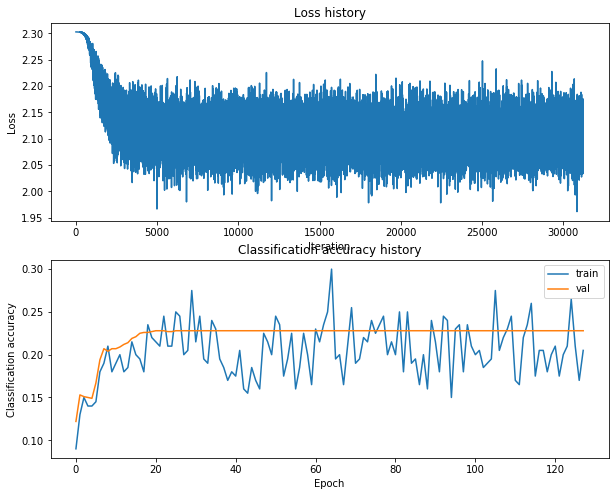

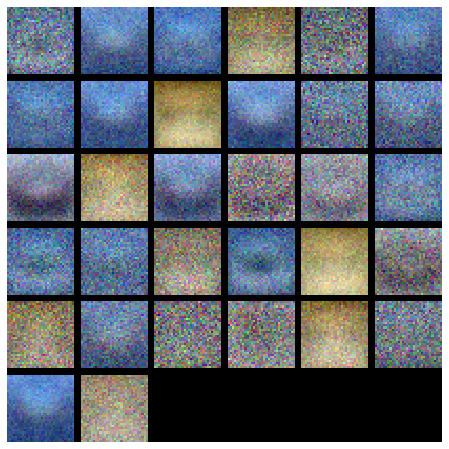










97it [1:29:07, 78.98s/it]

val accuracy: 0.228
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 9, l_r: 1.30517430655656e-05, train_itrs: 1232, reg: 0.003507573926774357, l_r_decay: 0.8789371066566373
---------------------------------------------------------------------------------------
iteration 0 / 1232: loss 2.302593
iteration 100 / 1232: loss 2.302579
iteration 200 / 1232: loss 2.302578
iteration 300 / 1232: loss 2.302569
iteration 400 / 1232: loss 2.302557
iteration 500 / 1232: loss 2.302547
iteration 600 / 1232: loss 2.302549
iteration 700 / 1232: loss 2.302545
iteration 800 / 1232: loss 2.302494
iteration 900 / 1232: loss 2.302526
iteration 1000 / 1232: loss 2.302479
iteration 1100 / 1232: loss 2.302470
iteration 1200 / 1232: loss 2.302431


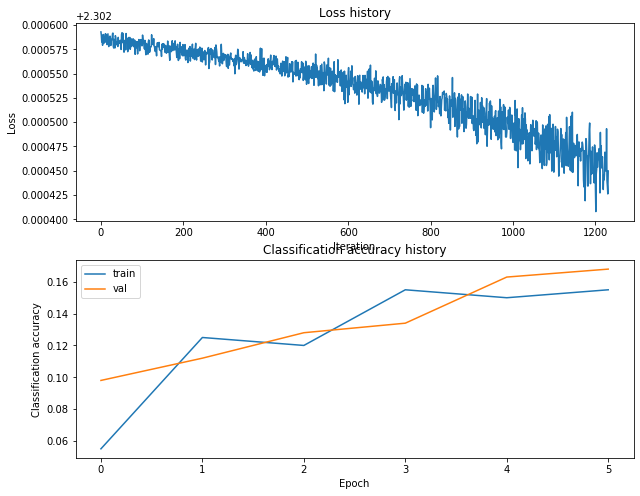

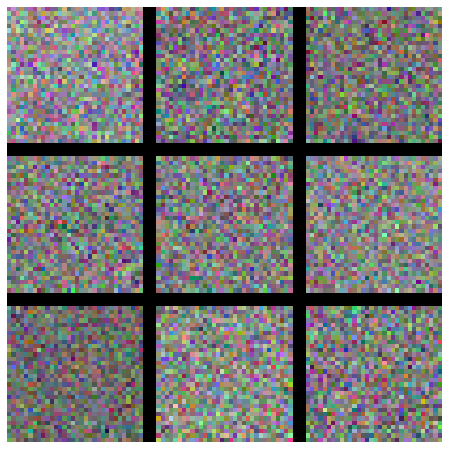










98it [1:29:12, 56.77s/it]

val accuracy: 0.168
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 22, l_r: 5.492444755202484e-05, train_itrs: 1018, reg: 0.07649463583916088, l_r_decay: 0.8685622640094169
---------------------------------------------------------------------------------------
iteration 0 / 1018: loss 2.302655
iteration 100 / 1018: loss 2.302596
iteration 200 / 1018: loss 2.302526
iteration 300 / 1018: loss 2.302231
iteration 400 / 1018: loss 2.301595
iteration 500 / 1018: loss 2.299565
iteration 600 / 1018: loss 2.296448
iteration 700 / 1018: loss 2.283797
iteration 800 / 1018: loss 2.261637
iteration 900 / 1018: loss 2.252500
iteration 1000 / 1018: loss 2.202249


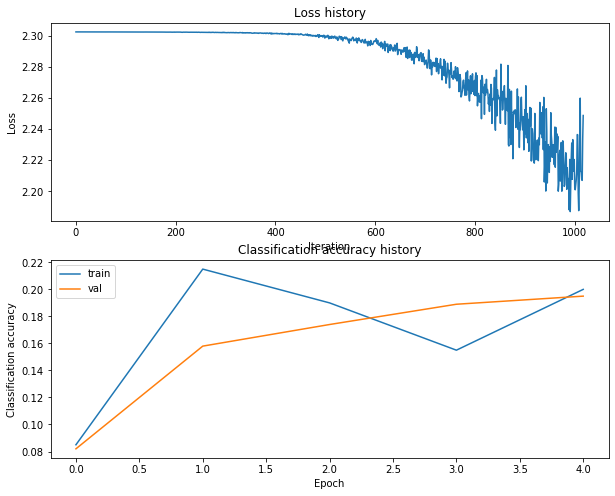

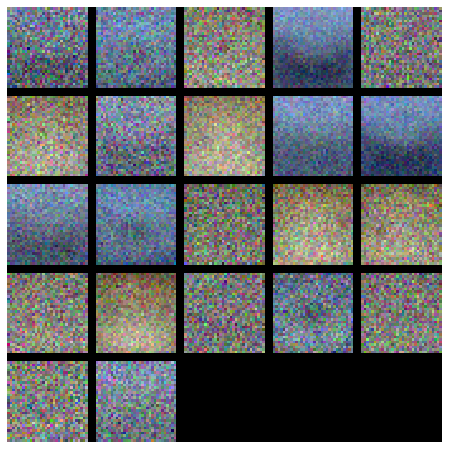










99it [1:29:17, 41.24s/it]

val accuracy: 0.199
--------------------------------------------------------------------------------------------------------
Processing new experiment:
---------------------------
hidden_size: 13, l_r: 0.00028678704730865443, train_itrs: 852, reg: 0.0401397412757459, l_r_decay: 0.9297996792728559
---------------------------------------------------------------------------------------
iteration 0 / 852: loss 2.302595
iteration 100 / 852: loss 2.298593
iteration 200 / 852: loss 2.153029
iteration 300 / 852: loss 2.101566
iteration 400 / 852: loss 2.000126
iteration 500 / 852: loss 1.959703
iteration 600 / 852: loss 1.828460
iteration 700 / 852: loss 1.911433
iteration 800 / 852: loss 1.799400


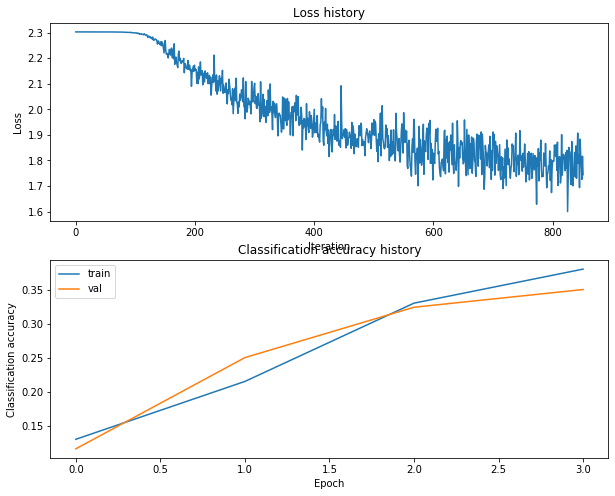

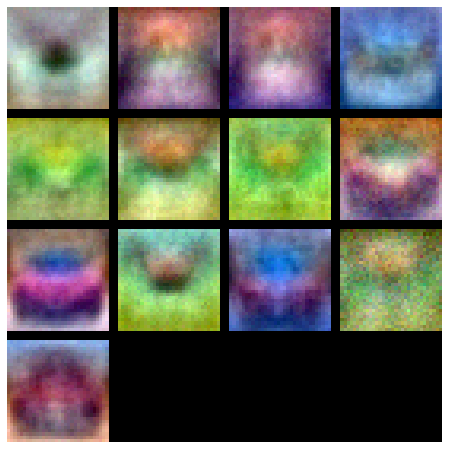










100it [1:29:20, 53.61s/it]

val accuracy: 0.358
--------------------------------------------------------------------------------------------------------
best parameters was: hidden_size: 57, l_r: 0.00041667558973261217, train_itrs: 27485, reg: 0.02580555826518483, l_r_decay: 0.9723054695482463
best val_accuracy was: 0.52


In [45]:
best_net = None # store the best model into this 

#################################################################################
# TODO: Tune hyperparameters using the validation set. Store your best trained  #
# model in best_net.                                                            #
#                                                                               #
# To help debug your network, it may help to use visualizations similar to the  #
# ones we used above; these visualizations will have significant qualitative    #
# differences from the ones we saw above for the poorly tuned network.          #
#                                                                               #
# Tweaking hyperparameters by hand can be fun, but you might find it useful to  #
# write code to sweep through possible combinations of hyperparameters          #
# automatically like we did on the previous exercises.                          #
#################################################################################
# *****START OF YOUR CODE (DO NOT DELETE/MODIFY THIS LINE)*****

from tqdm import tqdm

def get_random_numbers_within_range(low, high, size):
    return 10 ** np.random.uniform(low=np.log10(low), high=np.log10(high), size=size)

def show_train_history(stats):
    # Plot the loss function and train / validation accuracies
    plt.subplot(2, 1, 1)
    plt.plot(stats['loss_history'])
    plt.title('Loss history')
    plt.xlabel('Iteration')
    plt.ylabel('Loss')

    plt.subplot(2, 1, 2)
    plt.plot(stats['train_acc_history'], label='train')
    plt.plot(stats['val_acc_history'], label='val')
    plt.title('Classification accuracy history')
    plt.xlabel('Epoch')
    plt.ylabel('Classification accuracy')
    plt.legend()
    plt.show()
    
def measure_network_fitness(hidden_size, l_r, train_itrs, reg, l_r_decay):
    input_size = 32 * 32 * 3
    num_classes = 10
    net = TwoLayerNet(input_size, hidden_size, num_classes)
    # Train the network
    stats = net.train(X_train, y_train, X_val, y_val,
                num_iters=train_itrs, batch_size=200,
                learning_rate=l_r, learning_rate_decay=l_r_decay,
                reg=reg, verbose=True)
    # Predict on the validation set
    val_acc = (net.predict(X_val) == y_val).mean()
    #print('Validation accuracy: ', val_acc)
    show_train_history(stats)
    show_net_weights(net)
    return val_acc, net

best_combination = None
best_val_accuracy = -1

combination_sizes = 100

hidden_layer_sizes = (get_random_numbers_within_range(5, 100, combination_sizes)).astype(int)
learning_rates = get_random_numbers_within_range(1e-3, 1e-5, combination_sizes)
train_itr_numbers = (get_random_numbers_within_range(500, 50000, combination_sizes)).astype(int)
reg_strengths = get_random_numbers_within_range(1e-1, 1e-3, combination_sizes)
learning_rate_decays = get_random_numbers_within_range(0.99, 0.8, combination_sizes)
parameters_lists = [hidden_layer_sizes, learning_rates, train_itr_numbers, reg_strengths, learning_rate_decays]


for combination in tqdm(zip(*parameters_lists)):
    hidden_size, l_r, train_itrs, reg, l_r_decay = combination
    print('Processing new experiment:')
    print('---------------------------')
    print('hidden_size: {}, l_r: {}, train_itrs: {}, reg: {}, l_r_decay: {}'.format(*combination))
    print('---------------------------------------------------------------------------------------')
    val_accuracy, net = measure_network_fitness(hidden_size, l_r, train_itrs, reg, l_r_decay)
    print('val accuracy: {}'.format(val_accuracy))
    if val_accuracy > best_val_accuracy:
        best_val_accuracy = val_accuracy
        best_combination = combination
        best_net = net
        print('Found better model with val acuracy: {}, with combination: {}'.format(val_accuracy, combination))
    print('--------------------------------------------------------------------------------------------------------')
pass
print('best parameters was: hidden_size: {}, l_r: {}, train_itrs: {}, reg: {}, l_r_decay: {}'.format(*best_combination))
print('best val_accuracy was: {}'.format(best_val_accuracy))
# *****END OF YOUR CODE (DO NOT DELETE/MODIFY THIS LINE)*****


the best networks weights: 


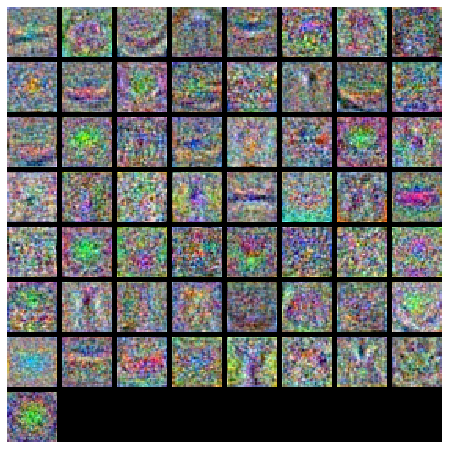

In [46]:
# visualize the weights of the best network
print('the best networks weights: ')
show_net_weights(best_net)

# Run on the test set
When you are done experimenting, you should evaluate your final trained network on the test set; you should get above 48%.

In [47]:
test_acc = (best_net.predict(X_test) == y_test).mean()
print('Test accuracy: ', test_acc)

Test accuracy:  0.517


**Inline Question**

Now that you have trained a Neural Network classifier, you may find that your testing accuracy is much lower than the training accuracy. In what ways can we decrease this gap? Select all that apply.

1. Train on a larger dataset.
2. Add more hidden units.
3. Increase the regularization strength.
4. None of the above.

$\color{blue}{\textit Your\ Answer:\ Increase\ the\ Regularization\ strength,\ Train\ on\ a\ larger\ dataset}$

$\color{blue}{\textit Your\ Explanation:\ Increasing\ the\ Regularization\ strength\ will\ decrease\ the\ overfitting\ and\ also\ training\ on\ a\ larger\ dataset\ will\ give\ the\ model\ more\ data\ to\ fit\ and\ this\ will\ also\ decrease\ the\ overfitting,\ it\ is\ like\ transfer\ learning}$

